In [1]:
from paths import models_folder, metadata_folder

In [2]:
from pyobsbox import ObsBoxGenerator

In [3]:
import logging
import keras
import json
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from tqdm.auto import tqdm

In [4]:
logging.getLogger("pyobsbox").setLevel(logging.INFO)

# List models

In [5]:
list(models_folder.glob('model_*'))

[PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_B1H_Inst_20756'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_B1H_Inst_1024'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_B1H_Inst_1'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_B1H_Inst_20608'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_time_dist_32_16_B1H_Inst_500'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_conv_64_8_B1H_Inst_252'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_conv_64_16_8_stride_4_B1H_Inst_253'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_conv_32_16_stride_4_B1H_Inst')]

In [6]:
model_path = models_folder / "model_conv_32_16_stride_4_B1H_Inst"

# Load model and associated generators

In [7]:
model = keras.models.load_model(model_path)
model.summary()
model_metadata = json.load((model_path / "metadata.json").open('r'))
data_metadata_path = model_metadata["generator"]["metadata_path"]

# load the data metadata
data_metadata_df = pd.read_hdf(data_metadata_path)

# load the indices of the data seen by the model
train_seen_indices = np.load(model_path / "train_seen_indices.npy")
validation_seen_indices = np.load(model_path / "validation_seen_indices.npy")

# train/validation split
# train_split_indices = np.load(model_path / "train_split_indices.npy")
# validation_split_indices = np.load(model_path / "validation_split_indices.npy")

# load the data seen by the model
train_metadata = data_metadata_df.iloc[train_seen_indices]
validation_metadata = data_metadata_df.iloc[validation_seen_indices]

# the training loss history
hist = model_metadata["history"]

# remove shuffling
model_metadata["generator"]["shuffle"] = True  # True because I don't have the seen values indices
# create the generators
train_generator = ObsBoxGenerator(train_metadata,
                                  **model_metadata["generator"])
validation_generator = ObsBoxGenerator(validation_metadata,
                                       **model_metadata["generator"])

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d (Conv1D)              (None, 512, 32)           256       
_________________________________________________________________
dropout (Dropout)            (None, 512, 32)           0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 128, 16)           3600      
_________________________________________________________________
conv1d_transpose (Conv1DTran (None, 512, 16)           1808      
_________________________________________________________________
dropout_1 (Dropout)          (None, 512, 16)           0         
_________________________________________________________________
conv1d_transpose_1 (Conv1DTr (None, 2048, 32)          3616      
_________________________________________________________________
conv1d_transpose_2 (Conv1DTr (None, 2048, 1)           2

Dec/12 15:54:45 pyobsbox.generator INFO: metadata_path: /afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/metadata/metadata_B1H_Inst_34994.h5
Dec/12 15:54:45 pyobsbox.generator INFO: shuffle: True
Dec/12 15:54:45 pyobsbox.generator INFO: batch_size: 8192
Dec/12 15:54:45 pyobsbox.generator INFO: sequence_length: 2048
Dec/12 15:54:45 pyobsbox.generator INFO: n_bunches: 256
Dec/12 15:54:45 pyobsbox.generator INFO: __len__: 1034
Dec/12 15:54:45 pyobsbox.generator INFO: fetched_log_folder: None
Dec/12 15:54:45 pyobsbox.generator INFO: fetched_log_prefix: 
Dec/12 15:54:45 pyobsbox.generator INFO: metadata_path: /afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/metadata/metadata_B1H_Inst_34994.h5
Dec/12 15:54:45 pyobsbox.generator INFO: shuffle: True
Dec/12 15:54:45 pyobsbox.generator INFO: batch_size: 8192
Dec/12 15:54:45 pyobsbox.generator INFO: sequence_length: 2048
Dec/12 15:54:45 pyobsbox.generator INFO: n_bunches: 256
Dec/12 15:54:45 pyobsbox.generator INFO: __len__: 15
Dec/12 15:54:45 

In [8]:
print(train_metadata.shape)
train_metadata.head()

(264704, 11)


,type,fill,beam,plane,q,date_time,file,n_bunches,bunch_index,bunch_number,ts_length
7719355,Inst,7466,1,h,7,2018-11-22 22:55:15,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7466/...,670,3379.0,653.0,65536
3334195,Inst,6617,1,h,7,2018-04-28 00:07:14,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6617/...,987,591.0,243.0,65536
11592060,Inst,7264,1,h,7,2018-10-07 00:52:21,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7264/...,780,400.0,268.0,65536
6255097,Inst,7230,1,h,7,2018-09-28 09:15:14,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7230/...,36,1.0,1.0,65536
7242133,Inst,6988,1,h,7,2018-07-27 04:46:15,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6988/...,300,331.0,134.0,65536


In [9]:
print(validation_metadata.shape)
validation_metadata.head()

(3840, 11)


,type,fill,beam,plane,q,date_time,file,n_bunches,bunch_index,bunch_number,ts_length
4434793,Inst,7468,1,h,7,2018-11-23 19:42:38,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/...,418,1585.0,335.0,65536
788491,Inst,6788,1,h,7,2018-06-13 22:13:14,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6788/...,876,1092.0,469.0,65536
9132235,Inst,7043,1,h,7,2018-08-11 07:46:14,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7043/...,396,540.0,394.0,65536
9475166,Inst,7067,1,h,7,2018-08-20 00:13:16,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7067/...,24,10.0,10.0,65536
7365960,Inst,6624,1,h,7,2018-04-30 02:52:14,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6624/...,1227,1050.0,321.0,65536


# Loss functions

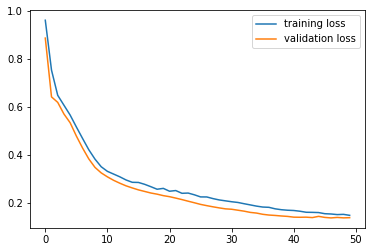

In [10]:
plt.plot(hist['loss'], label='training loss')
plt.plot(hist['val_loss'], label='validation loss')
plt.legend()

# Datasets

Load the first few batches

In [11]:
train_dataset = np.vstack([train_generator[i][0] for i in tqdm(range(50))])
train_dataset.shape

(409600, 2048, 1)

In [12]:
validation_dataset = np.vstack([validation_generator[i][0] for i in tqdm(range(5))])
validation_dataset.shape

(40960, 2048, 1)

# Predictions

In [13]:
train_pred = model.predict(train_dataset, verbose=1, batch_size=train_generator.batch_size)
train_pred.shape

50/50 [==============================] - 29s 590ms/step


(409600, 2048, 1)

In [14]:
validation_pred = model.predict(validation_dataset, verbose=1, batch_size=validation_generator.batch_size)
validation_pred.shape

5/5 [==============================] - 2s 490ms/step


(40960, 2048, 1)

In [15]:
MAE_train = abs(train_pred - train_dataset).mean(axis=1).squeeze()
MAE_train.shape

(409600,)

In [16]:
MAE_validation = abs(validation_pred - validation_dataset).mean(axis=1).squeeze()
MAE_validation.shape

(40960,)

Text(0.5, 1.0, 'train dataset')

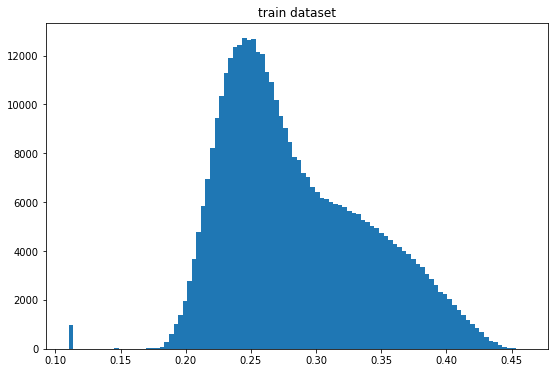

In [17]:
plt.figure(figsize=(9, 6))
n, bins, _ = plt.hist(MAE_train, bins=100)
plt.title("train dataset")
# plt.yscale('log')

rough peak

In [18]:
hist_peak_train = bins[n.argmax()]
hist_peak_train

0.24312209292261225

Text(0.5, 1.0, 'validation dataset')

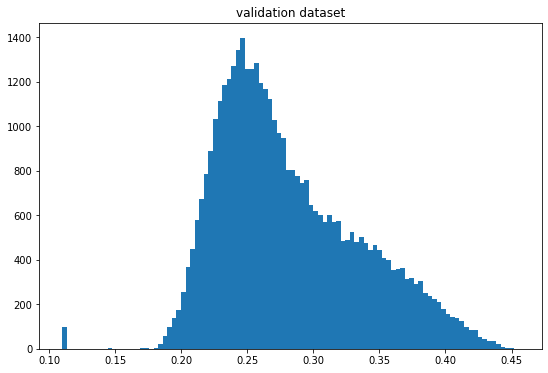

In [19]:
plt.figure(figsize=(9, 6))
n, bins, _ = plt.hist(MAE_validation, bins=100)
plt.title("validation dataset")

In [20]:
hist_peak_validation = bins[n.argmax()]
hist_peak_validation

0.24475204343922297

In [21]:
max_MAE_indices = np.argsort(MAE_train)[::-1]

In [22]:
max_MAE_indices

array([142444,  52925, 260605, ..., 281137, 206068, 237124])

In [23]:
def plot_true_pred(true_signal, pred_signal):
    fig, axes = plt.subplots(2, figsize=(16, 6))
    axes[0].plot(true_signal)
    axes[0].plot(pred_signal)

    axes[1].plot(np.abs(np.diff(true_signal)))
    axes[1].plot(np.abs(np.diff(pred_signal)))
    return fig, axes

index:  142444
MAE:  0.4602905638094167
n_bunches       169
bunch_index     113
bunch_number     27
Name: 345688, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6595/instability_data/06595_Inst_B1H_Q7_20180422_21h03m14s.h5


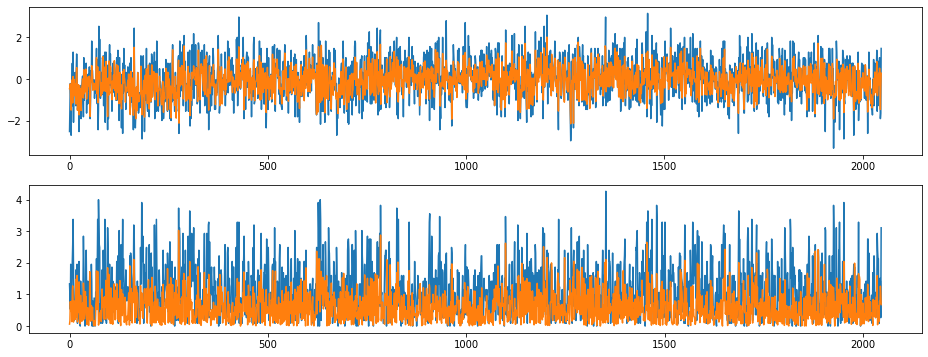

In [24]:
anomalous = 0
anomalous_index = max_MAE_indices[anomalous]

print('index: ', anomalous_index)
print("MAE: ", MAE_train[anomalous_index])
# I'm not sure this row is correct
metadata_row = train_generator.metadata.iloc[anomalous_index // 32]
print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
print(metadata_row['file'])

true_signal = train_dataset[anomalous_index].squeeze()
pred_signal = train_pred[anomalous_index].squeeze()

plot_true_pred(true_signal, pred_signal);

# Top rightmost signals

index:  142444
MAE:  0.4602905638094167
n_bunches       169
bunch_index     113
bunch_number     27
Name: 345688, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6595/instability_data/06595_Inst_B1H_Q7_20180422_21h03m14s.h5


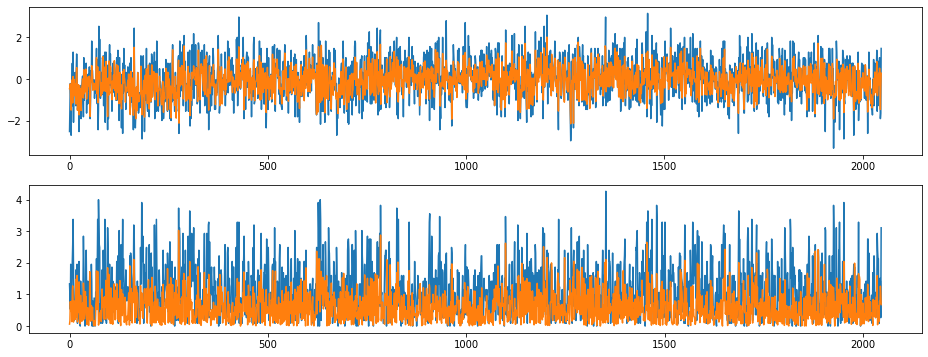

index:  52925
MAE:  0.45662129731779577
n_bunches       2555
bunch_index     1594
bunch_number    1181
Name: 5628325, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7137/instability_data/07137_Inst_B1H_Q7_20180908_15h13m41s.h5


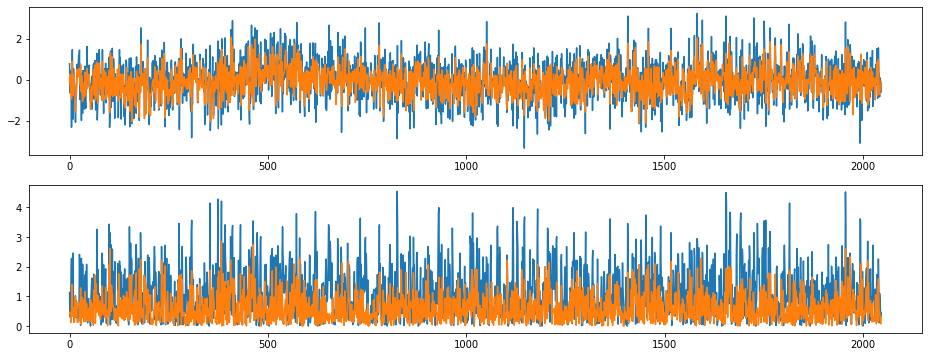

index:  260605
MAE:  0.4560216080919848
n_bunches       648
bunch_index     673
bunch_number    123
Name: 906076, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7483/instability_data/07483_Inst_B1H_Q7_20181129_10h37m14s.h5


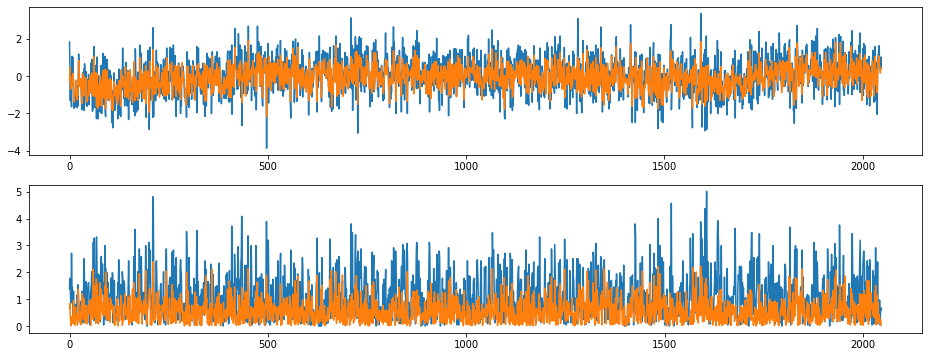

index:  89988
MAE:  0.4553850005220556
n_bunches       1868
bunch_index     2909
bunch_number    1561
Name: 5613017, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6283/instability_data/06283_Inst_B1H_Q7_20171008_04h34m14s.h5


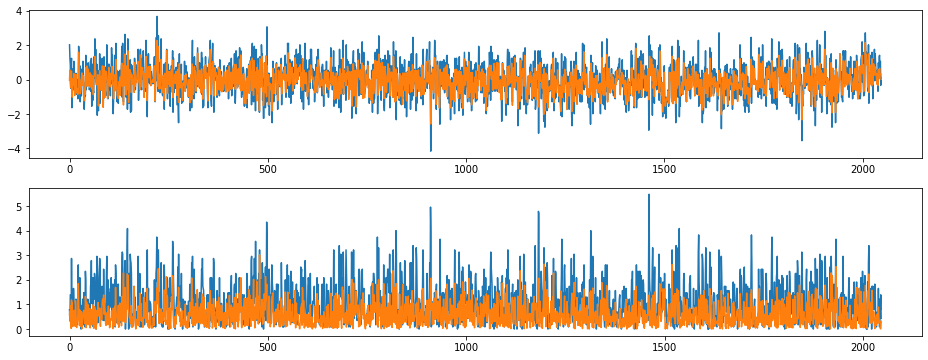

index:  191374
MAE:  0.4553756321468775
n_bunches       2556
bunch_index     1509
bunch_number    1091
Name: 2337665, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6696/instability_data/06696_Inst_B1H_Q7_20180518_10h05m14s.h5


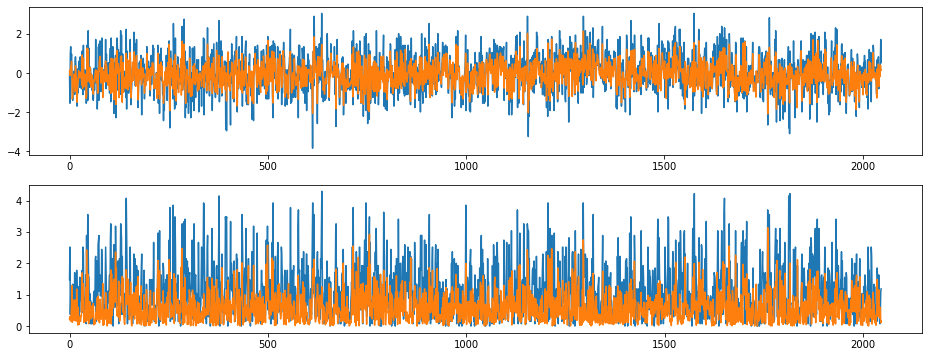

index:  348885
MAE:  0.4534888070102485
n_bunches       1868
bunch_index     2418
bunch_number    1303
Name: 293394, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6349/instability_data/06349_Inst_B1H_Q7_20171031_07h50m14s.h5


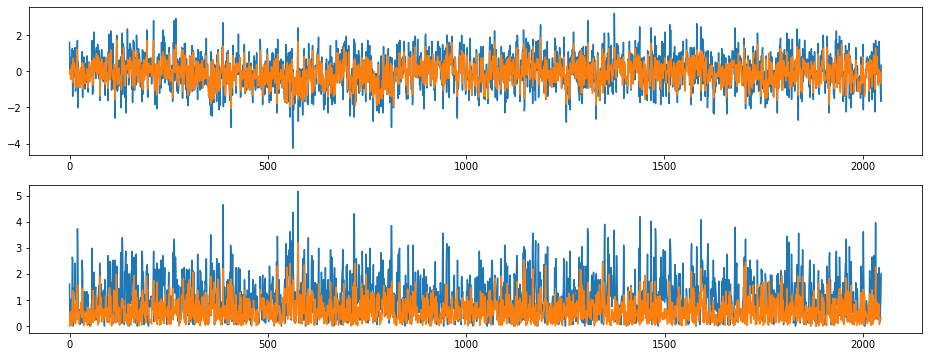

index:  352341
MAE:  0.45285235722590844
n_bunches        900
bunch_index     1038
bunch_number     402
Name: 8889163, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6587/instability_data/06587_Inst_B1H_Q7_20180421_14h59m50s.h5


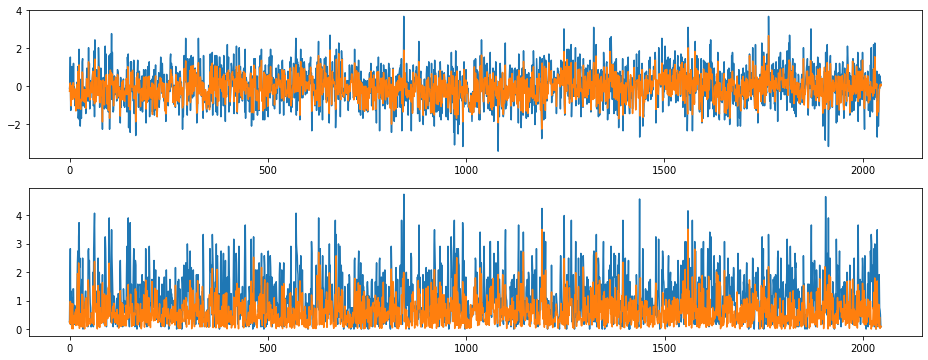

index:  141218
MAE:  0.45184469709118336
n_bunches       173
bunch_index     506
bunch_number    124
Name: 8940689, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6404/instability_data/06404_Inst_B1H_Q7_20171121_16h59m15s.h5


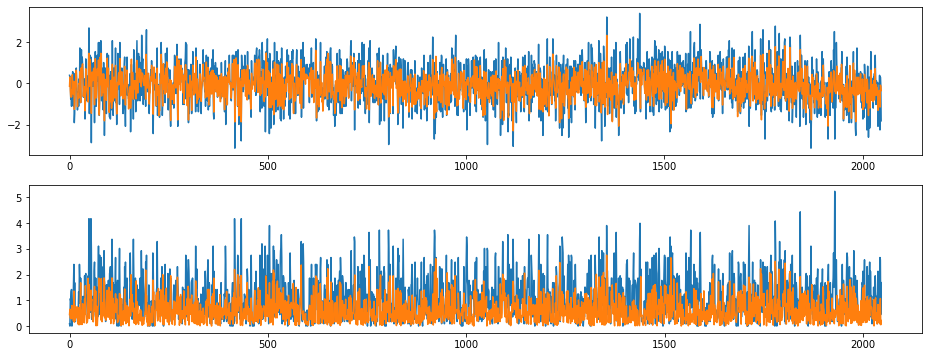

index:  372439
MAE:  0.45172063249903927
n_bunches       1868
bunch_index     1337
bunch_number     721
Name: 10608162, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6364/instability_data/06364_Inst_B1H_Q7_20171107_03h00m14s.h5


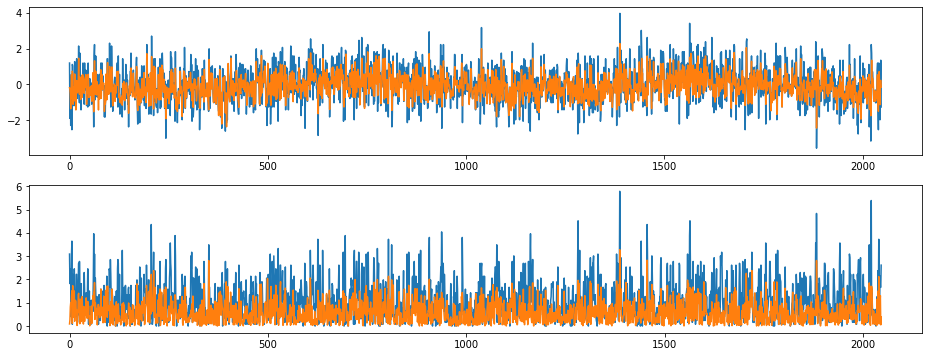

index:  177240
MAE:  0.45166963192357557
n_bunches       1358
bunch_index     2300
bunch_number     902
Name: 7166797, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_09h37m15s.h5


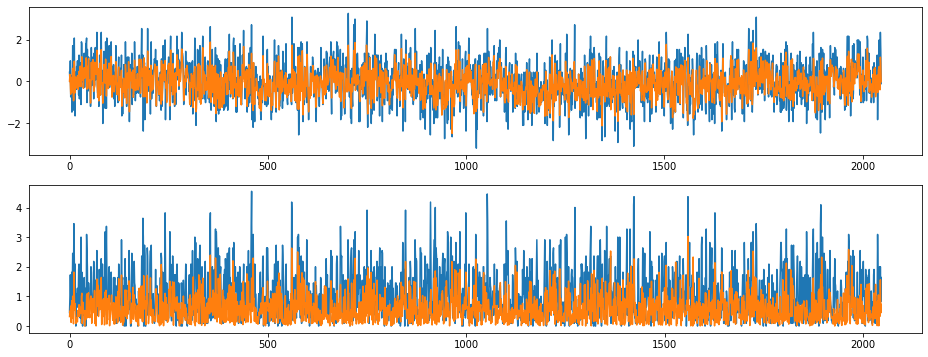

index:  225548
MAE:  0.4515164356284812
n_bunches       1468
bunch_index      200
bunch_number      95
Name: 3781634, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6184/instability_data/06184_Inst_B1H_Q7_20170909_23h57m13s.h5


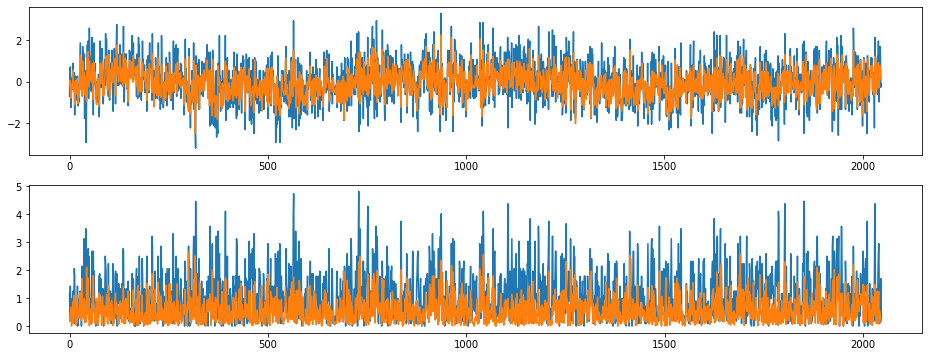

index:  87531
MAE:  0.4514047675822582
n_bunches       1836
bunch_index     2463
bunch_number    1315
Name: 8898579, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_08h11m14s.h5


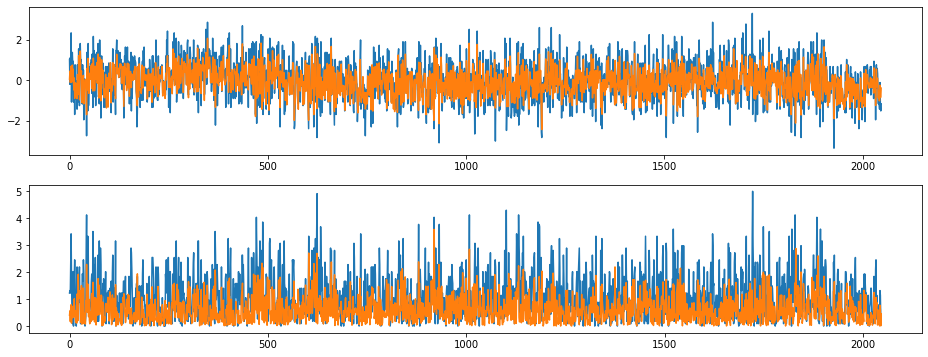

index:  156106
MAE:  0.4513223256619563
n_bunches        733
bunch_index     1745
bunch_number     367
Name: 11216318, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7482/instability_data/07482_Inst_B1H_Q7_20181128_22h52m30s.h5


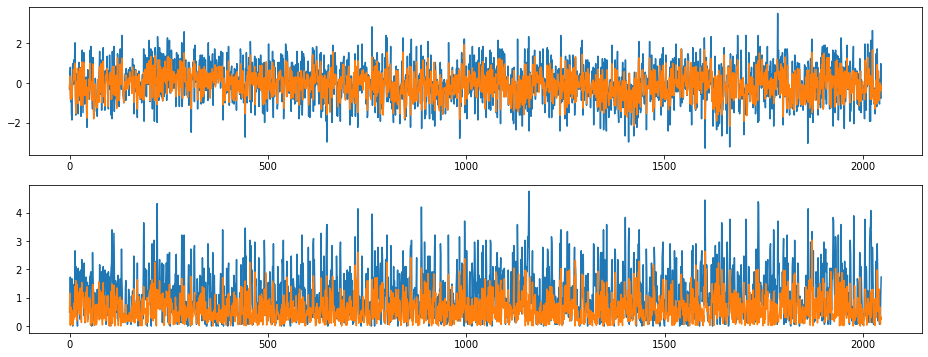

index:  57499
MAE:  0.4511400422229547
n_bunches       1868
bunch_index      199
bunch_number      96
Name: 8156177, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6364/instability_data/06364_Inst_B1H_Q7_20171107_00h25m15s.h5


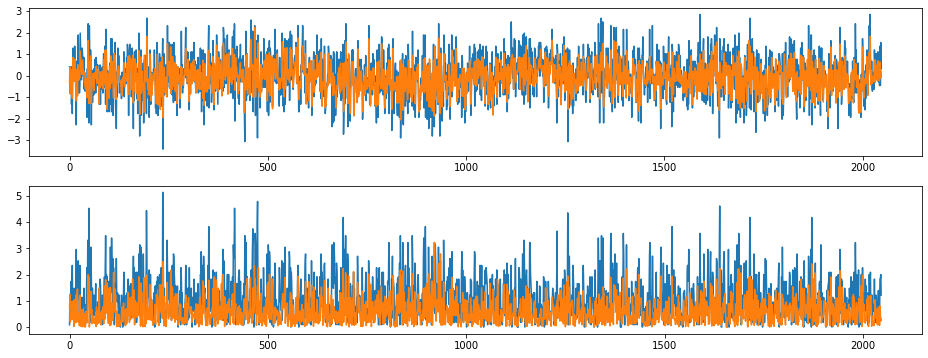

index:  356012
MAE:  0.4509789438815267
n_bunches       2556
bunch_index     2733
bunch_number    2006
Name: 5750817, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6696/instability_data/06696_Inst_B1H_Q7_20180518_10h48m14s.h5


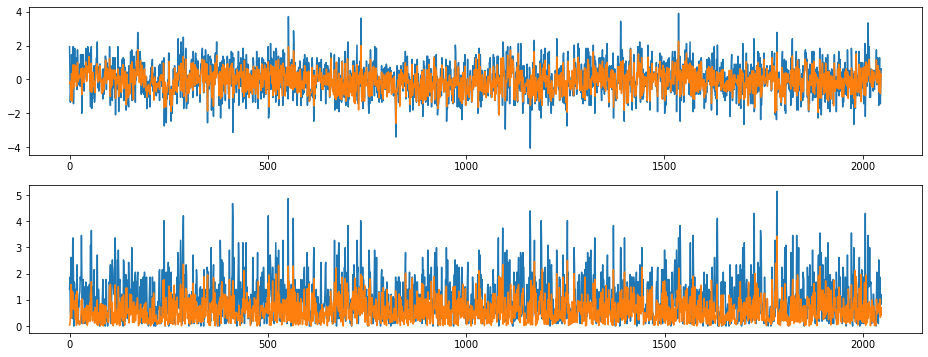

index:  111828
MAE:  0.4508694975204285
n_bunches         88
bunch_index     1946
bunch_number      85
Name: 3089820, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7299/instability_data/07299_Inst_B1H_Q7_20181014_02h22m13s.h5


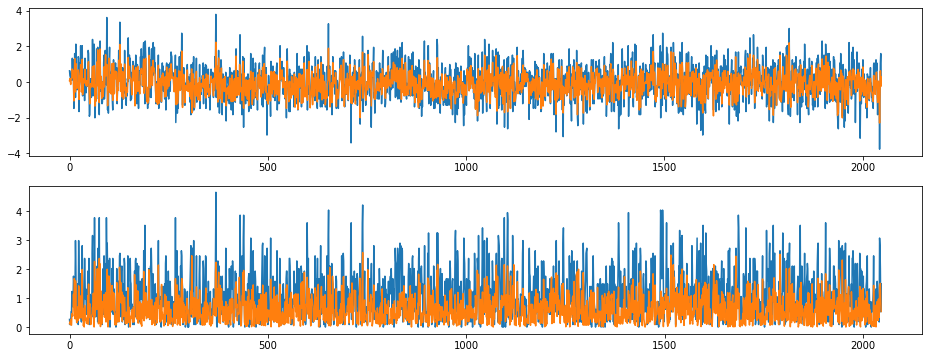

index:  101882
MAE:  0.45082148524109833
n_bunches       540
bunch_index     718
bunch_number    517
Name: 5948861, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6900/instability_data/06900_Inst_B1H_Q7_20180708_01h57m06s.h5


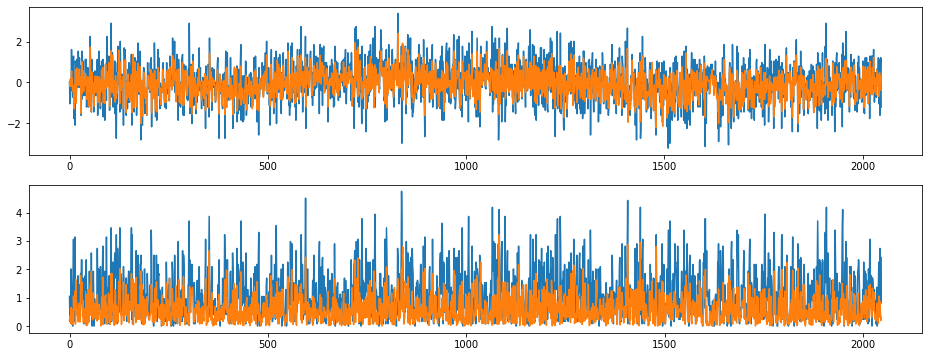

index:  2014
MAE:  0.4506329721896679
n_bunches       924
bunch_index     254
bunch_number    160
Name: 692594, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7314/instability_data/07314_Inst_B1H_Q7_20181017_23h24m42s.h5


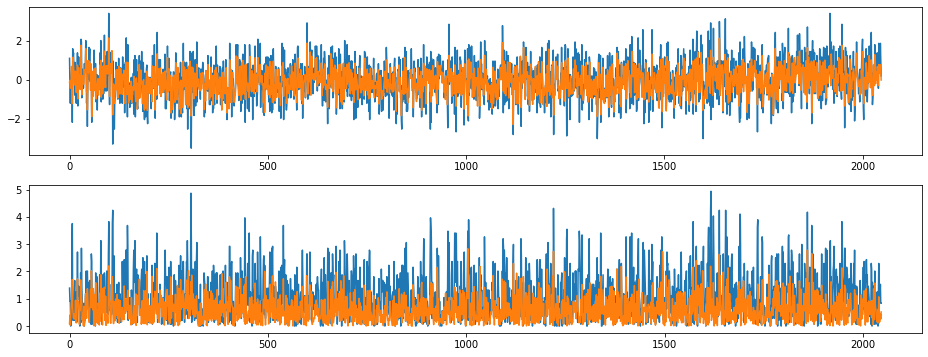

index:  197540
MAE:  0.45020369357350665
n_bunches        924
bunch_index     1196
bunch_number     861
Name: 9312478, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6683/instability_data/06683_Inst_B1H_Q7_20180515_01h16m30s.h5


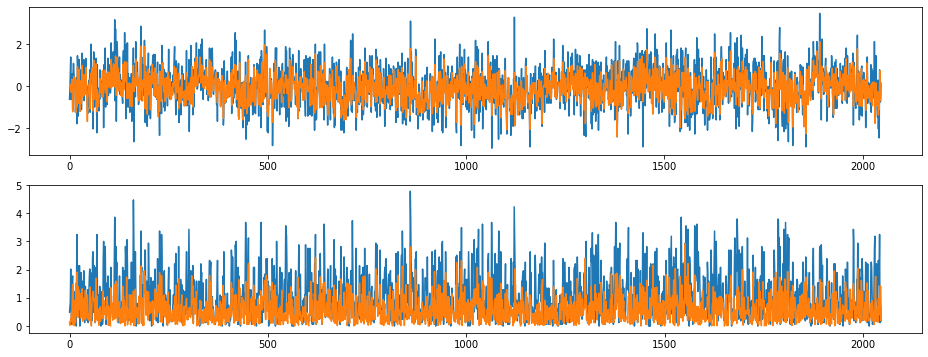

index:  152043
MAE:  0.45017130575674236
n_bunches       924
bunch_index     865
bunch_number    632
Name: 9210934, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7080/instability_data/07080_Inst_B1H_Q7_20180823_22h07m14s.h5


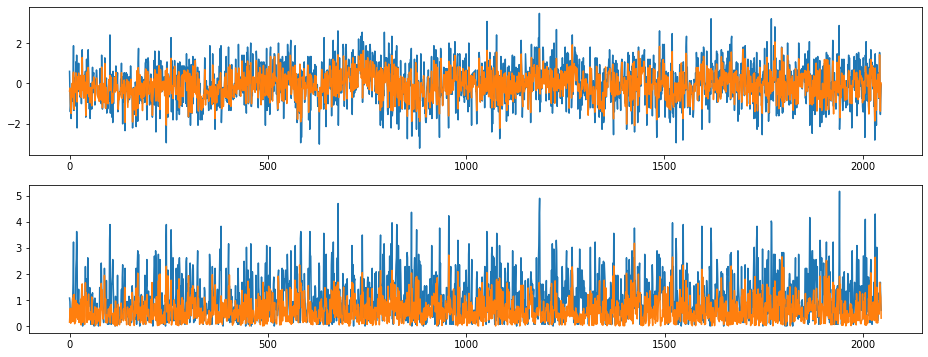

index:  86487
MAE:  0.4497686287507252
n_bunches       924
bunch_index     961
bunch_number    690
Name: 9232214, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7061/instability_data/07061_Inst_B1H_Q7_20180817_22h12m42s.h5


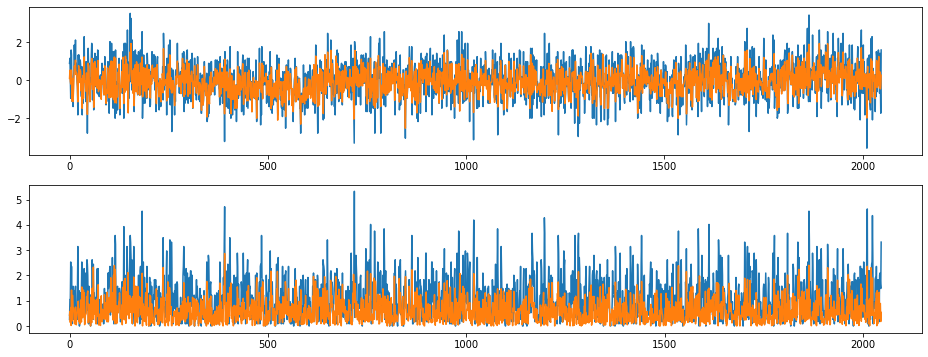

index:  57365
MAE:  0.44972420293877513
n_bunches       780
bunch_index     495
bunch_number    349
Name: 10690579, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7015/instability_data/07015_Inst_B1H_Q7_20180803_06h20m19s.h5


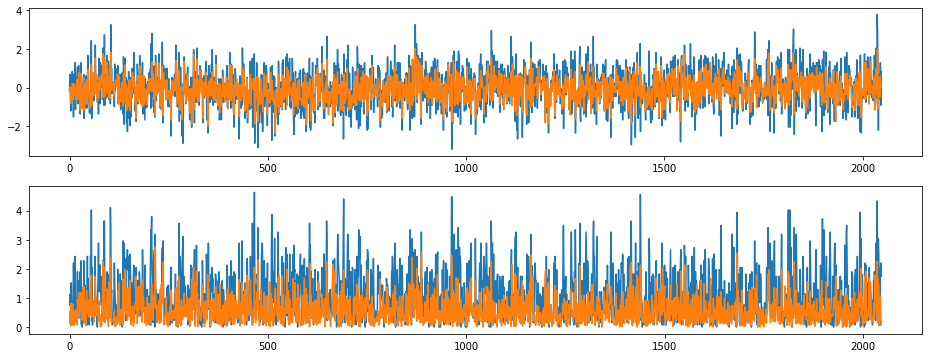

index:  127715
MAE:  0.44965290318202944
n_bunches       1916
bunch_index     1171
bunch_number     641
Name: 7981602, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6189/instability_data/06189_Inst_B1H_Q7_20170911_15h31m14s.h5


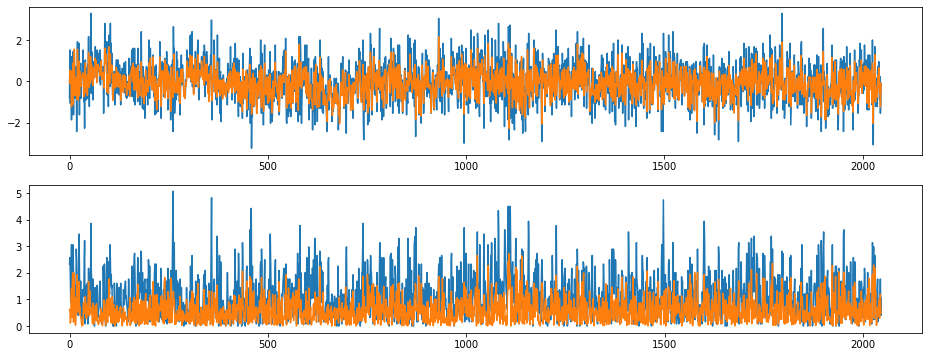

index:  52801
MAE:  0.44957845772936855
n_bunches       1916
bunch_index      236
bunch_number     119
Name: 6117875, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6243/instability_data/06243_Inst_B1H_Q7_20170925_21h02m11s.h5


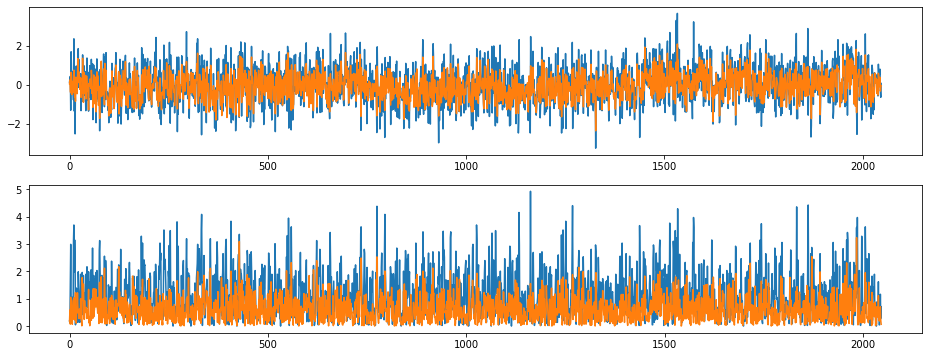

index:  304220
MAE:  0.4494213253333252
n_bunches        555
bunch_index     1238
bunch_number     226
Name: 6505277, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6613/instability_data/06613_Inst_B1H_Q7_20180426_00h39m36s.h5


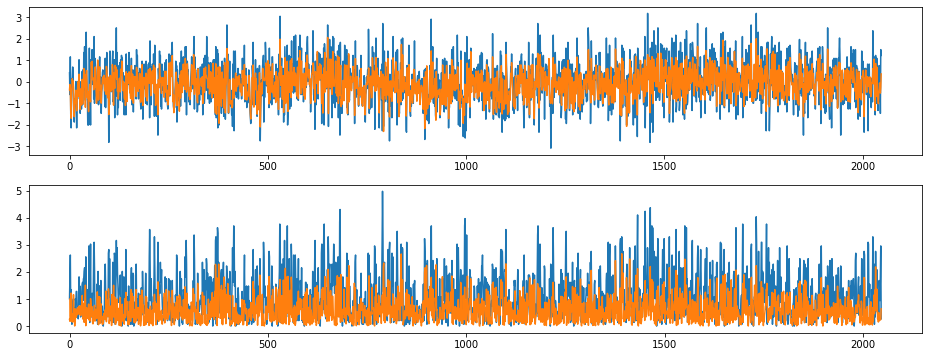

index:  160775
MAE:  0.4493885247151584
n_bunches       157
bunch_index     391
bunch_number    134
Name: 6017657, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7385/instability_data/07385_Inst_B1H_Q7_20181029_08h39m14s.h5


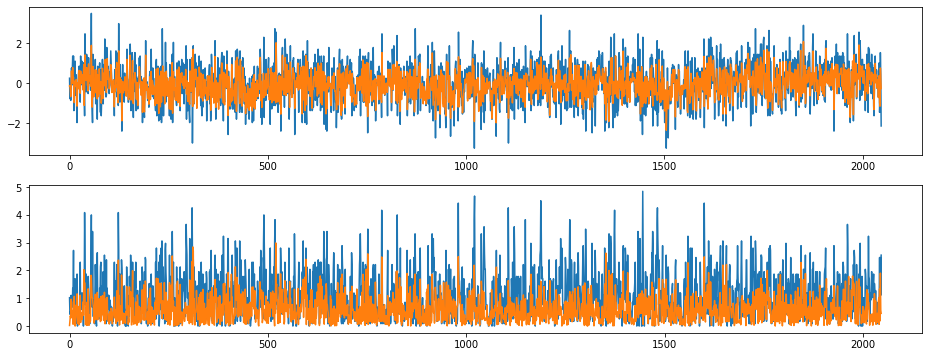

index:  29908
MAE:  0.44921599525280725
n_bunches       1452
bunch_index     1180
bunch_number     489
Name: 7095881, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6890/instability_data/06890_Inst_B1H_Q7_20180706_08h37m14s.h5


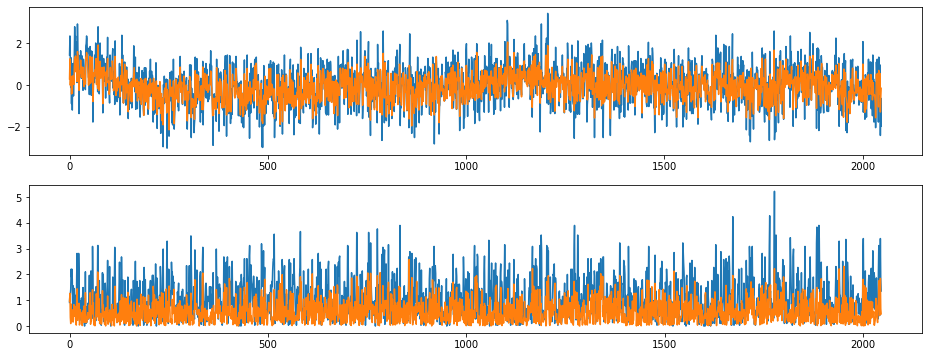

index:  104366
MAE:  0.44920445434578177
n_bunches        408
bunch_index     2205
bunch_number     347
Name: 7989212, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6436/instability_data/06436_Inst_B1H_Q7_20171130_05h55m57s.h5


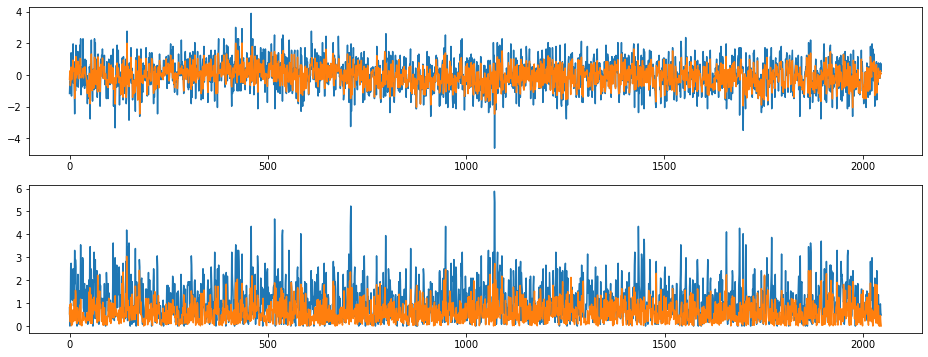

index:  292263
MAE:  0.4488759347946545
n_bunches        72
bunch_index     466
bunch_number     66
Name: 7171546, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6611/instability_data/06611_Inst_B1H_Q7_20180424_21h19m17s.h5


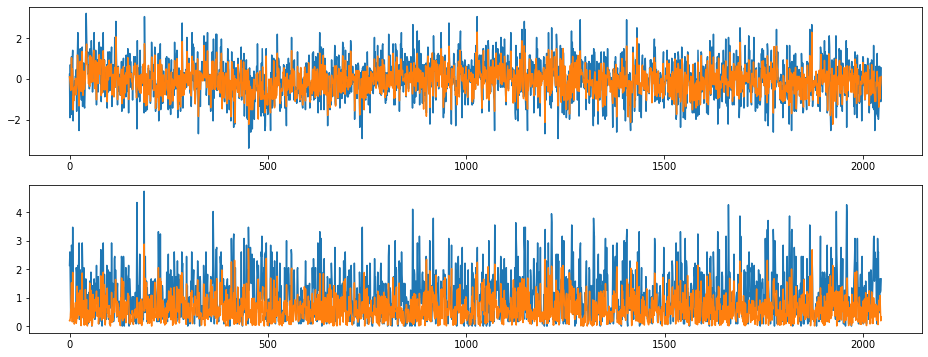

index:  353628
MAE:  0.44857457913492754
n_bunches       2556
bunch_index     3183
bunch_number    2359
Name: 4388529, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6659/instability_data/06659_Inst_B1H_Q7_20180509_07h00m16s.h5


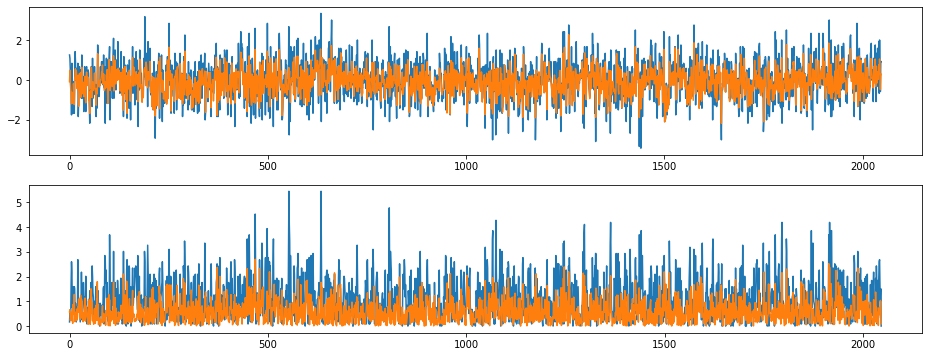

index:  52647
MAE:  0.44855285867191985
n_bunches       2556
bunch_index     3178
bunch_number    2354
Name: 1013757, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6757/instability_data/06757_Inst_B1H_Q7_20180604_17h45m56s.h5


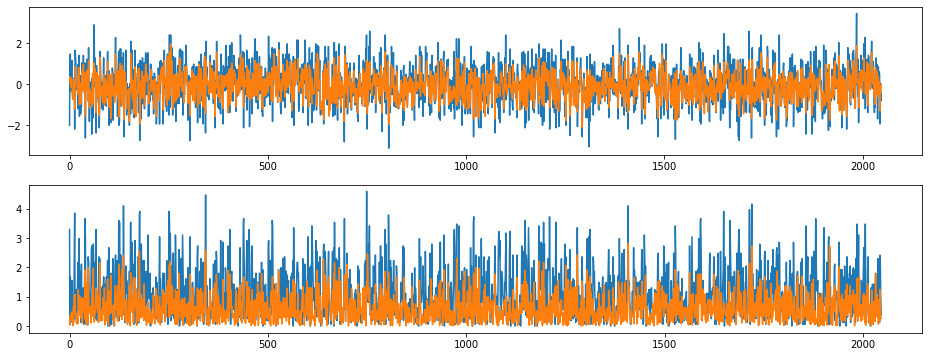

index:  108976
MAE:  0.44854487132986387
n_bunches        938
bunch_index     1479
bunch_number     586
Name: 8743036, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6854/instability_data/06854_Inst_B1H_Q7_20180627_21h45m42s.h5


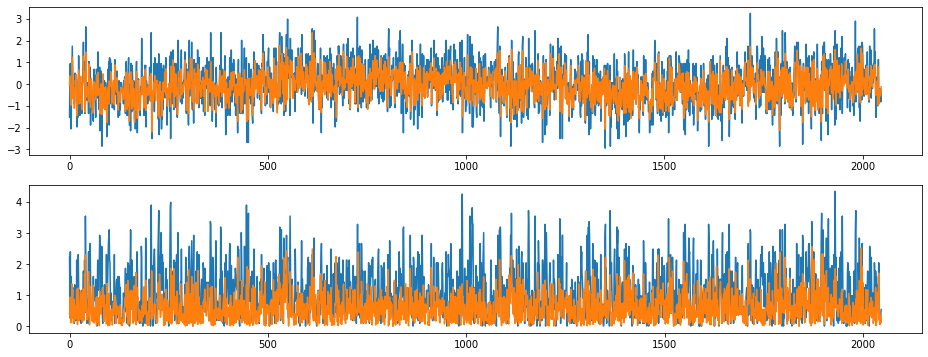

index:  145432
MAE:  0.4485393057493019
n_bunches       1836
bunch_index     3026
bunch_number    1615
Name: 7777968, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_12h56m13s.h5


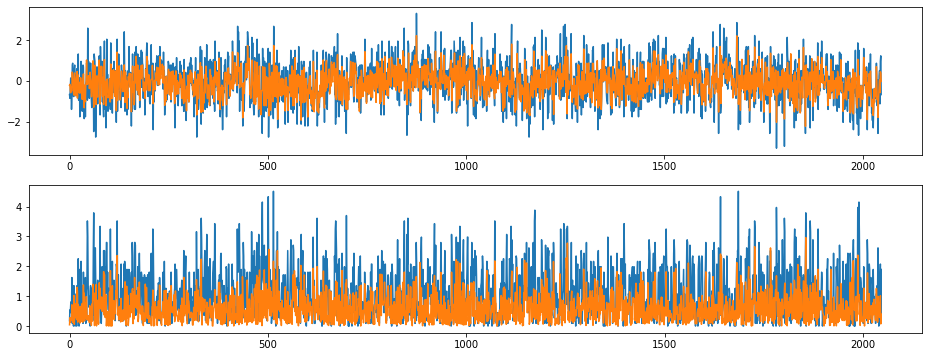

index:  50397
MAE:  0.4485256346100253
n_bunches       2556
bunch_index     1150
bunch_number     834
Name: 5249267, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7135/instability_data/07135_Inst_B1H_Q7_20180907_23h16m14s.h5


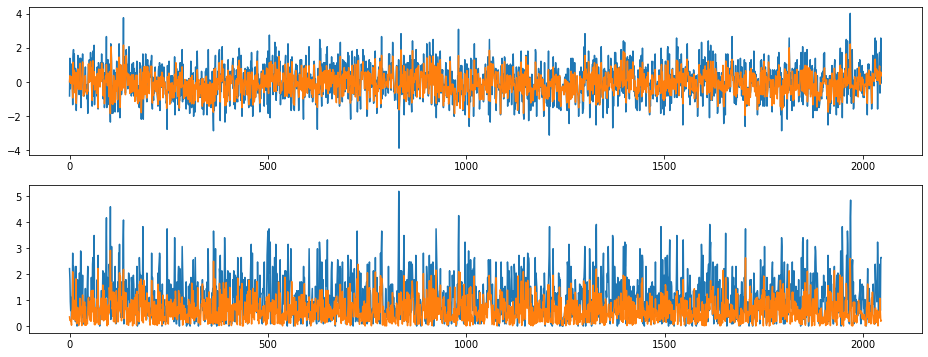

index:  233181
MAE:  0.44841521710865234
n_bunches       670
bunch_index     934
bunch_number    192
Name: 2828947, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7466/instability_data/07466_Inst_B1H_Q7_20181122_18h55m16s.h5


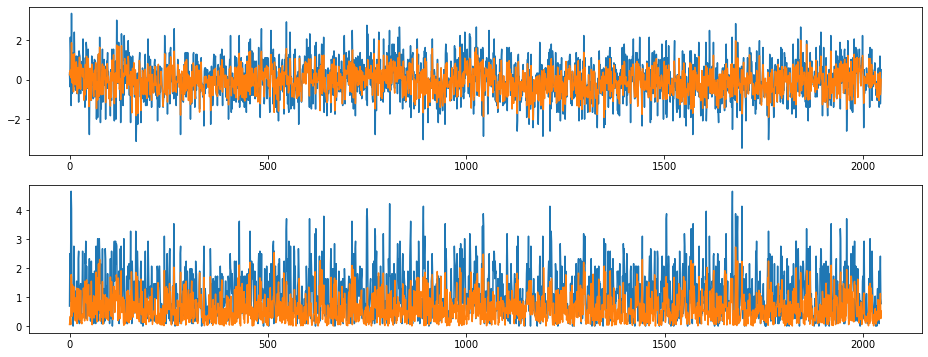

index:  40749
MAE:  0.44832784198156084
n_bunches       2556
bunch_index     1711
bunch_number    1244
Name: 7207281, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6696/instability_data/06696_Inst_B1H_Q7_20180518_08h19m14s.h5


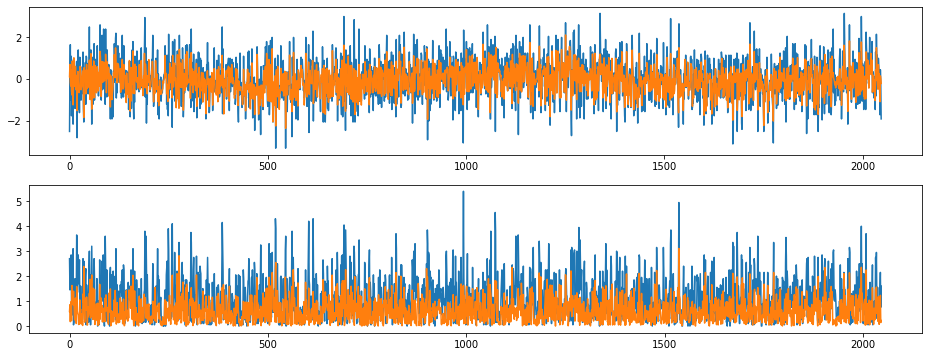

index:  310100
MAE:  0.44826106082722916
n_bunches       1068
bunch_index      116
bunch_number      48
Name: 11618971, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6752/instability_data/06752_Inst_B1H_Q7_20180602_11h34m14s.h5


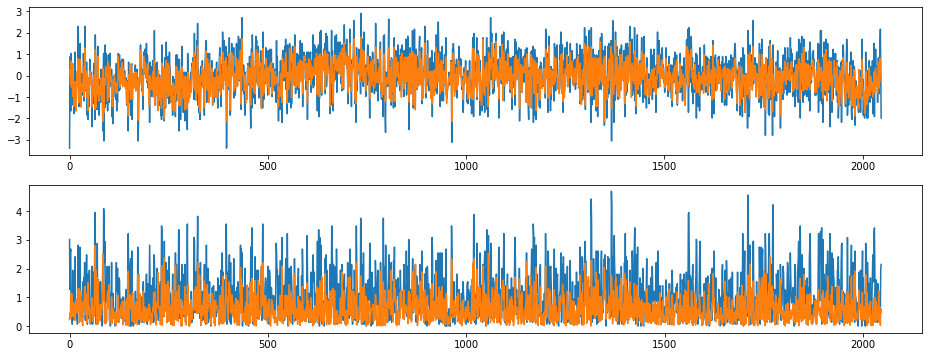

index:  60783
MAE:  0.44818317275994096
n_bunches       300
bunch_index     278
bunch_number    145
Name: 3929418, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6347/instability_data/06347_Inst_B1H_Q7_20171030_10h53m32s.h5


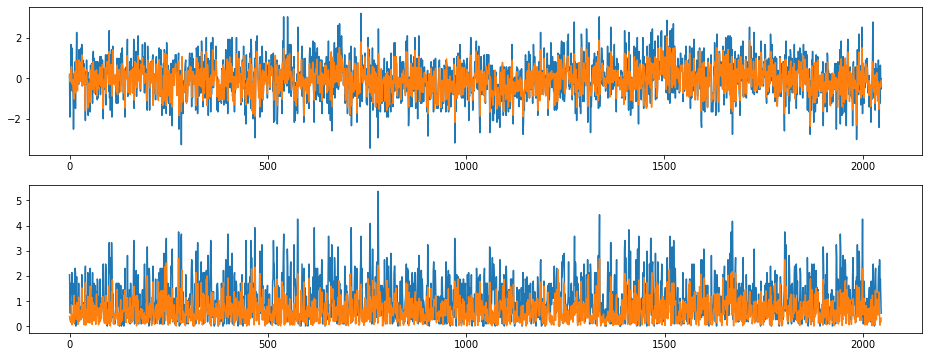

index:  99834
MAE:  0.44810408187855266
n_bunches       1292
bunch_index     2158
bunch_number     761
Name: 1256886, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6384/instability_data/06384_Inst_B1H_Q7_20171112_22h14m14s.h5


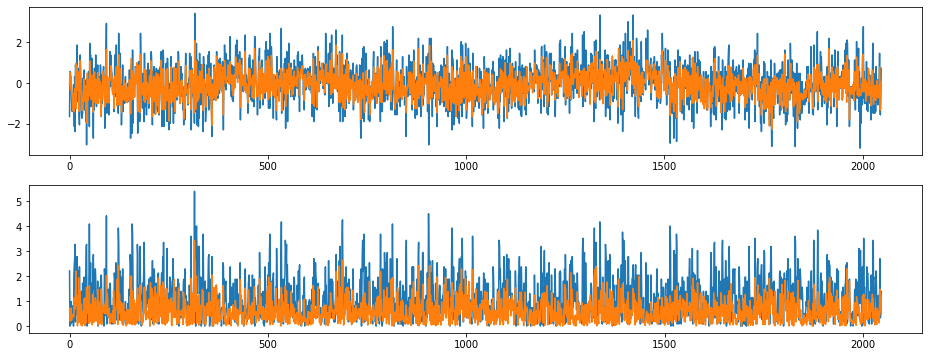

index:  325432
MAE:  0.44810145878767016
n_bunches       1004
bunch_index     1462
bunch_number     784
Name: 8429306, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6351/instability_data/06351_Inst_B1H_Q7_20171031_15h20m14s.h5


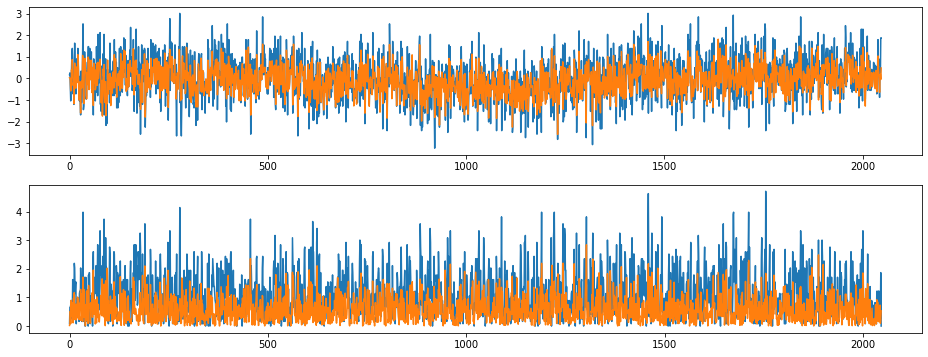

index:  140907
MAE:  0.44809252040748593
n_bunches       168
bunch_index     428
bunch_number    134
Name: 2151850, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6614/instability_data/06614_Inst_B1H_Q7_20180426_02h49m01s.h5


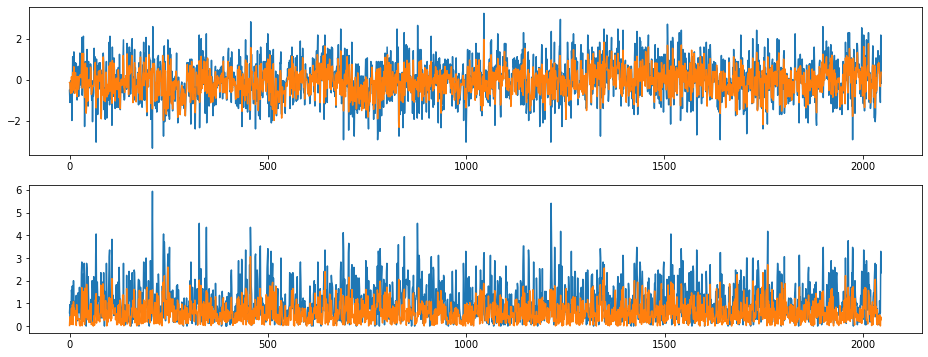

index:  73330
MAE:  0.448063597416422
n_bunches       987
bunch_index     567
bunch_number    219
Name: 9230240, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6688/instability_data/06688_Inst_B1H_Q7_20180515_23h31m14s.h5


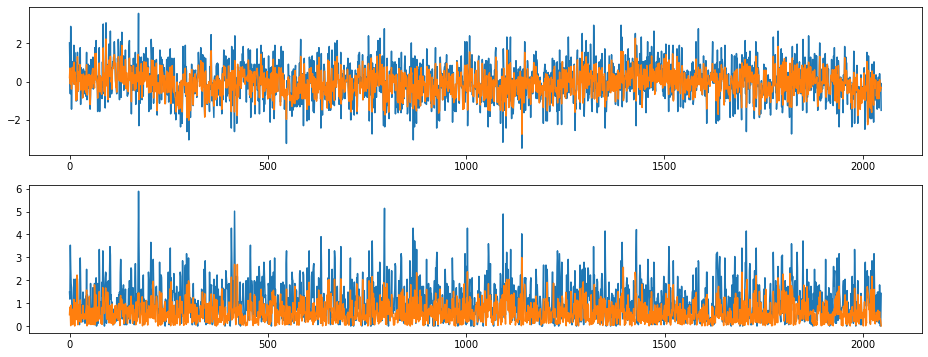

index:  90908
MAE:  0.44795566138549914
n_bunches        648
bunch_index     2734
bunch_number     508
Name: 899063, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7483/instability_data/07483_Inst_B1H_Q7_20181129_08h51m14s.h5


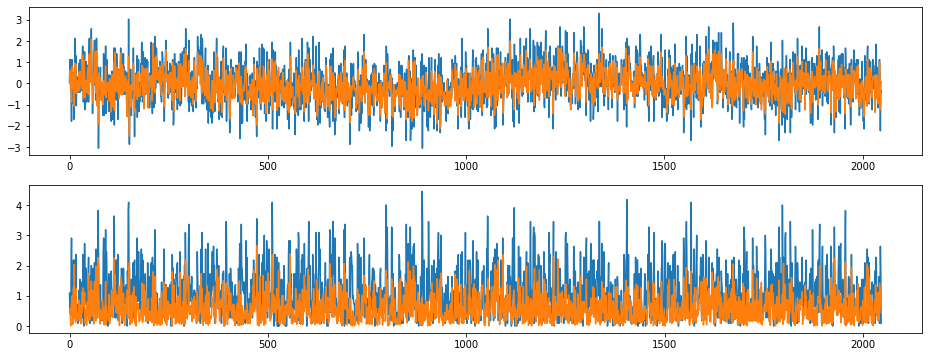

index:  59229
MAE:  0.4479528670855288
n_bunches       1868
bunch_index     1603
bunch_number     875
Name: 8264005, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6343/instability_data/06343_Inst_B1H_Q7_20171028_14h01m14s.h5


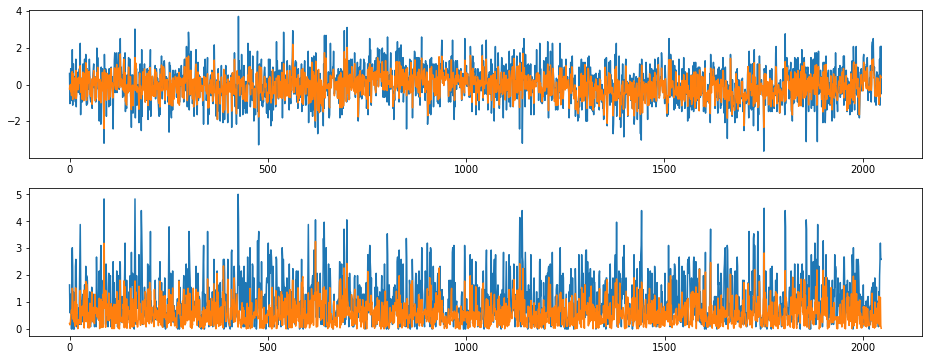

index:  287224
MAE:  0.44788753302897344
n_bunches       396
bunch_index     442
bunch_number    303
Name: 1152337, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7105/instability_data/07105_Inst_B1H_Q7_20180830_10h39m16s.h5


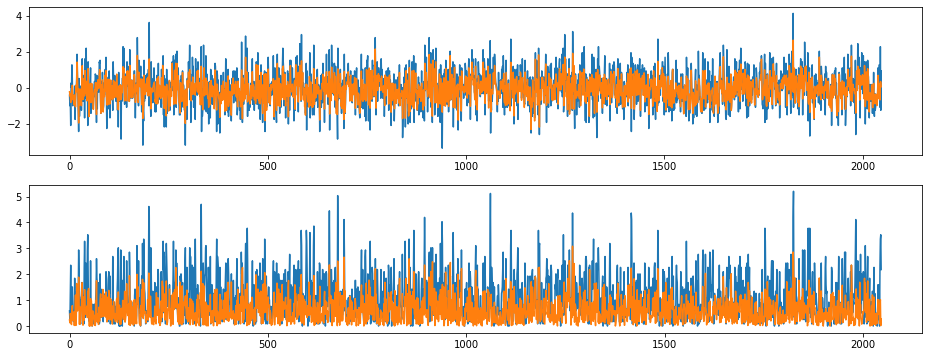

index:  371083
MAE:  0.4477869445210634
n_bunches       460
bunch_index     512
bunch_number    107
Name: 1193001, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7489/instability_data/07489_Inst_B1H_Q7_20181201_17h25m07s.h5


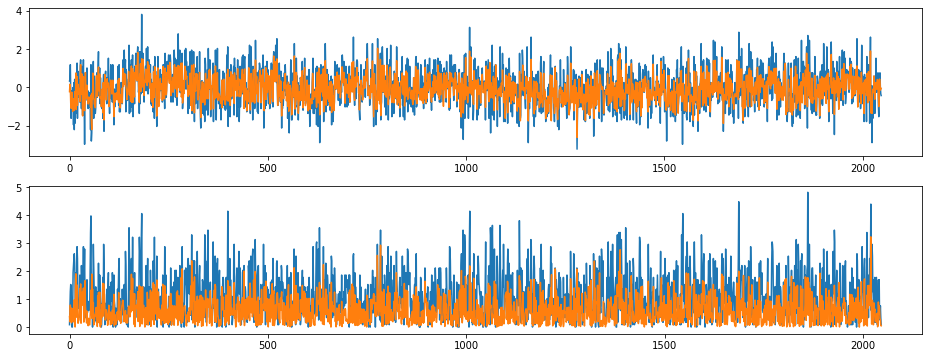

index:  93016
MAE:  0.4476534800169509
n_bunches       1887
bunch_index     1017
bunch_number     549
Name: 2190518, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6629/instability_data/06629_Inst_B1H_Q7_20180501_20h56m15s.h5


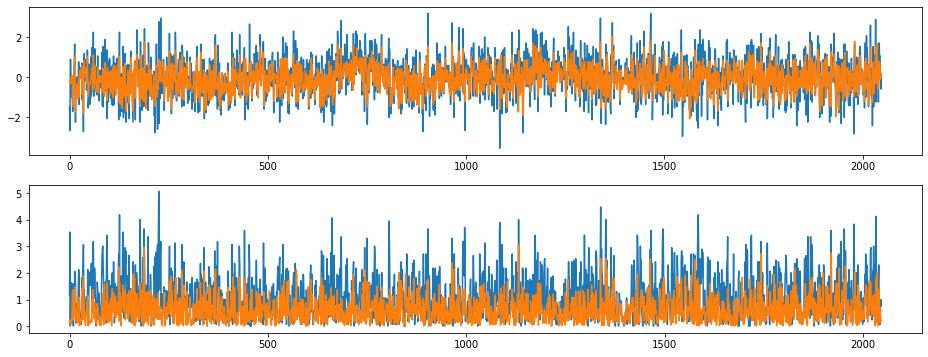

index:  369944
MAE:  0.4476237032427511
n_bunches       286
bunch_index     322
bunch_number     36
Name: 9038785, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6984/instability_data/06984_Inst_B1H_Q7_20180726_21h31m11s.h5


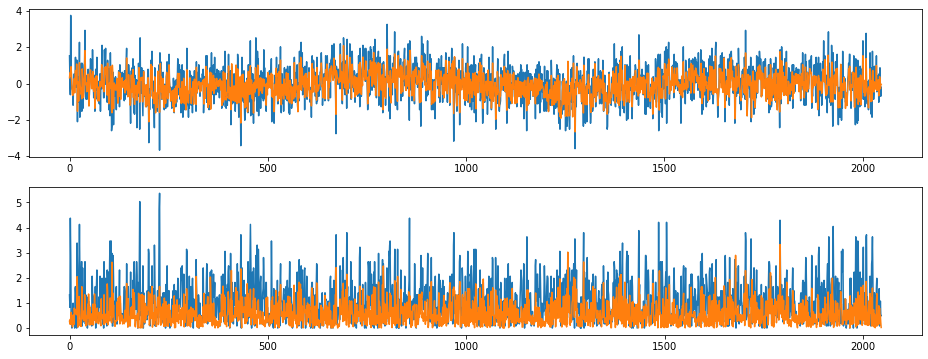

index:  371631
MAE:  0.44753961968931877
n_bunches       908
bunch_index     516
bunch_number    279
Name: 2519189, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6360/instability_data/06360_Inst_B1H_Q7_20171103_13h16m20s.h5


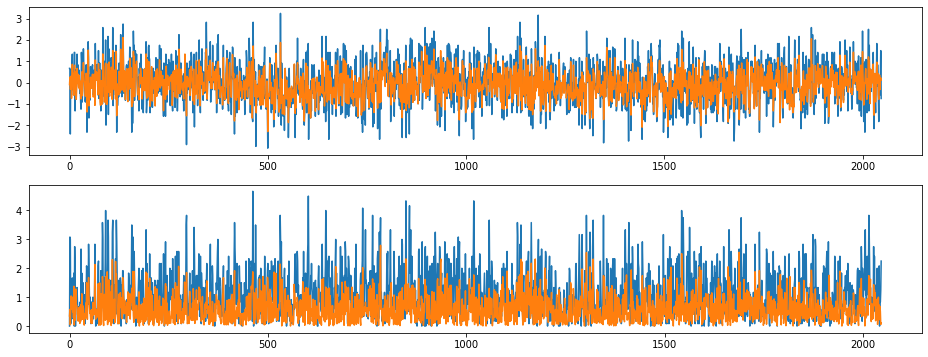

index:  369911
MAE:  0.44712354453301617
n_bunches       108
bunch_index      22
bunch_number      4
Name: 6362046, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7353/instability_data/07353_Inst_B1H_Q7_20181025_17h10m54s.h5


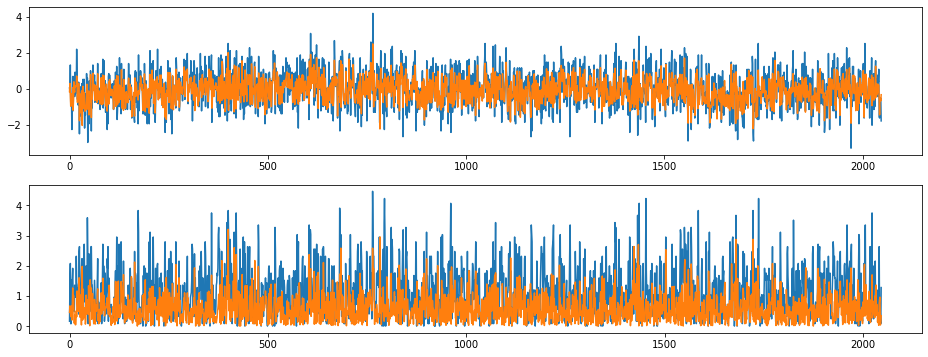

index:  371954
MAE:  0.4469473713270651
n_bunches       1916
bunch_index     3429
bunch_number    1907
Name: 1526717, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6243/instability_data/06243_Inst_B1H_Q7_20170926_07h20m15s.h5


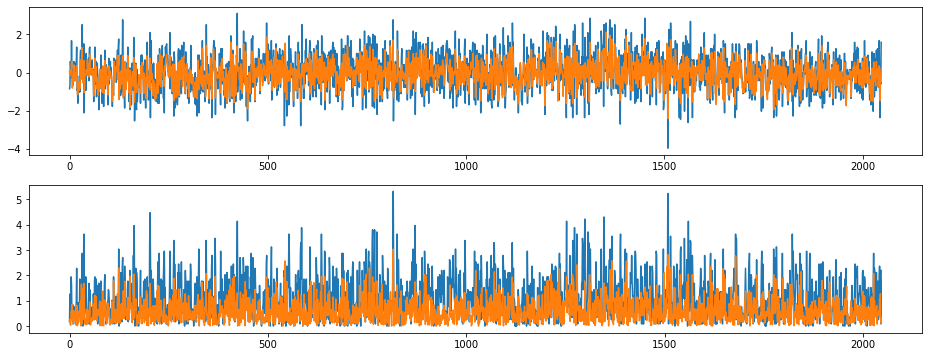

index:  374460
MAE:  0.44691351144657776
n_bunches       460
bunch_index     443
bunch_number     42
Name: 7875343, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7464/instability_data/07464_Inst_B1H_Q7_20181122_08h39m13s.h5


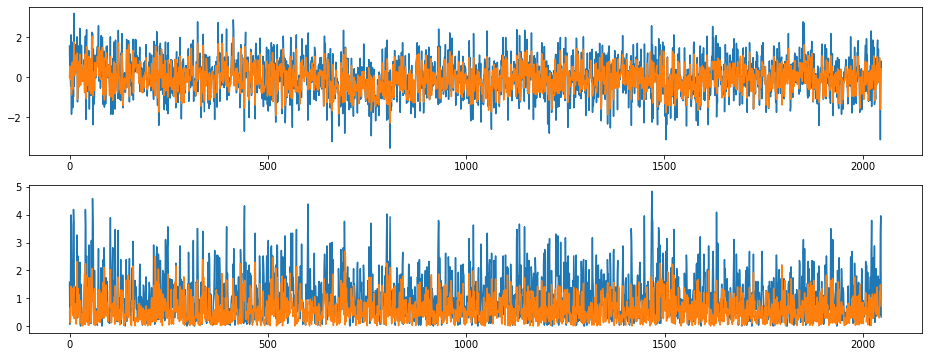

index:  351454
MAE:  0.44689026814445143
n_bunches        987
bunch_index     1948
bunch_number     528
Name: 6615333, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6616/instability_data/06616_Inst_B1H_Q7_20180427_10h42m14s.h5


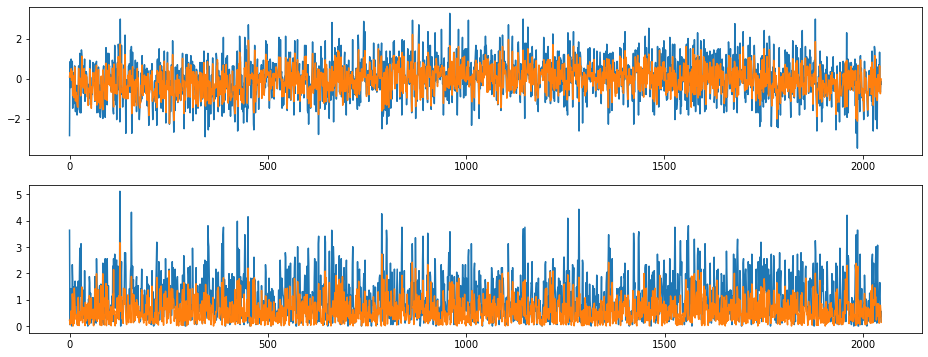

index:  324153
MAE:  0.4468426308031379
n_bunches       2556
bunch_index     1913
bunch_number    1401
Name: 5408845, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6763/instability_data/06763_Inst_B1H_Q7_20180607_01h10m15s.h5


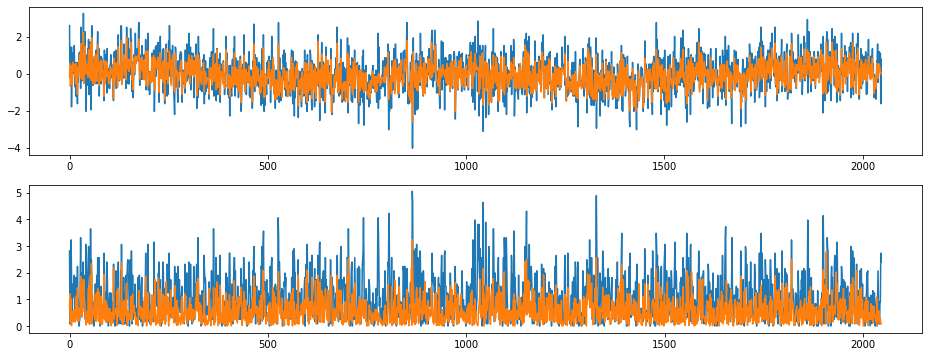

index:  303673
MAE:  0.4467678699037262
n_bunches       45
bunch_index     21
bunch_number     9
Name: 5082205, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6404/instability_data/06404_Inst_B1H_Q7_20171121_16h53m15s.h5


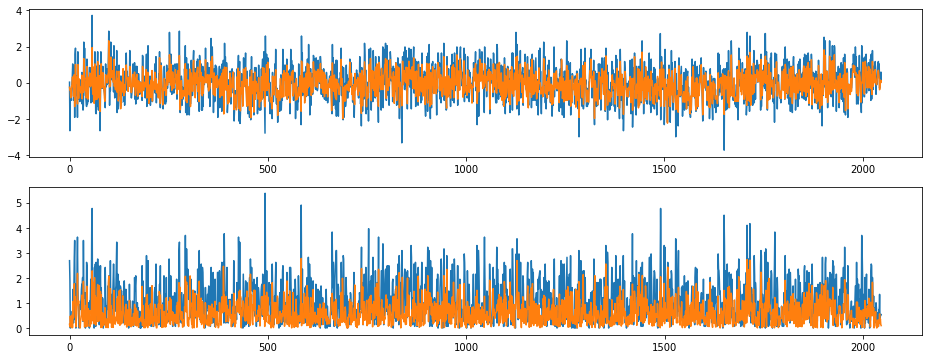

index:  247686
MAE:  0.44673331138573175
n_bunches       1212
bunch_index      517
bunch_number     377
Name: 7052398, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6215/instability_data/06215_Inst_B1H_Q7_20170916_23h35m13s.h5


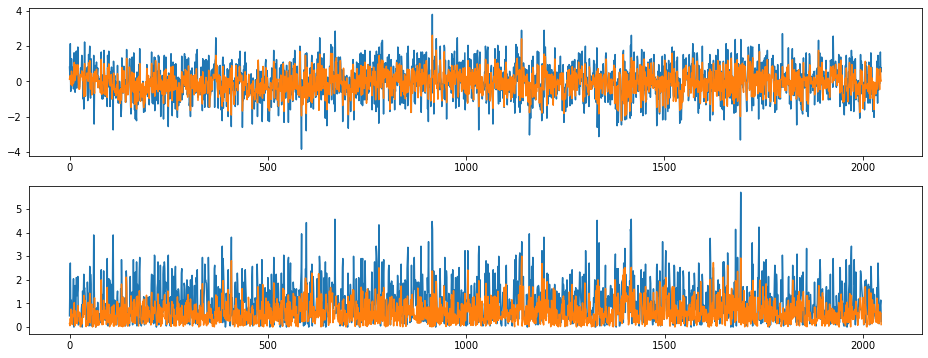

index:  35574
MAE:  0.44670566766669684
n_bunches       180
bunch_index     300
bunch_number    160
Name: 8180735, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h32m56s.h5


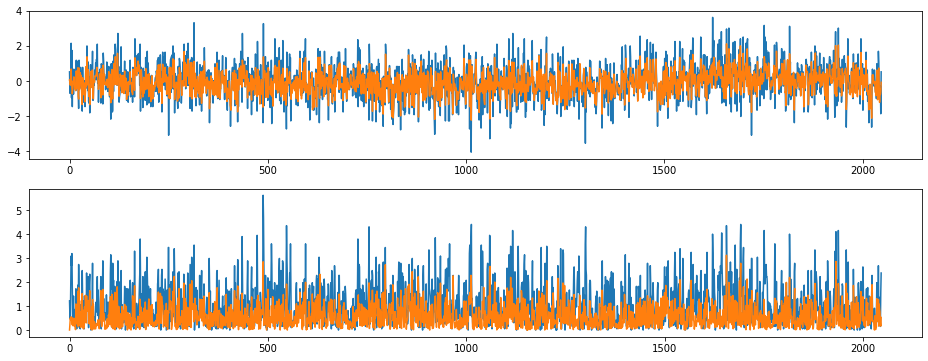

index:  100714
MAE:  0.4466618551954179
n_bunches       339
bunch_index     257
bunch_number     66
Name: 7194901, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6594/instability_data/06594_Inst_B1H_Q7_20180422_13h27m14s.h5


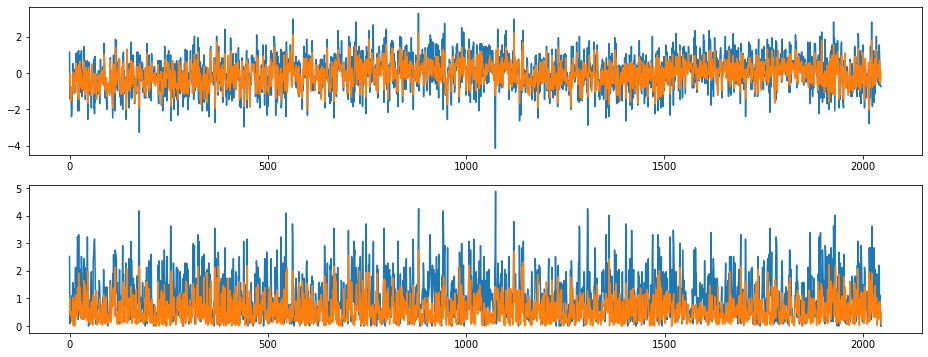

index:  104343
MAE:  0.446660145598629
n_bunches       852
bunch_index     423
bunch_number    181
Name: 5763645, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7365/instability_data/07365_Inst_B1H_Q7_20181026_23h11m53s.h5


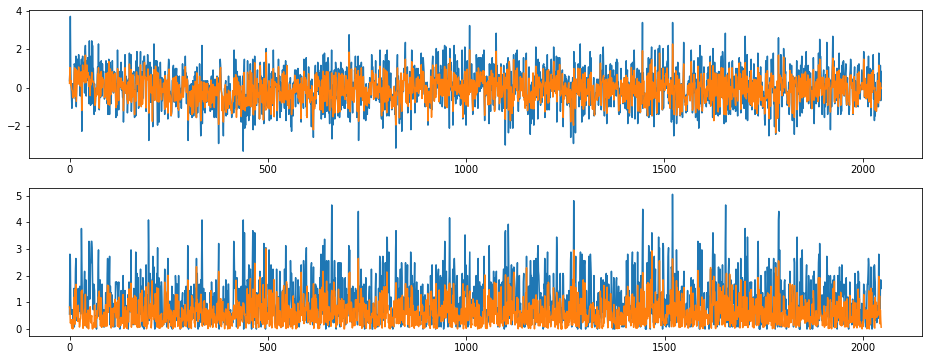

index:  113685
MAE:  0.44654119400090153
n_bunches       648
bunch_index     145
bunch_number     23
Name: 6152333, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_09h15m15s.h5


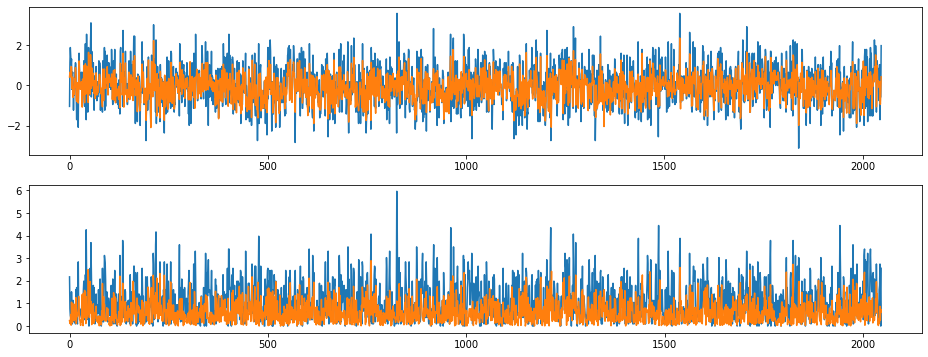

index:  324554
MAE:  0.44650819412301945
n_bunches       1916
bunch_index     2506
bunch_number    1390
Name: 3906971, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6255/instability_data/06255_Inst_B1H_Q7_20170929_07h24m14s.h5


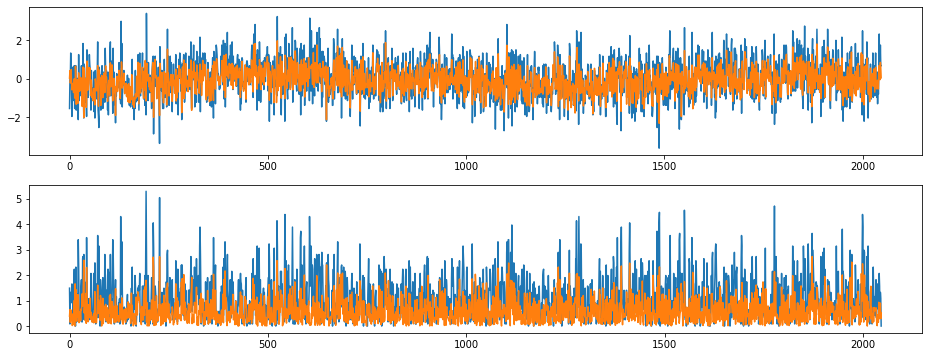

index:  1478
MAE:  0.4464593024466784
n_bunches        460
bunch_index     1727
bunch_number     363
Name: 3717708, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7490/instability_data/07490_Inst_B1H_Q7_20181201_20h40m04s.h5


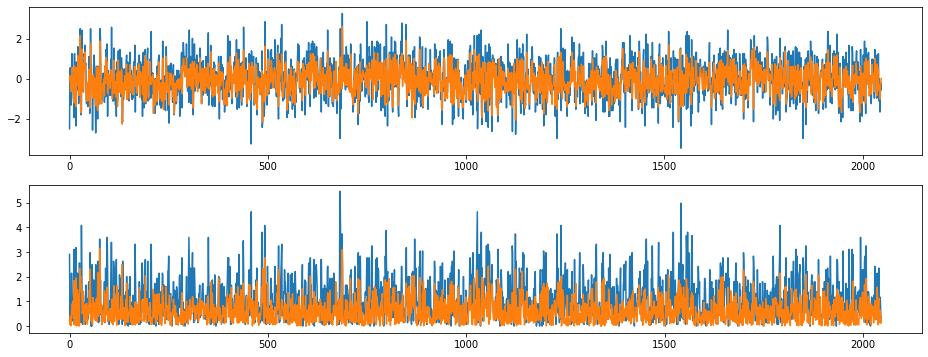

index:  160074
MAE:  0.4463415332828468
n_bunches       1212
bunch_index      827
bunch_number     582
Name: 3181816, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6659/instability_data/06659_Inst_B1H_Q7_20180509_00h27m15s.h5


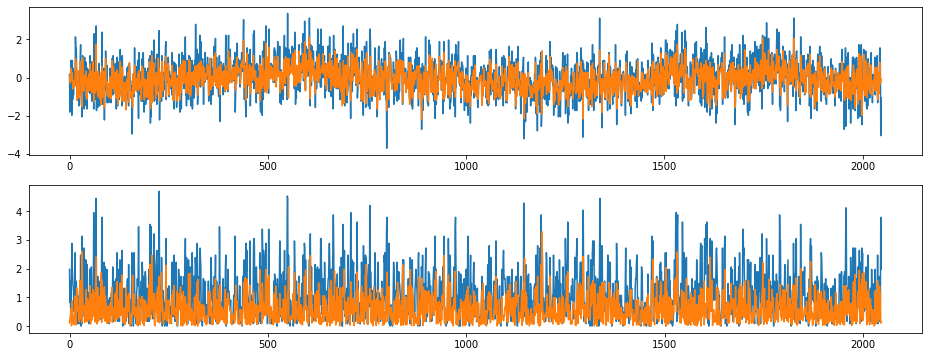

index:  305680
MAE:  0.44627741964032985
n_bunches        670
bunch_index     1376
bunch_number     289
Name: 1654371, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7466/instability_data/07466_Inst_B1H_Q7_20181123_01h16m14s.h5


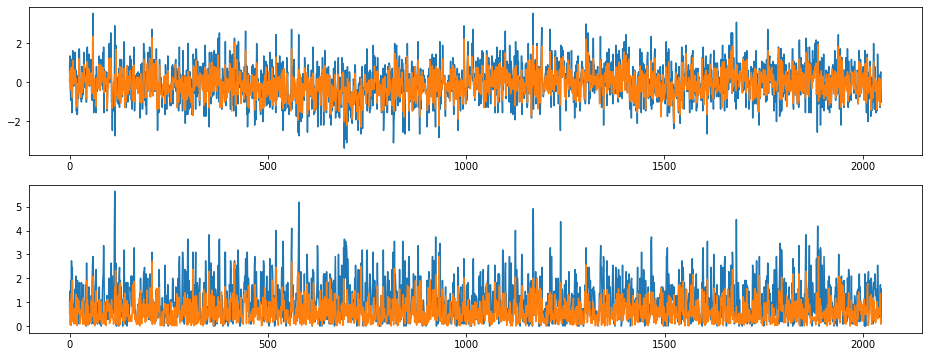

index:  349392
MAE:  0.44627634994270354
n_bunches       444
bunch_index     397
bunch_number    169
Name: 10482033, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6988/instability_data/06988_Inst_B1H_Q7_20180727_05h37m14s.h5


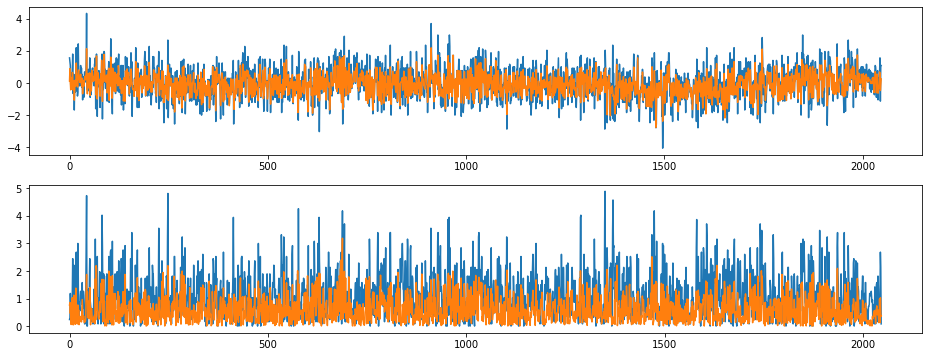

index:  172722
MAE:  0.44625165316503174
n_bunches       1380
bunch_index      480
bunch_number     374
Name: 889043, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6600/instability_data/06600_Inst_B1H_Q7_20180423_13h36m14s.h5


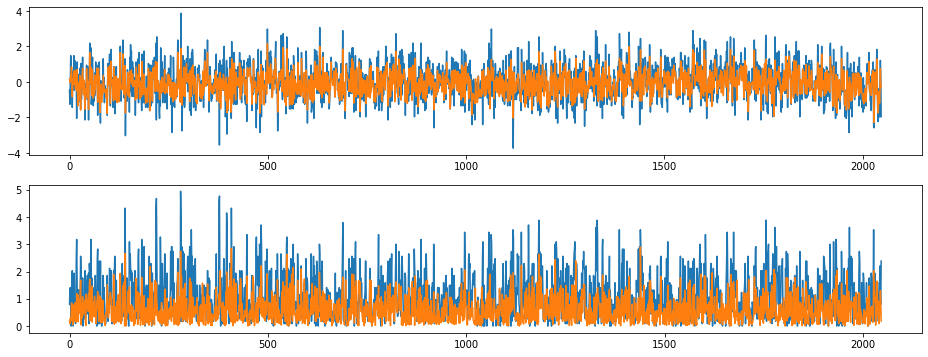

index:  109335
MAE:  0.44616161908008833
n_bunches       648
bunch_index     499
bunch_number     90
Name: 892072, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7483/instability_data/07483_Inst_B1H_Q7_20181129_05h35m16s.h5


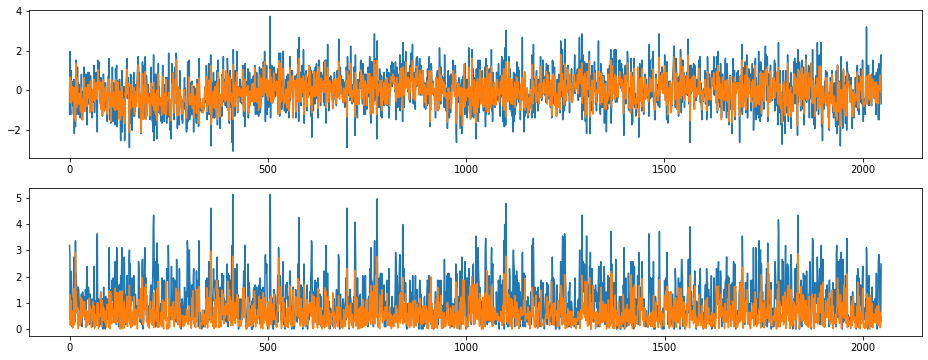

index:  104330
MAE:  0.44602039108435126
n_bunches       852
bunch_index     423
bunch_number    181
Name: 5763645, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7365/instability_data/07365_Inst_B1H_Q7_20181026_23h11m53s.h5


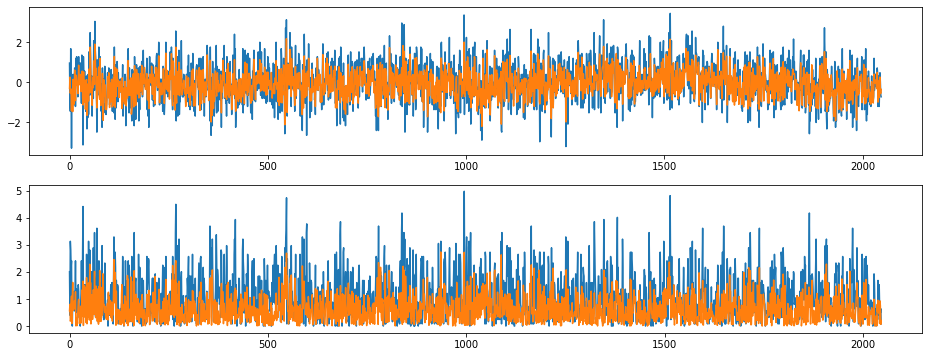

index:  58839
MAE:  0.4459363448925079
n_bunches       540
bunch_index     501
bunch_number    349
Name: 728261, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6874/instability_data/06874_Inst_B1H_Q7_20180702_00h07m47s.h5


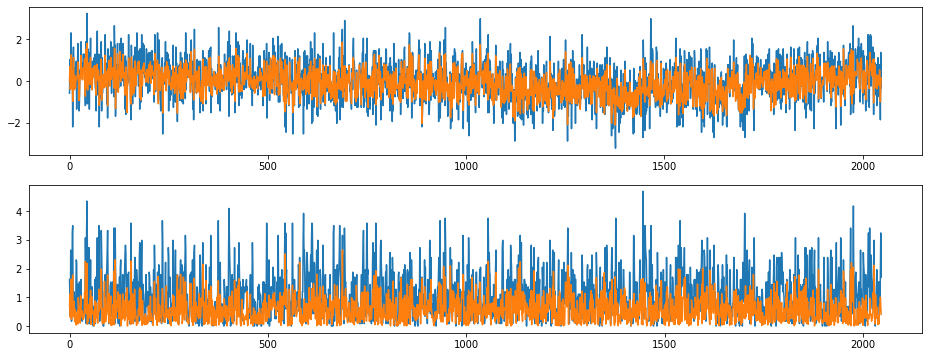

index:  183887
MAE:  0.4458360596707477
n_bunches       1212
bunch_index      250
bunch_number     144
Name: 3181378, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6659/instability_data/06659_Inst_B1H_Q7_20180509_00h27m15s.h5


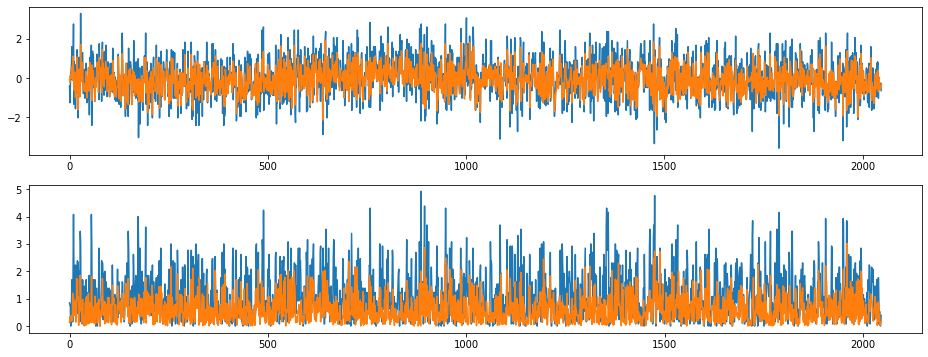

index:  369558
MAE:  0.4457318508444607
n_bunches       1212
bunch_index     1360
bunch_number     999
Name: 7019328, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7234/instability_data/07234_Inst_B1H_Q7_20180929_02h45m25s.h5


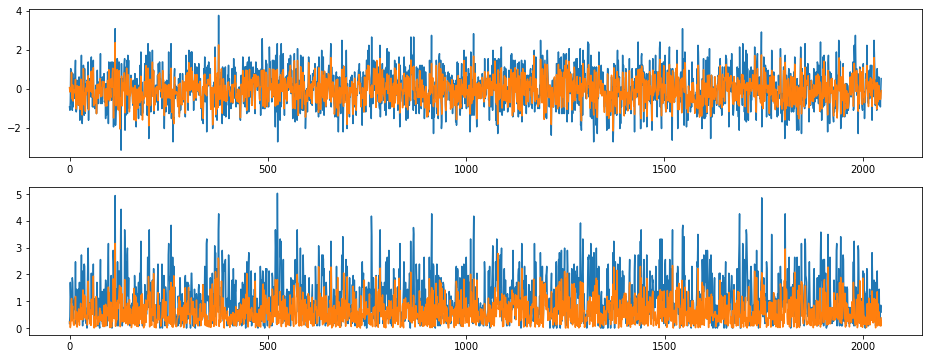

index:  438
MAE:  0.4457140104415849
n_bunches       588
bunch_index     826
bunch_number    353
Name: 6649590, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6809/instability_data/06809_Inst_B1H_Q7_20180616_07h00m14s.h5


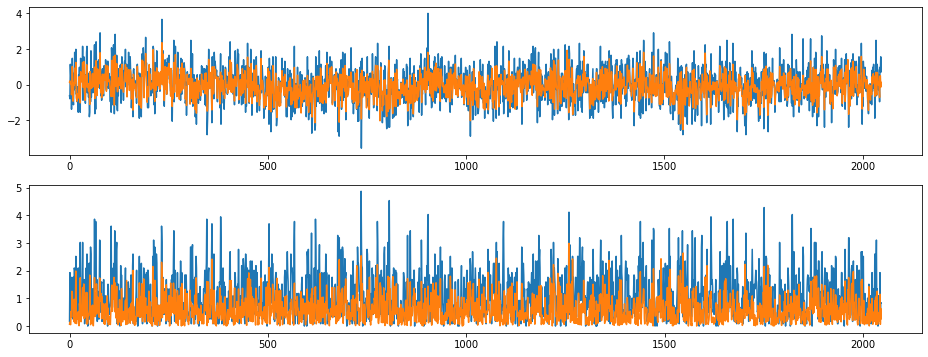

index:  167694
MAE:  0.44570088415172415
n_bunches       1916
bunch_index      215
bunch_number     106
Name: 9703585, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6243/instability_data/06243_Inst_B1H_Q7_20170926_08h10m15s.h5


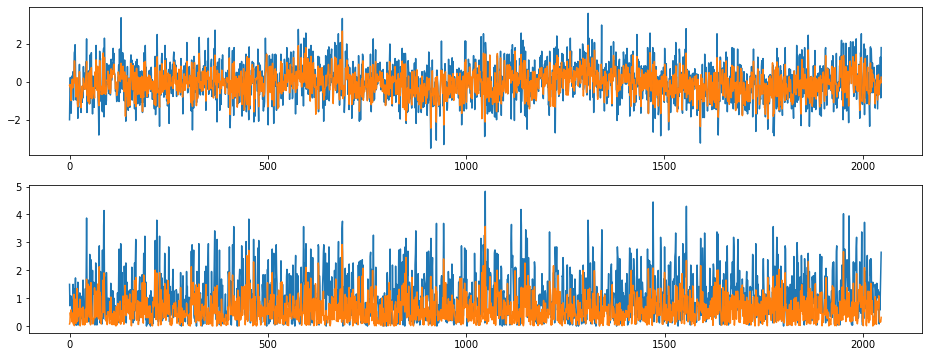

index:  331456
MAE:  0.4456454360268218
n_bunches       376
bunch_index     721
bunch_number    153
Name: 3734659, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7485/instability_data/07485_Inst_B1H_Q7_20181129_20h08m09s.h5


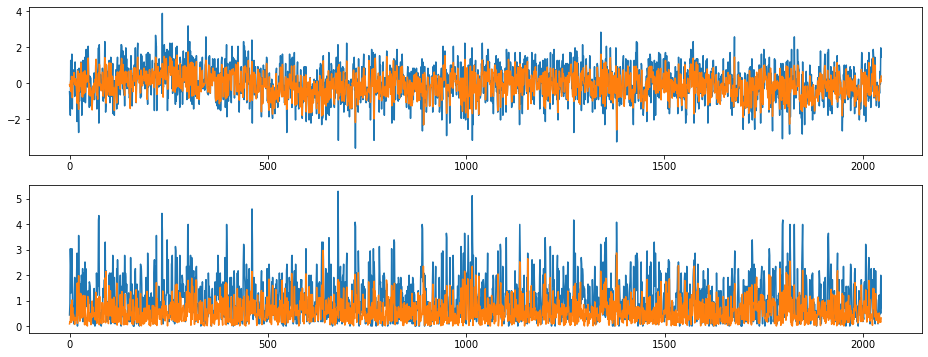

index:  227050
MAE:  0.4454990018034862
n_bunches       780
bunch_index     915
bunch_number    651
Name: 11598375, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7053/instability_data/07053_Inst_B1H_Q7_20180814_04h33m15s.h5


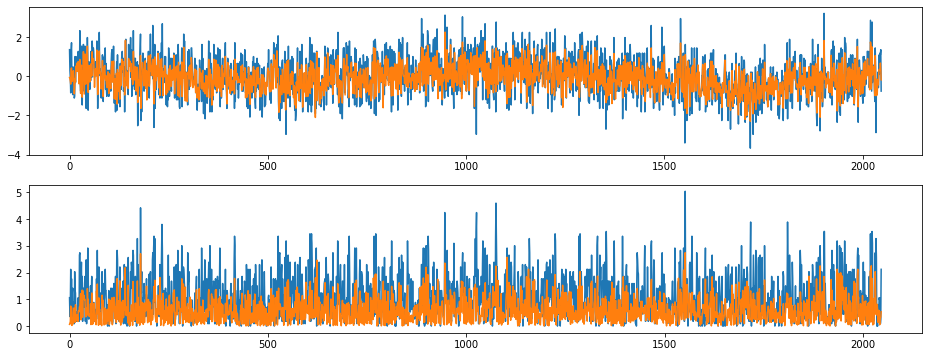

index:  278659
MAE:  0.4453488446104872
n_bunches       1068
bunch_index      116
bunch_number      60
Name: 11706409, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7123/instability_data/07123_Inst_B1H_Q7_20180903_17h42m12s.h5


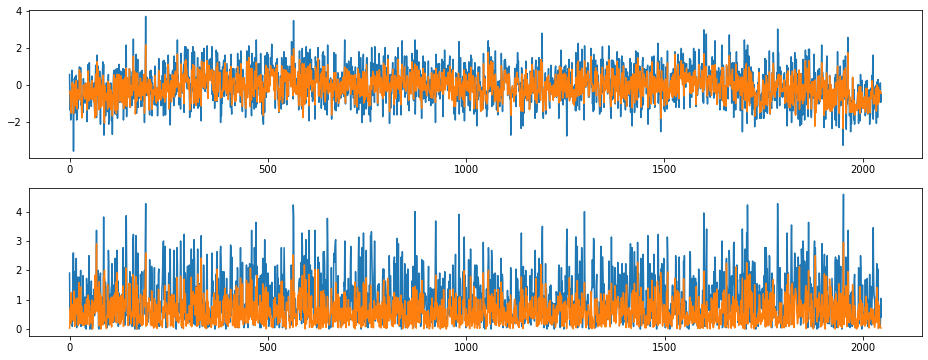

index:  373049
MAE:  0.4453073182255982
n_bunches       1868
bunch_index     1951
bunch_number    1040
Name: 10539442, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6356/instability_data/06356_Inst_B1H_Q7_20171102_05h47m14s.h5


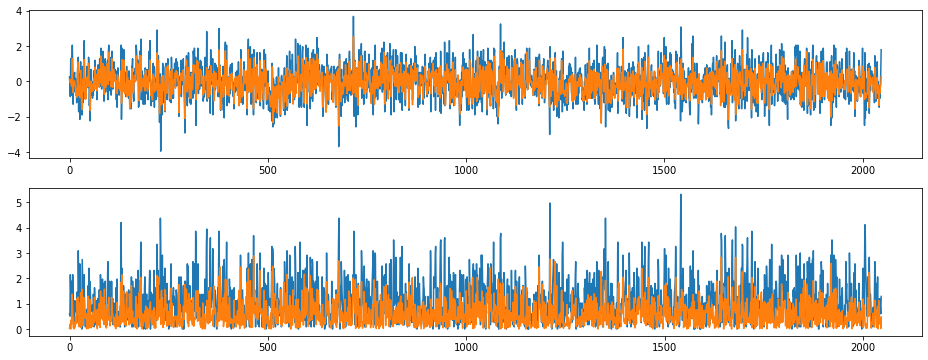

index:  194002
MAE:  0.4451588836527349
n_bunches       1868
bunch_index      362
bunch_number     182
Name: 7223954, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6337/instability_data/06337_Inst_B1H_Q7_20171027_07h42m14s.h5


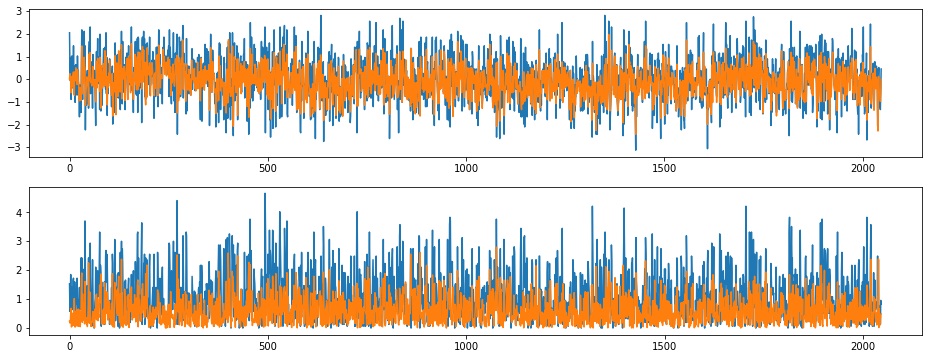

index:  195018
MAE:  0.4450670201687468
n_bunches       1068
bunch_index      845
bunch_number     593
Name: 3756527, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6741/instability_data/06741_Inst_B1H_Q7_20180530_10h08m43s.h5


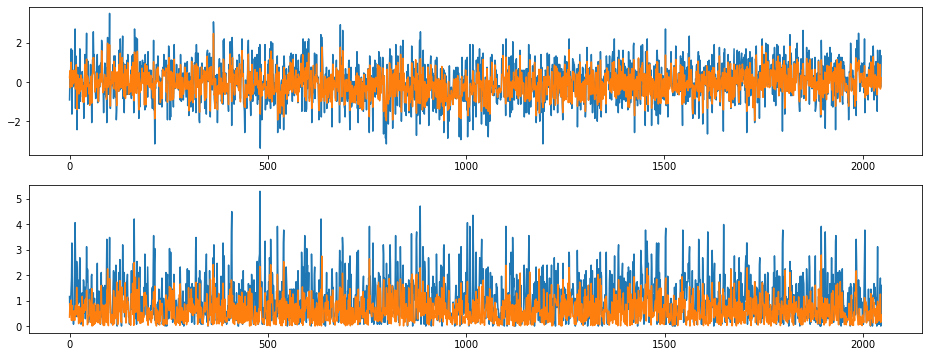

index:  126593
MAE:  0.4450397933823957
n_bunches       156
bunch_index     221
bunch_number    152
Name: 5791795, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6902/instability_data/06902_Inst_B1H_Q7_20180708_19h55m14s.h5


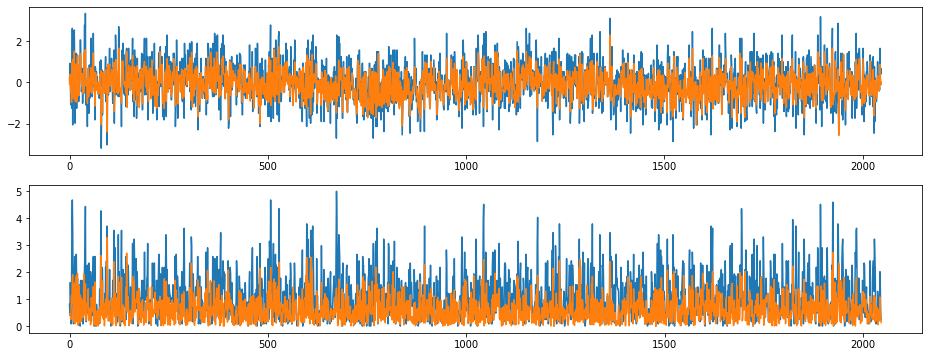

index:  55401
MAE:  0.4450371971270831
n_bunches       2556
bunch_index     1421
bunch_number    1059
Name: 2333842, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6215/instability_data/06215_Inst_B1H_Q7_20170917_01h05m13s.h5


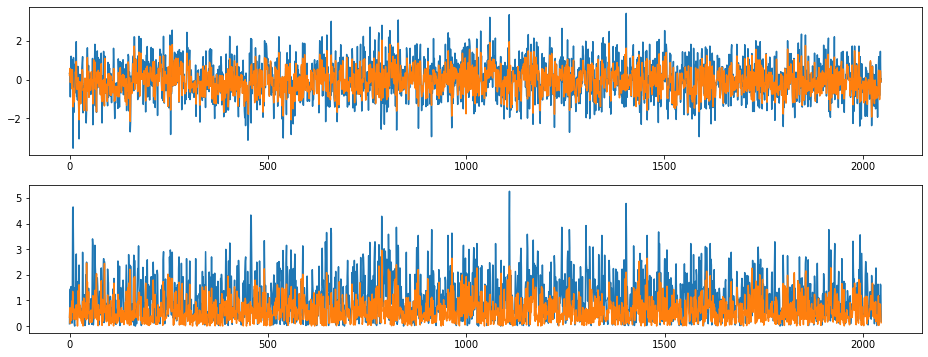

index:  296704
MAE:  0.44494773628350437
n_bunches       1868
bunch_index     2241
bunch_number    1207
Name: 9893850, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6279/instability_data/06279_Inst_B1H_Q7_20171007_10h42m14s.h5


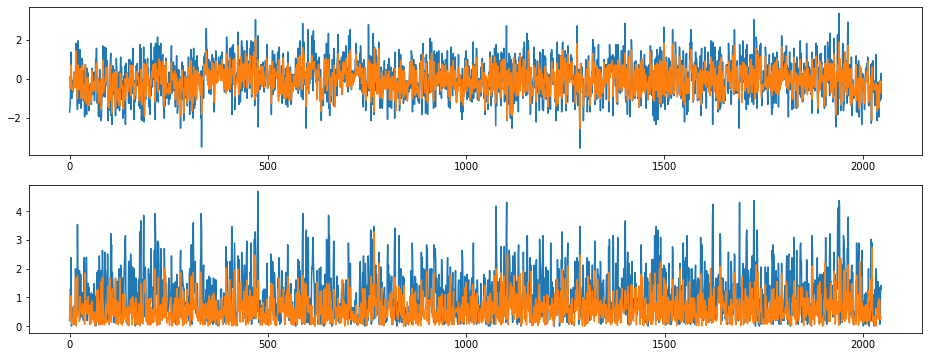

index:  219846
MAE:  0.44488386595513973
n_bunches       2556
bunch_index     2590
bunch_number    1926
Name: 5577784, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6215/instability_data/06215_Inst_B1H_Q7_20170917_01h11m13s.h5


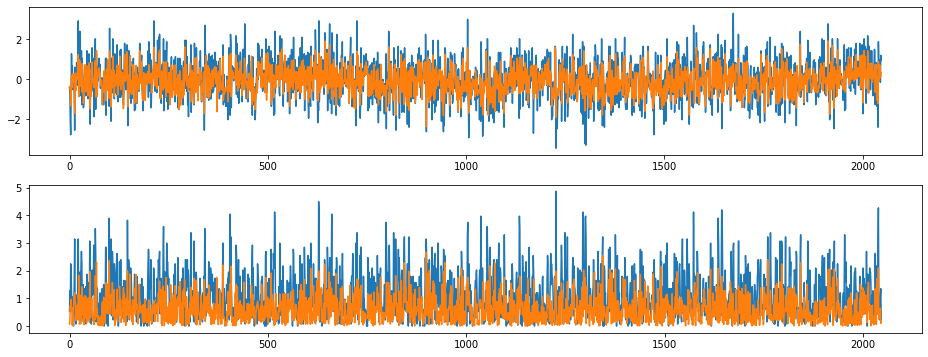

index:  2611
MAE:  0.444796788283443
n_bunches       1916
bunch_index     1157
bunch_number     631
Name: 4448452, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6255/instability_data/06255_Inst_B1H_Q7_20170929_07h17m54s.h5


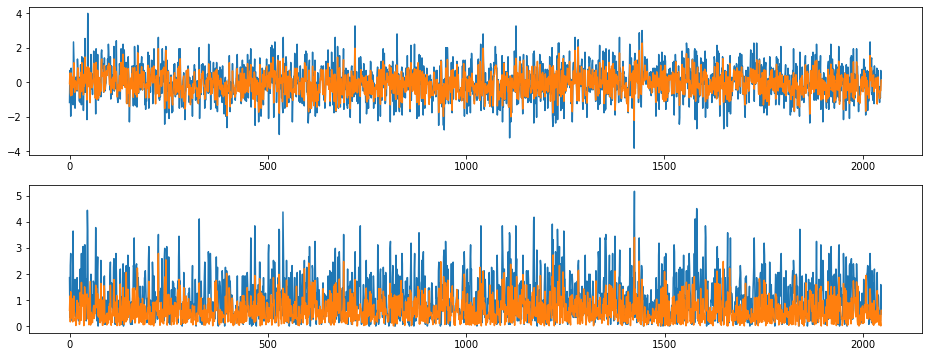

index:  299164
MAE:  0.4447865657048804
n_bunches       2556
bunch_index     2427
bunch_number    1799
Name: 10771710, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7018/instability_data/07018_Inst_B1H_Q7_20180804_15h43m46s.h5


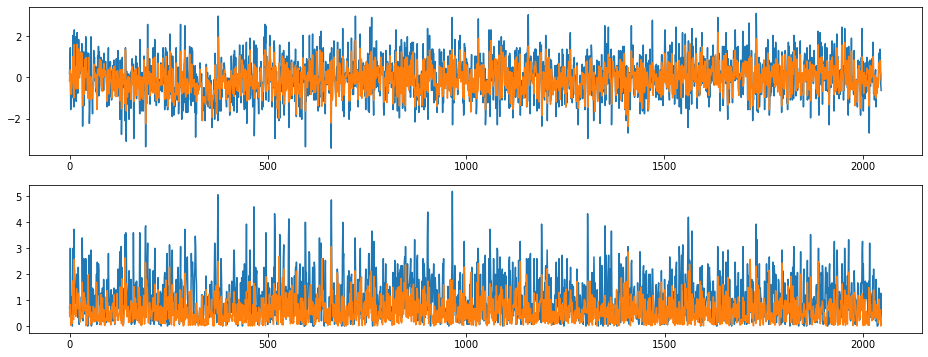

index:  324147
MAE:  0.44477602718747566
n_bunches       2556
bunch_index     1913
bunch_number    1401
Name: 5408845, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6763/instability_data/06763_Inst_B1H_Q7_20180607_01h10m15s.h5


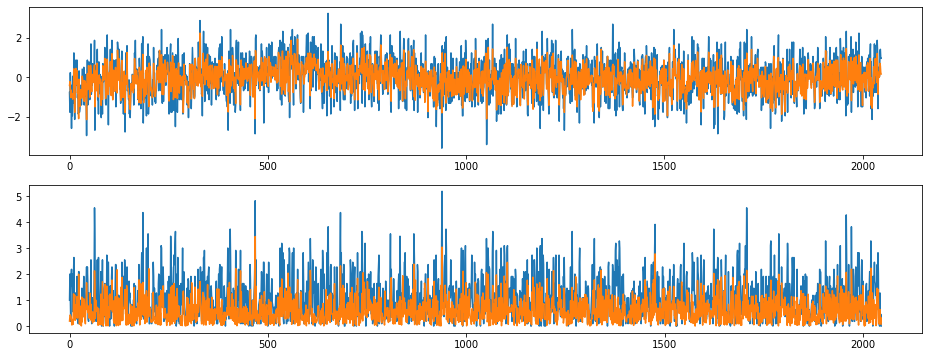

index:  3714
MAE:  0.4447650320700475
n_bunches       908
bunch_index     313
bunch_number    168
Name: 5176418, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6371/instability_data/06371_Inst_B1H_Q7_20171109_14h05m15s.h5


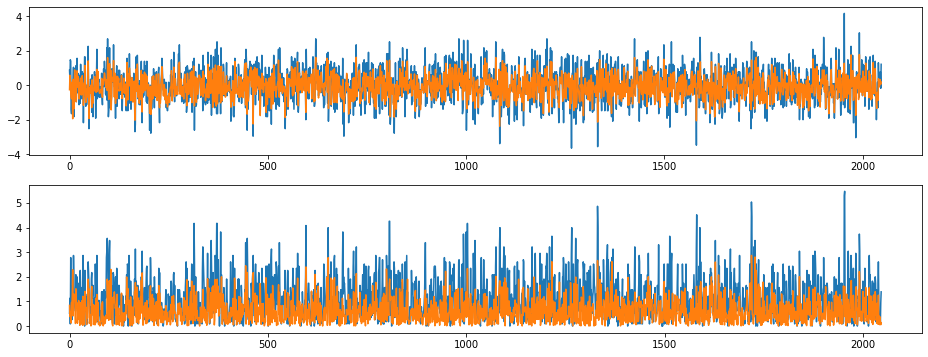

index:  134990
MAE:  0.44464672705525643
n_bunches       108
bunch_index      99
bunch_number     31
Name: 3132721, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6679/instability_data/06679_Inst_B1H_Q7_20180514_05h05m14s.h5


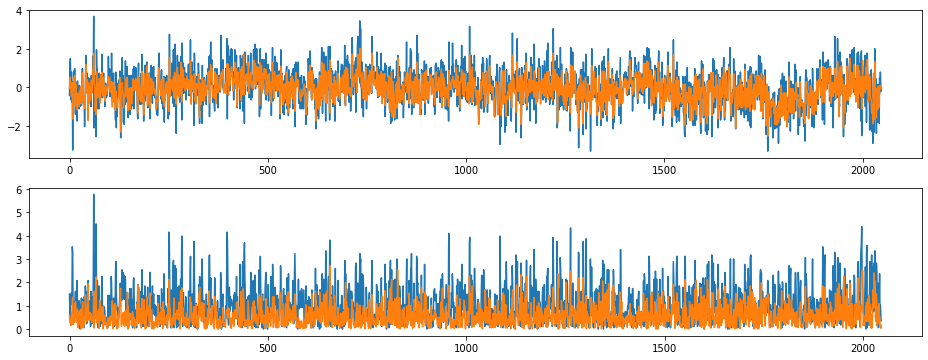

index:  147331
MAE:  0.4445588218721972
n_bunches       733
bunch_index     943
bunch_number    194
Name: 7026602, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7487/instability_data/07487_Inst_B1H_Q7_20181201_01h14m15s.h5


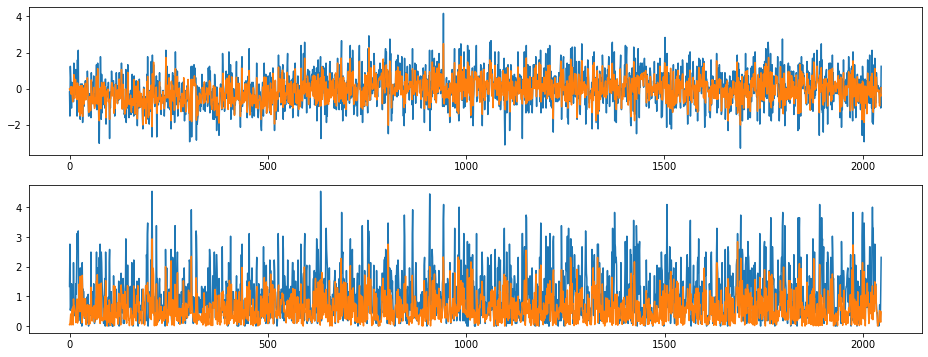

index:  408524
MAE:  0.44454939538042143
n_bunches       313
bunch_index     440
bunch_number     89
Name: 8640745, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7479/instability_data/07479_Inst_B1H_Q7_20181127_21h27m06s.h5


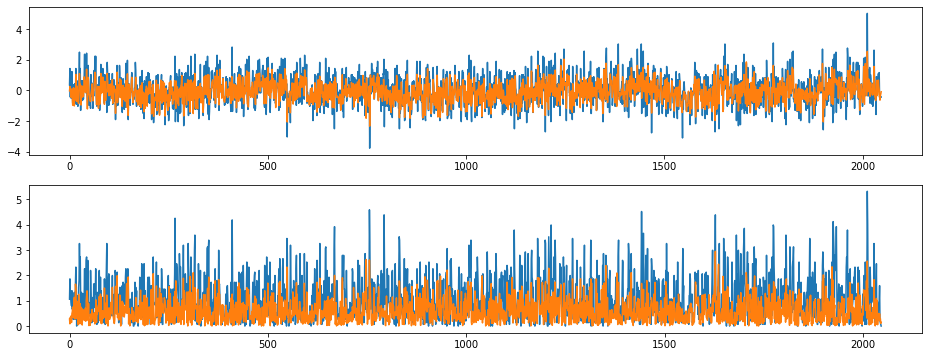

index:  129476
MAE:  0.44440484135928837
n_bunches        460
bunch_index     2437
bunch_number     316
Name: 2470355, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7464/instability_data/07464_Inst_B1H_Q7_20181122_04h05m14s.h5


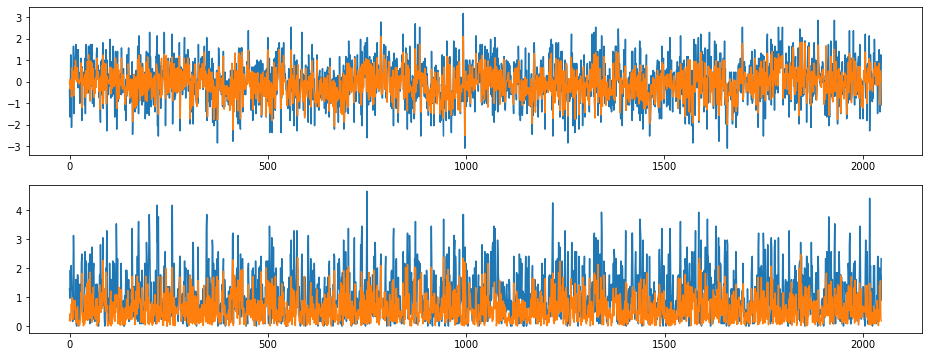

index:  370295
MAE:  0.4443498919036881
n_bunches       1916
bunch_index     2794
bunch_number    1542
Name: 3127565, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6253/instability_data/06253_Inst_B1H_Q7_20170929_00h13m14s.h5


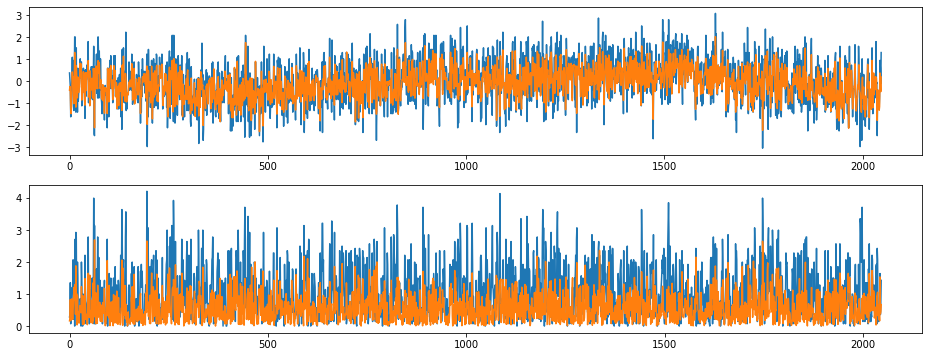

index:  34353
MAE:  0.4443250878305023
n_bunches       1452
bunch_index     2956
bunch_number    1254
Name: 2546488, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6890/instability_data/06890_Inst_B1H_Q7_20180705_18h46m14s.h5


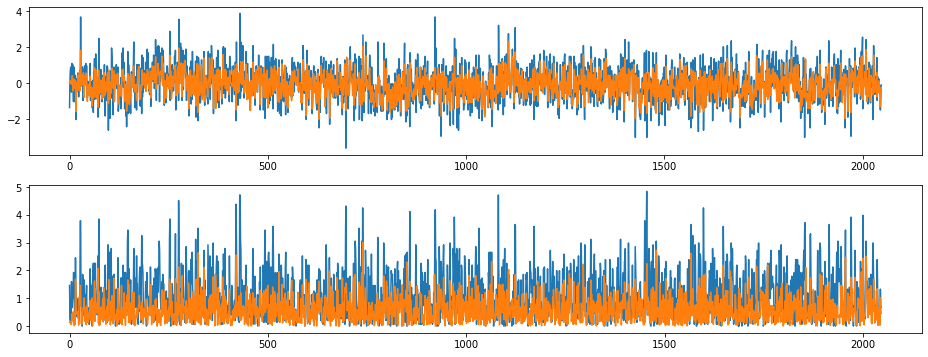

index:  7195
MAE:  0.4443027352354194
n_bunches        230
bunch_index     1142
bunch_number     154
Name: 1336877, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6594/instability_data/06594_Inst_B1H_Q7_20180422_08h31m36s.h5


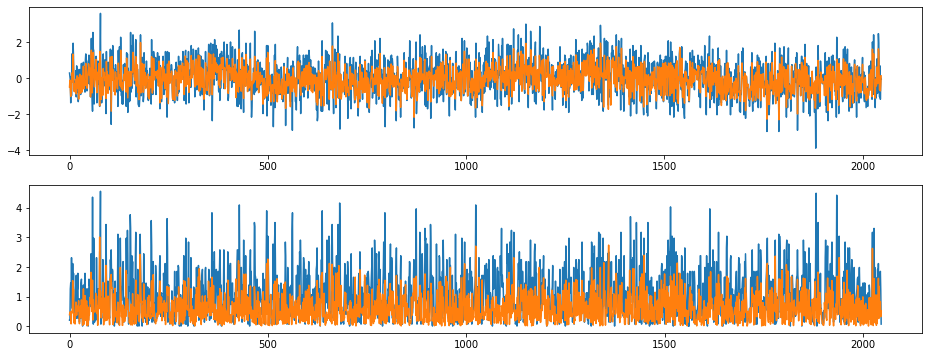

index:  308842
MAE:  0.4442569416577713
n_bunches        408
bunch_index     1394
bunch_number     259
Name: 10763492, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7450/instability_data/07450_Inst_B1H_Q7_20181117_03h27m32s.h5


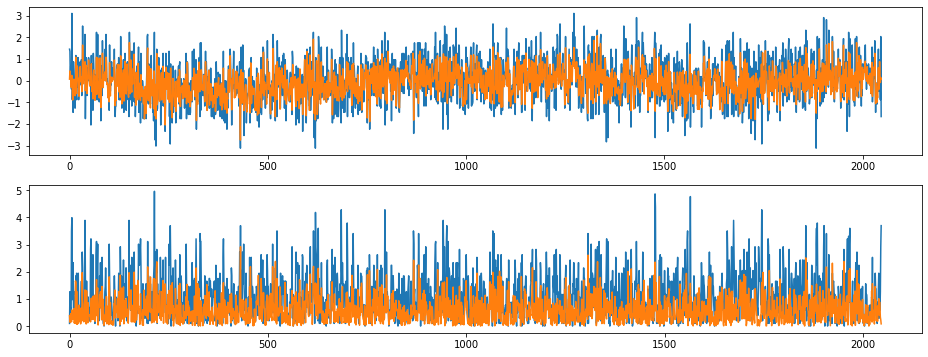

index:  7931
MAE:  0.44425438856195043
n_bunches       1227
bunch_index     3185
bunch_number    1137
Name: 8064464, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_09h24m13s.h5


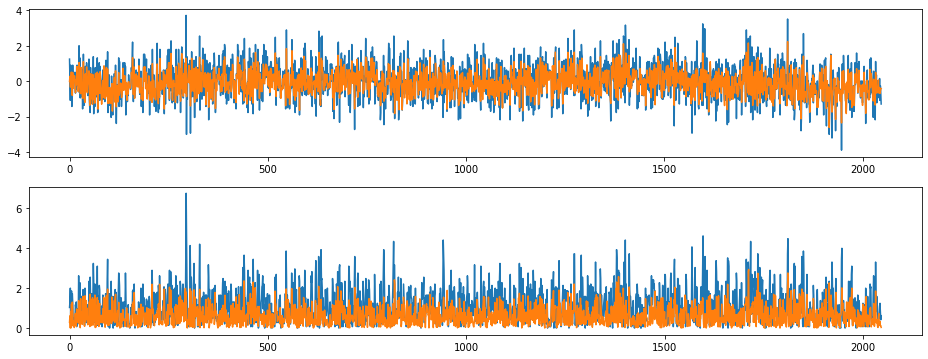

index:  298443
MAE:  0.44425293024107404
n_bunches       1068
bunch_index      348
bunch_number     247
Name: 1391793, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7108/instability_data/07108_Inst_B1H_Q7_20180831_04h54m56s.h5


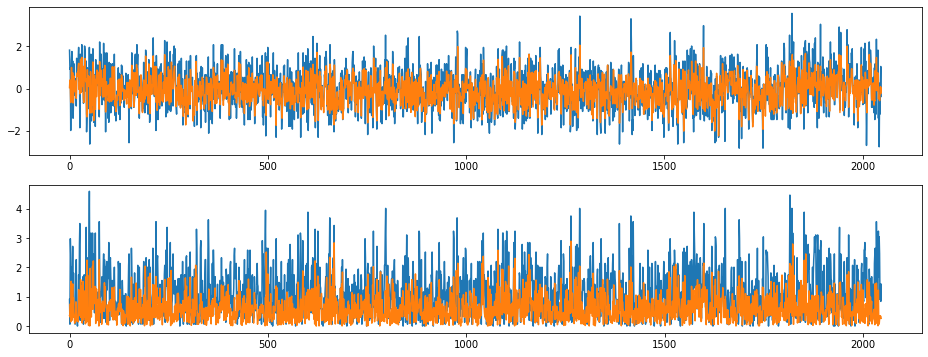

index:  323075
MAE:  0.4441073486360497
n_bunches       444
bunch_index     405
bunch_number    177
Name: 3890845, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6989/instability_data/06989_Inst_B1H_Q7_20180727_08h05m14s.h5


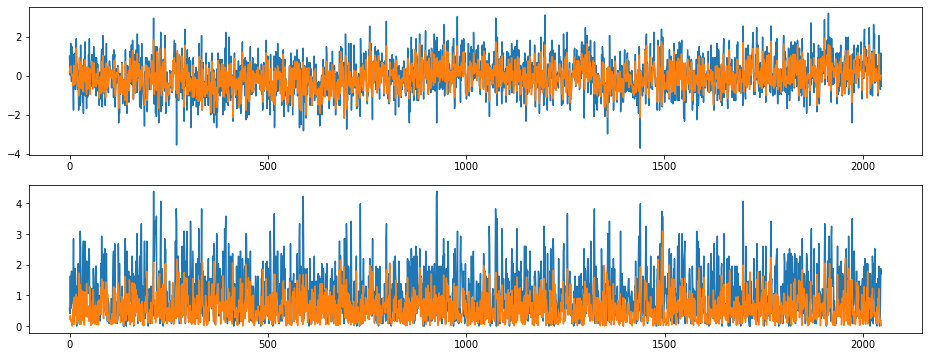

index:  117493
MAE:  0.4440795045149522
n_bunches        36
bunch_index     161
bunch_number     15
Name: 9049911, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7244/instability_data/07244_Inst_B1H_Q7_20181001_23h59m55s.h5


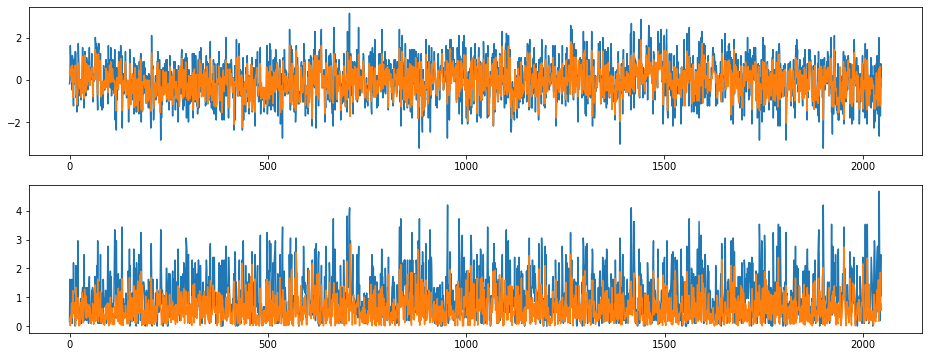

index:  293305
MAE:  0.4440366127123728
n_bunches       2556
bunch_index      827
bunch_number     594
Name: 2421716, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6921/instability_data/06921_Inst_B1H_Q7_20180714_16h39m14s.h5


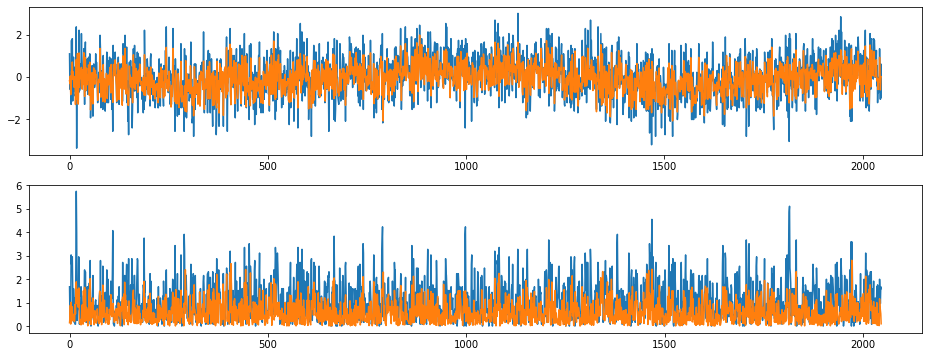

index:  215339
MAE:  0.444023697120032
n_bunches       972
bunch_index     337
bunch_number    230
Name: 7645303, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6900/instability_data/06900_Inst_B1H_Q7_20180708_01h58m56s.h5


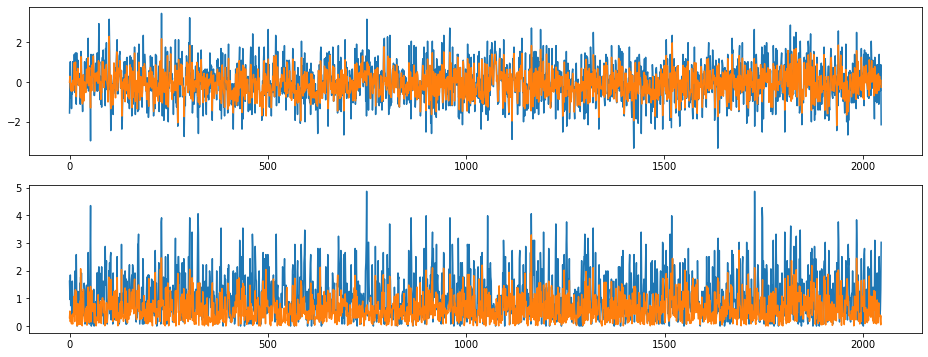

index:  1099
MAE:  0.44402311698843056
n_bunches       780
bunch_index     603
bunch_number    319
Name: 5110245, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6349/instability_data/06349_Inst_B1H_Q7_20171031_04h21m02s.h5


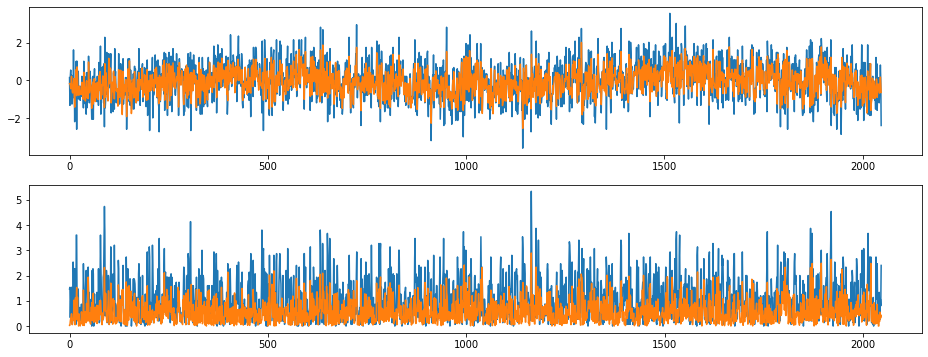

index:  34174
MAE:  0.4440078207747915
n_bunches        987
bunch_index     1995
bunch_number     537
Name: 8419471, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_11h17m14s.h5


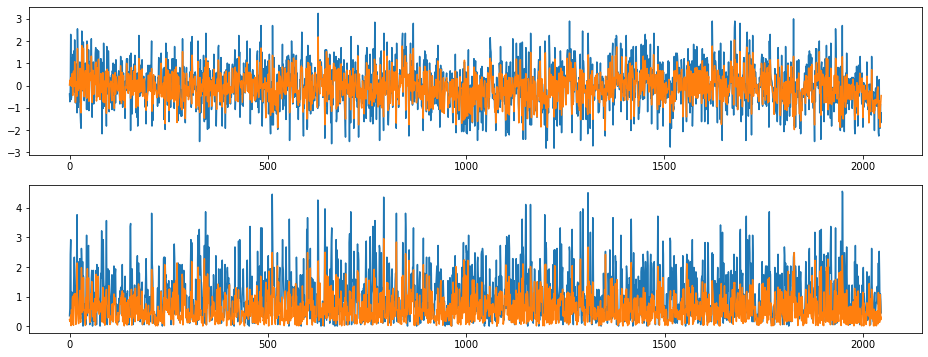

index:  91153
MAE:  0.4439965814465488
n_bunches       780
bunch_index     944
bunch_number    680
Name: 3823282, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7047/instability_data/07047_Inst_B1H_Q7_20180812_15h33m14s.h5


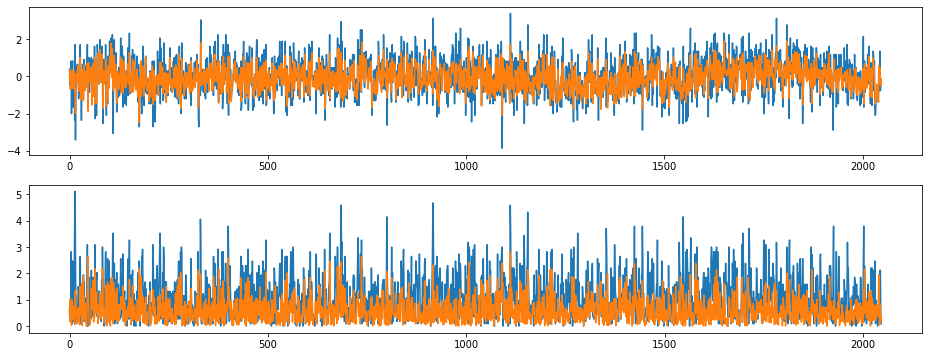

index:  121755
MAE:  0.44380765040611586
n_bunches       1227
bunch_index     1660
bunch_number     631
Name: 8290018, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_12h24m14s.h5


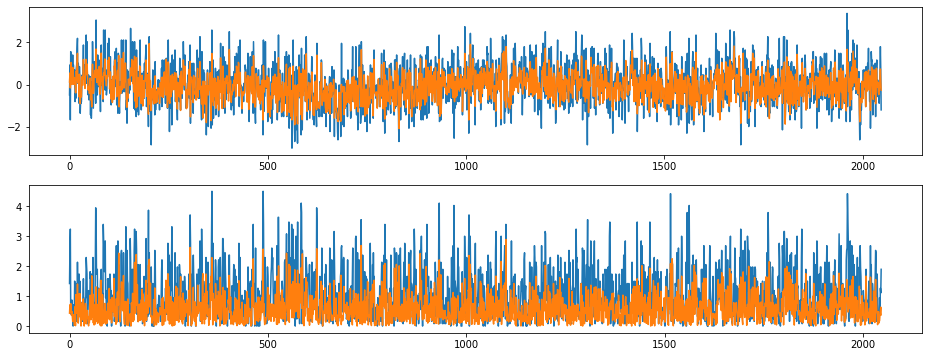

index:  60519
MAE:  0.4437551243515543
n_bunches       1212
bunch_index      302
bunch_number     189
Name: 8691822, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6733/instability_data/06733_Inst_B1H_Q7_20180528_04h28m48s.h5


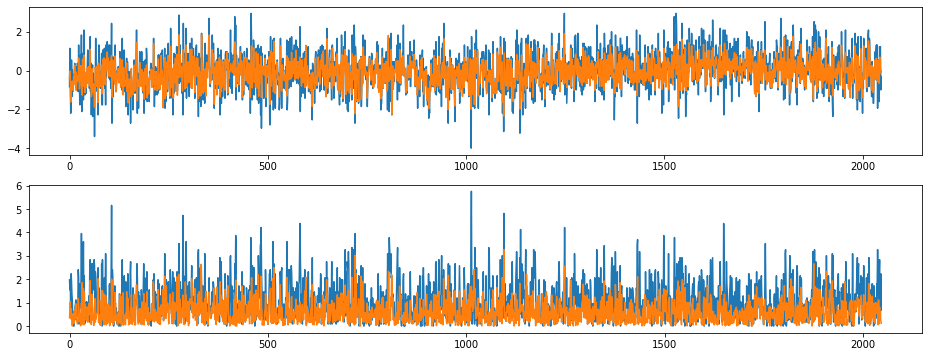

index:  320918
MAE:  0.44362588206117326
n_bunches        733
bunch_index     1164
bunch_number     243
Name: 7876870, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7491/instability_data/07491_Inst_B1H_Q7_20181202_12h55m14s.h5


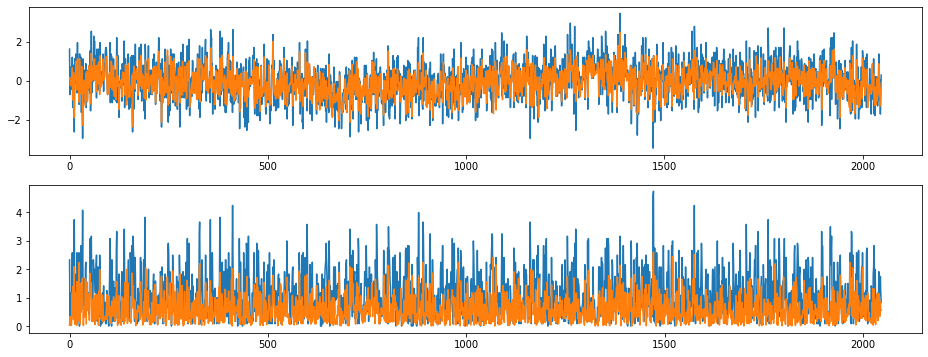

index:  1708
MAE:  0.44362559251081596
n_bunches       252
bunch_index      79
bunch_number     30
Name: 6241184, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6921/instability_data/06921_Inst_B1H_Q7_20180714_14h59m34s.h5


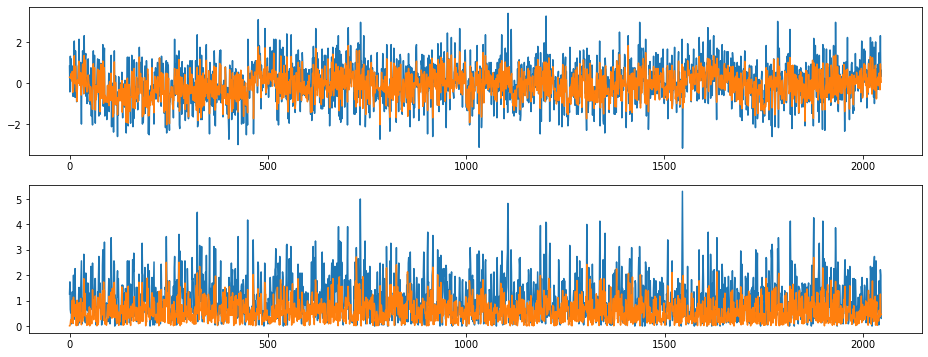

index:  218216
MAE:  0.44362334730136643
n_bunches       780
bunch_index     882
bunch_number    630
Name: 9848735, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6677/instability_data/06677_Inst_B1H_Q7_20180513_12h58m01s.h5


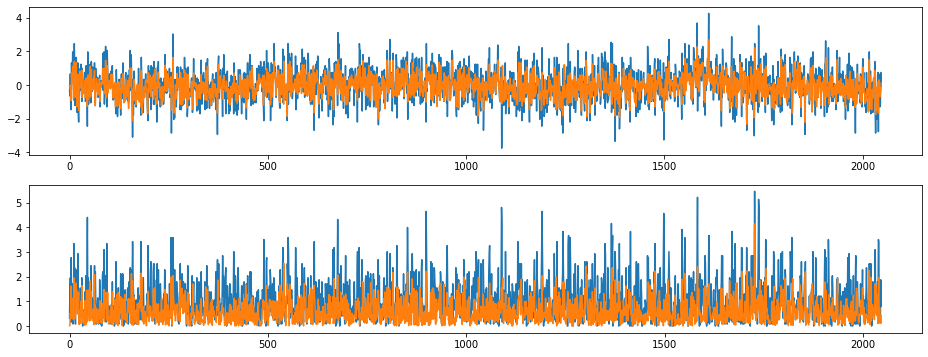

index:  54827
MAE:  0.44353642420480677
n_bunches       108
bunch_index     124
bunch_number     68
Name: 3060167, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6911/instability_data/06911_Inst_B1H_Q7_20180711_09h35m14s.h5


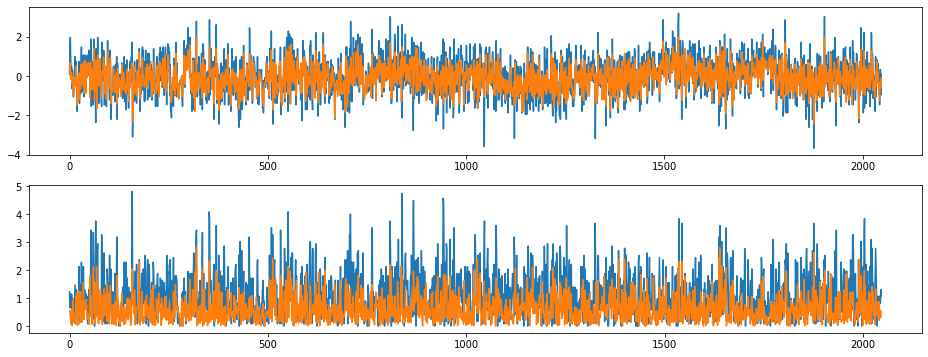

index:  143689
MAE:  0.4435015974871399
n_bunches       540
bunch_index     526
bunch_number    361
Name: 7140948, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6700/instability_data/06700_Inst_B1H_Q7_20180519_03h02m13s.h5


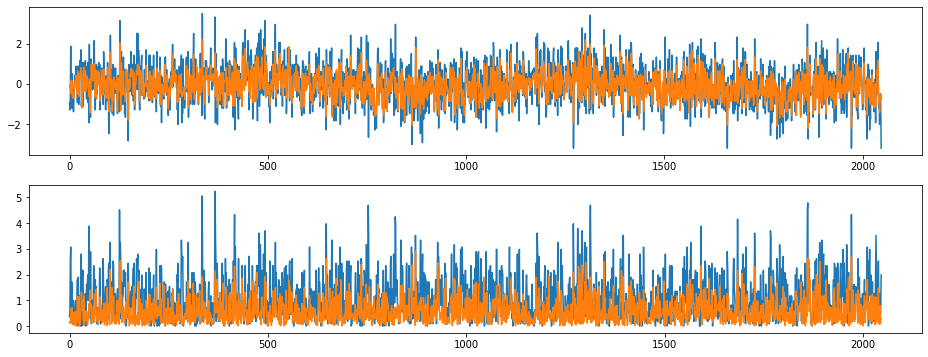

index:  61726
MAE:  0.4434958907470421
n_bunches       1956
bunch_index     1070
bunch_number     858
Name: 3448384, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6602/instability_data/06602_Inst_B1H_Q7_20180423_18h34m15s.h5


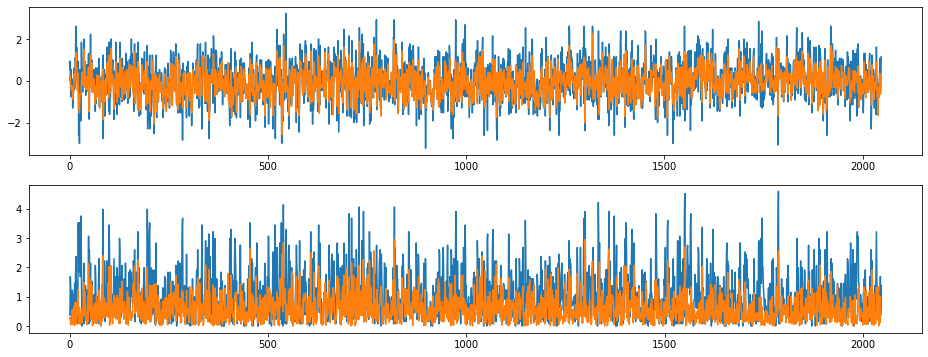

index:  320507
MAE:  0.4434229708443197
n_bunches       924
bunch_index     778
bunch_number    552
Name: 11089441, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7056/instability_data/07056_Inst_B1H_Q7_20180815_03h04m13s.h5


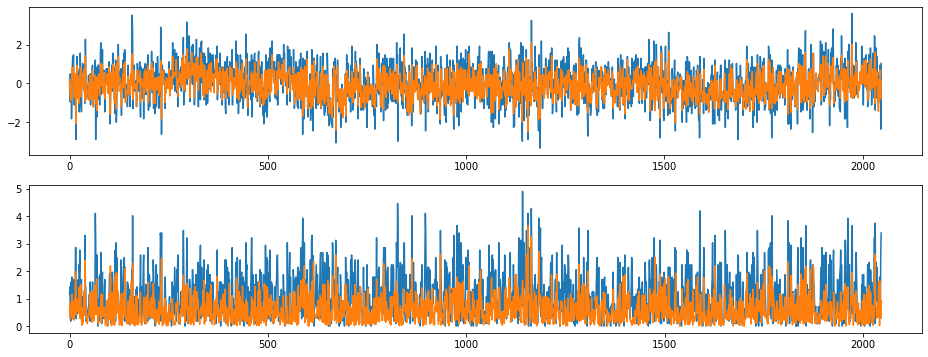

index:  99930
MAE:  0.44338898151682193
n_bunches       1212
bunch_index     1038
bunch_number     741
Name: 1470423, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6696/instability_data/06696_Inst_B1H_Q7_20180518_01h18m59s.h5


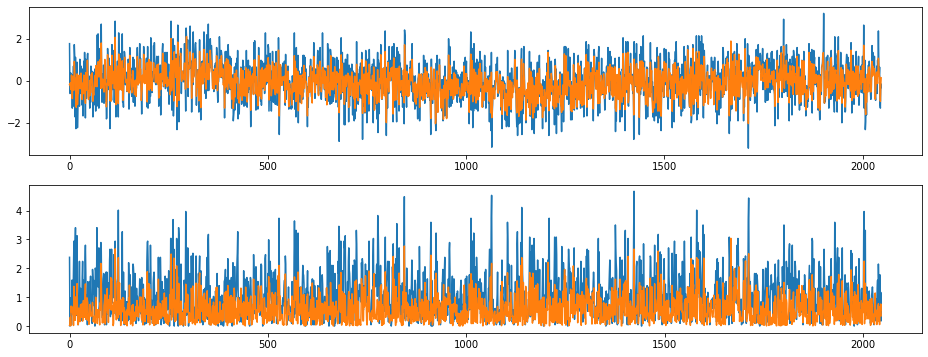

index:  14575
MAE:  0.44338060007511243
n_bunches        460
bunch_index     1498
bunch_number     313
Name: 1301032, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7491/instability_data/07491_Inst_B1H_Q7_20181202_07h52m47s.h5


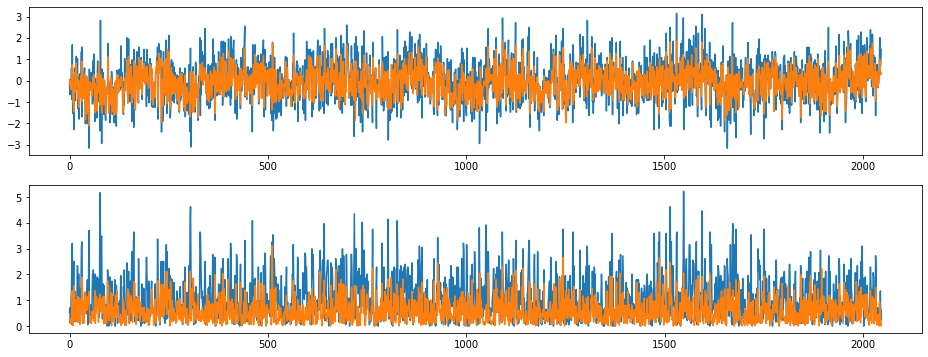

index:  53359
MAE:  0.4433724372082736
n_bunches        75
bunch_index     298
bunch_number     12
Name: 11077089, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6583/instability_data/06583_Inst_B1H_Q7_20180420_19h05m14s.h5


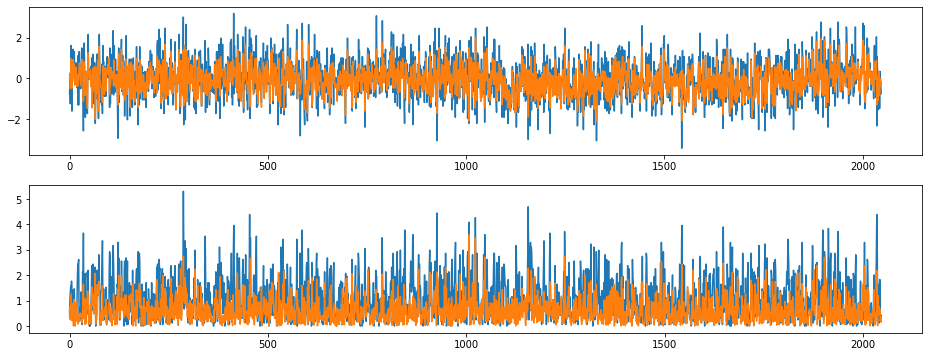

index:  235934
MAE:  0.4430237940578457
n_bunches       1308
bunch_index      394
bunch_number     262
Name: 1572201, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7069/instability_data/07069_Inst_B1H_Q7_20180820_02h28m06s.h5


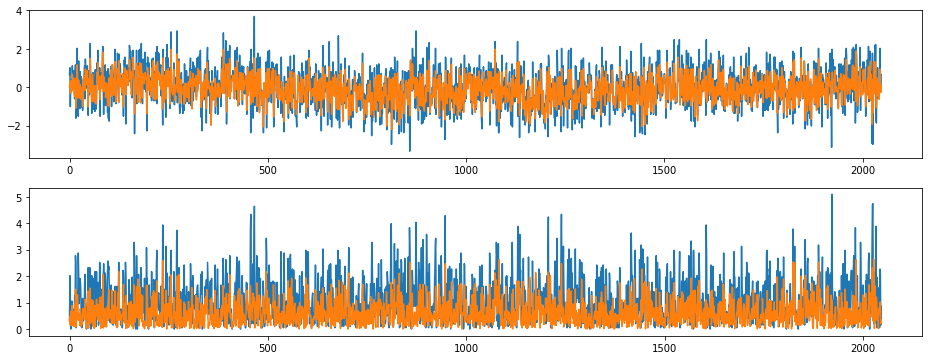

index:  299997
MAE:  0.44292948038011126
n_bunches       2556
bunch_index     3087
bunch_number    2289
Name: 3048371, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7035/instability_data/07035_Inst_B1H_Q7_20180807_18h17m14s.h5


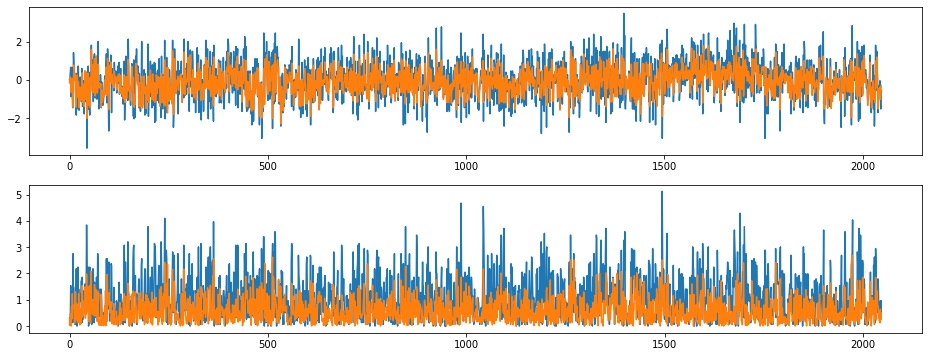

index:  60914
MAE:  0.44291583101623955
n_bunches       524
bunch_index     406
bunch_number    186
Name: 6337045, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6398/instability_data/06398_Inst_B1H_Q7_20171119_21h07m40s.h5


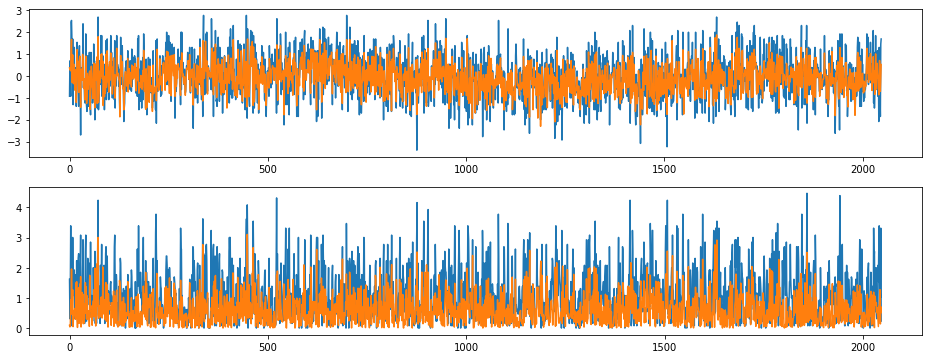

index:  347775
MAE:  0.44291131497768443
n_bunches       1868
bunch_index     1300
bunch_number     699
Name: 649934, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6279/instability_data/06279_Inst_B1H_Q7_20171007_09h22m14s.h5


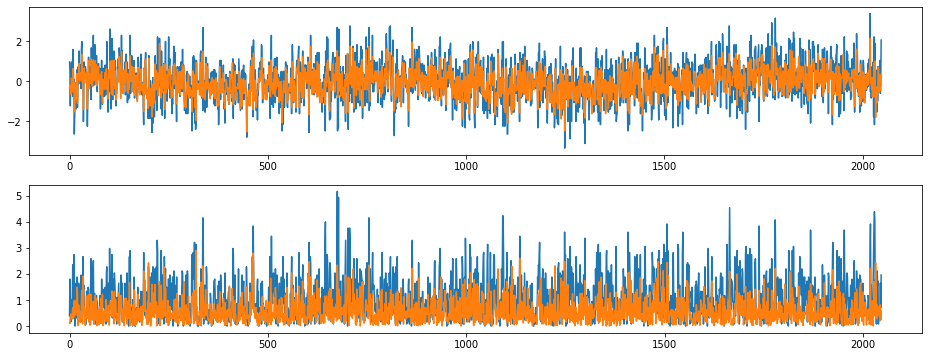

index:  335902
MAE:  0.4428969033574655
n_bunches       636
bunch_index     822
bunch_number    589
Name: 8187618, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7039/instability_data/07039_Inst_B1H_Q7_20180809_03h59m59s.h5


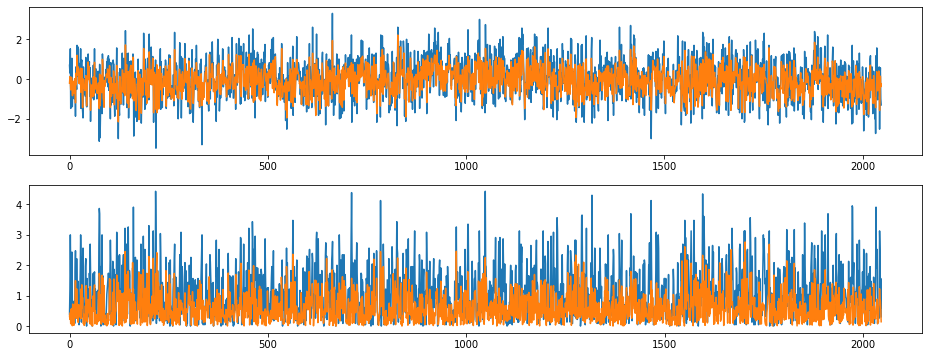

index:  190347
MAE:  0.4428649292613959
n_bunches        780
bunch_index     1172
bunch_number     633
Name: 1184685, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6349/instability_data/06349_Inst_B1H_Q7_20171031_04h20m14s.h5


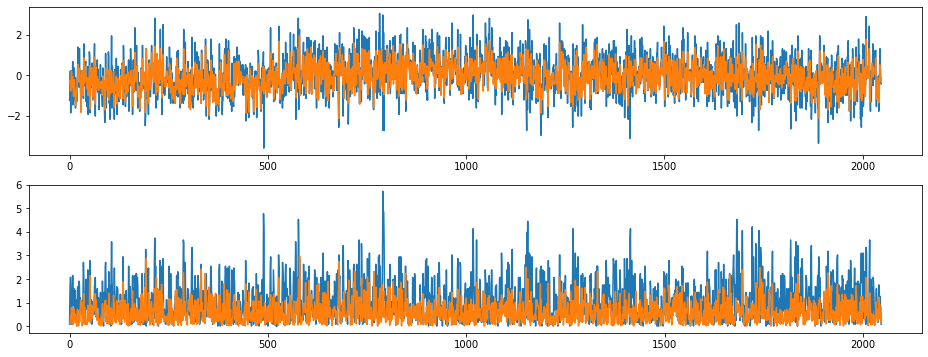

index:  359207
MAE:  0.4428056519777818
n_bunches       2556
bunch_index     2110
bunch_number    1565
Name: 6867040, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7135/instability_data/07135_Inst_B1H_Q7_20180907_23h18m14s.h5


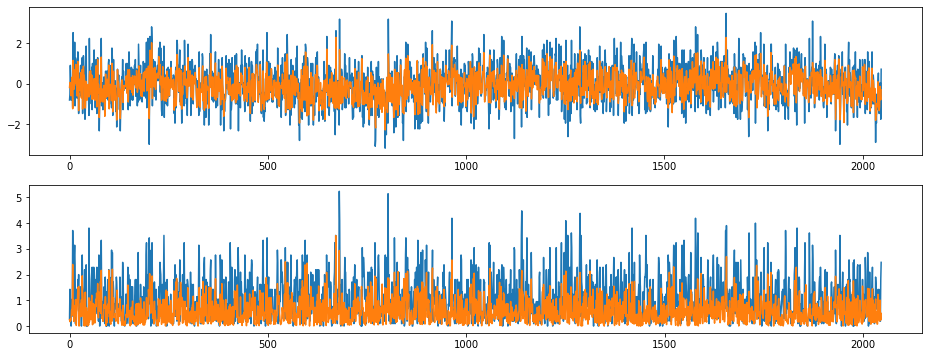

index:  301232
MAE:  0.4427796184150775
n_bunches        782
bunch_index     1112
bunch_number     489
Name: 860543, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6692/instability_data/06692_Inst_B1H_Q7_20180516_17h53m31s.h5


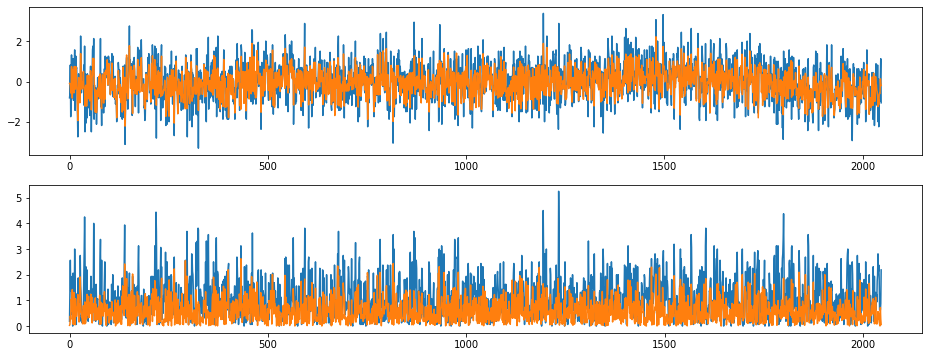

index:  39839
MAE:  0.44274866763517323
n_bunches       733
bunch_index     524
bunch_number    110
Name: 11602728, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7489/instability_data/07489_Inst_B1H_Q7_20181201_18h12m14s.h5


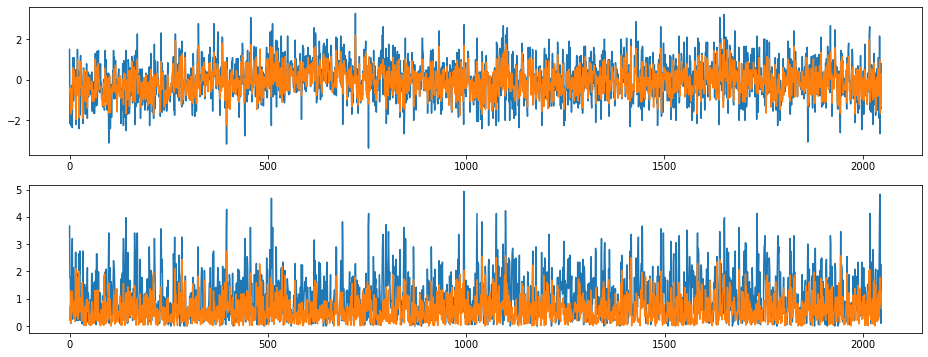

index:  217071
MAE:  0.4427422524653801
n_bunches       780
bunch_index     502
bunch_number    356
Name: 10536805, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7131/instability_data/07131_Inst_B1H_Q7_20180906_14h37m25s.h5


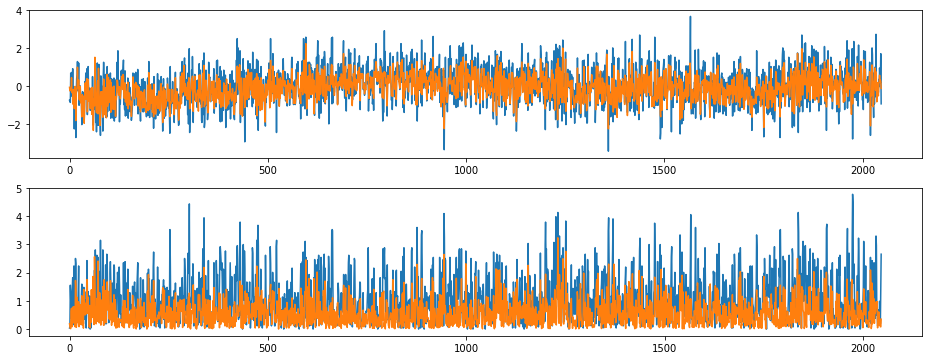

index:  188167
MAE:  0.44273874859153295
n_bunches       1548
bunch_index     1980
bunch_number     838
Name: 11514968, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6399/instability_data/06399_Inst_B1H_Q7_20171121_05h12m14s.h5


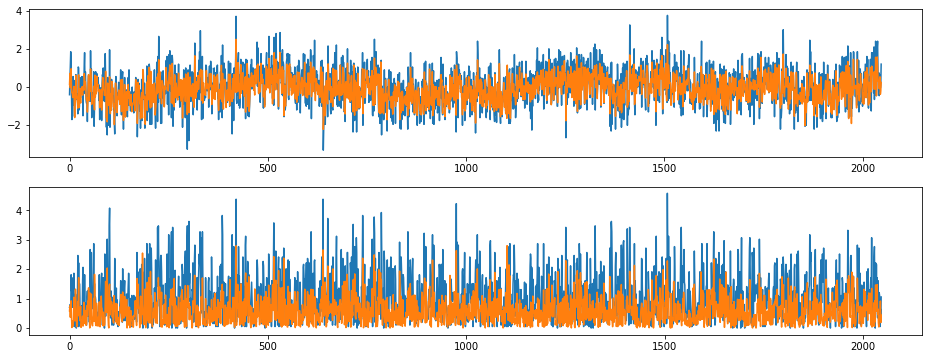

index:  183305
MAE:  0.4427011620484671
n_bunches        733
bunch_index     3391
bunch_number     719
Name: 2114853, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h44m15s.h5


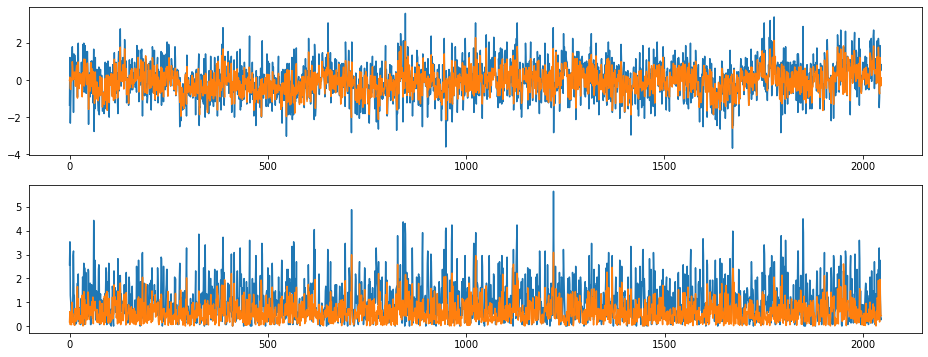

index:  109345
MAE:  0.442685234746503
n_bunches       313
bunch_index     513
bunch_number    232
Name: 11706238, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6620/instability_data/06620_Inst_B1H_Q7_20180428_20h27m11s.h5


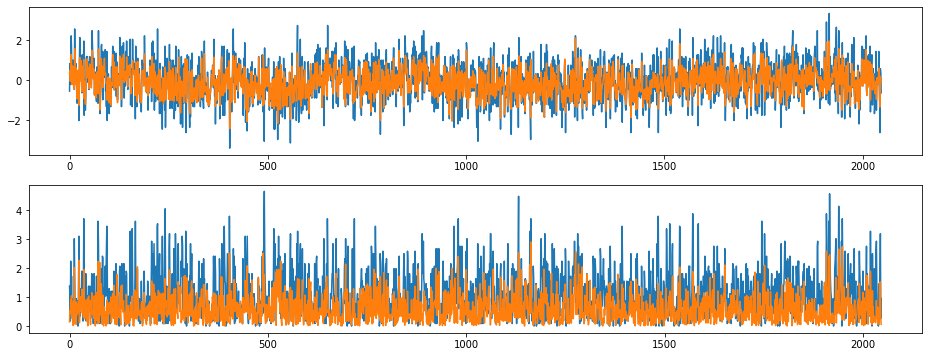

index:  349784
MAE:  0.44258164694257124
n_bunches       540
bunch_index     687
bunch_number    126
Name: 1192346, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7449/instability_data/07449_Inst_B1H_Q7_20181116_17h44m32s.h5


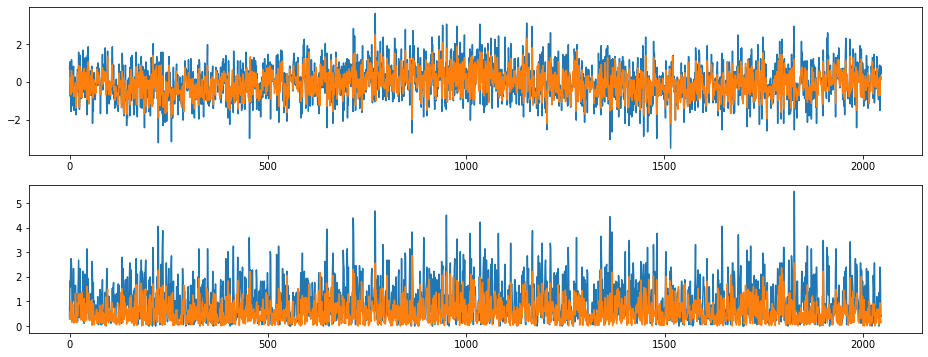

index:  354937
MAE:  0.44255944496191524
n_bunches        303
bunch_index     2741
bunch_number     275
Name: 6919157, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6594/instability_data/06594_Inst_B1H_Q7_20180422_08h40m17s.h5


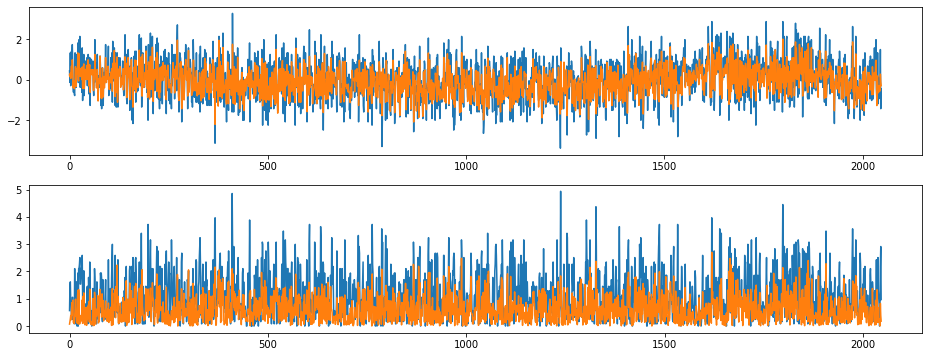

index:  122690
MAE:  0.442524648132259
n_bunches       2556
bunch_index     1299
bunch_number     945
Name: 766918, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6953/instability_data/06953_Inst_B1H_Q7_20180721_06h29m24s.h5


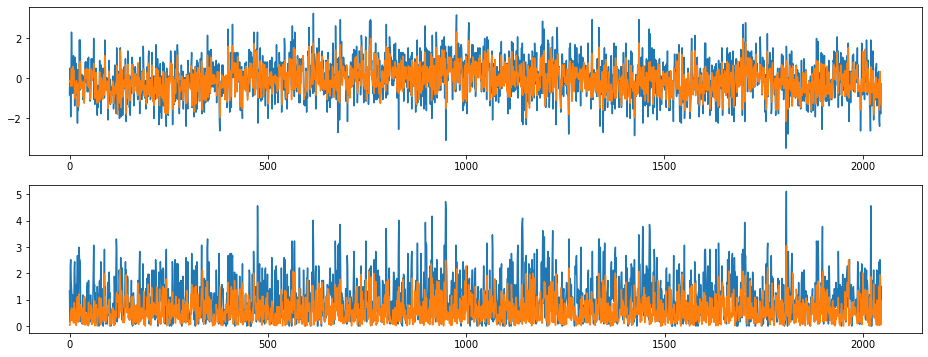

index:  350284
MAE:  0.44250060058343077
n_bunches       540
bunch_index      72
bunch_number     23
Name: 274515, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7240/instability_data/07240_Inst_B1H_Q7_20180930_20h43m47s.h5


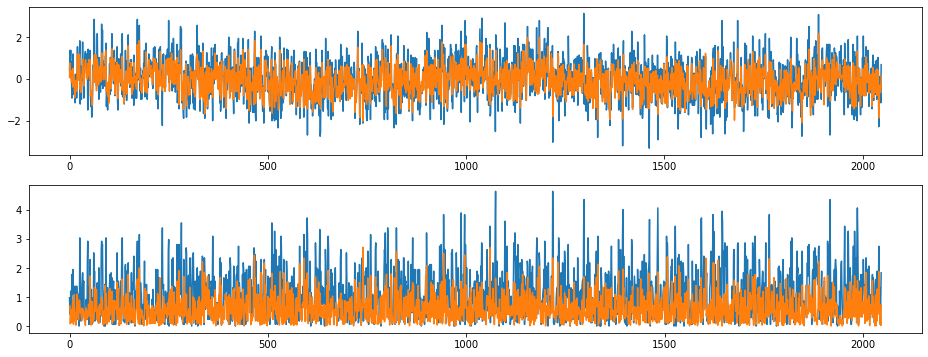

index:  127879
MAE:  0.4424481276859409
n_bunches        670
bunch_index     3295
bunch_number     632
Name: 9706961, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7466/instability_data/07466_Inst_B1H_Q7_20181122_19h16m16s.h5


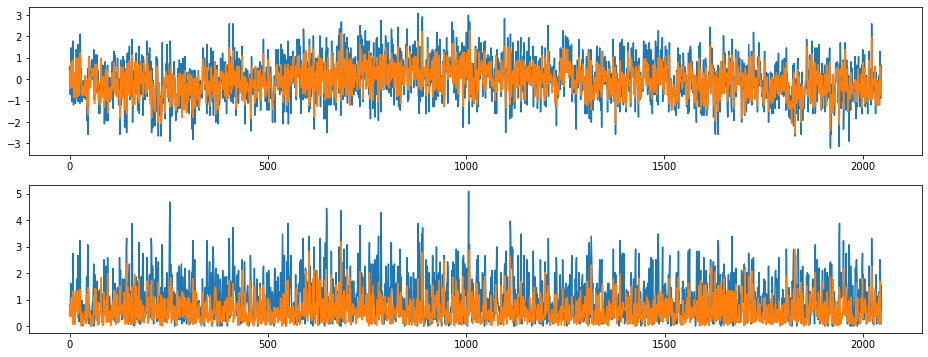

index:  5613
MAE:  0.4424409618439754
n_bunches       252
bunch_index     156
bunch_number     81
Name: 2014754, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6729/instability_data/06729_Inst_B1H_Q7_20180526_15h14m35s.h5


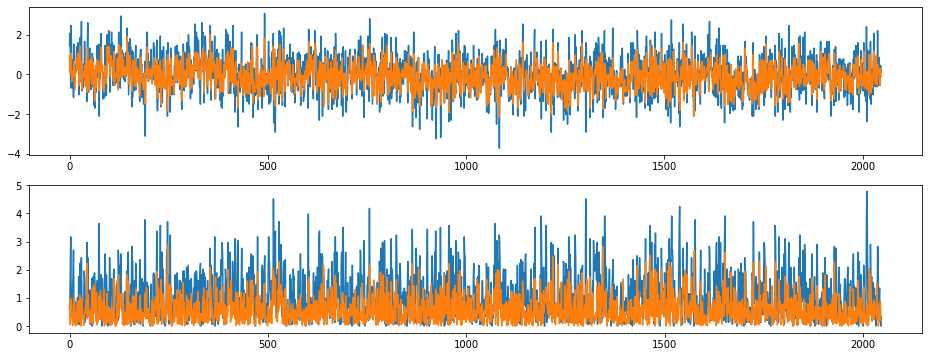

index:  165187
MAE:  0.44238285300439806
n_bunches       924
bunch_index     428
bunch_number    296
Name: 5331640, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7139/instability_data/07139_Inst_B1H_Q7_20180908_18h16m23s.h5


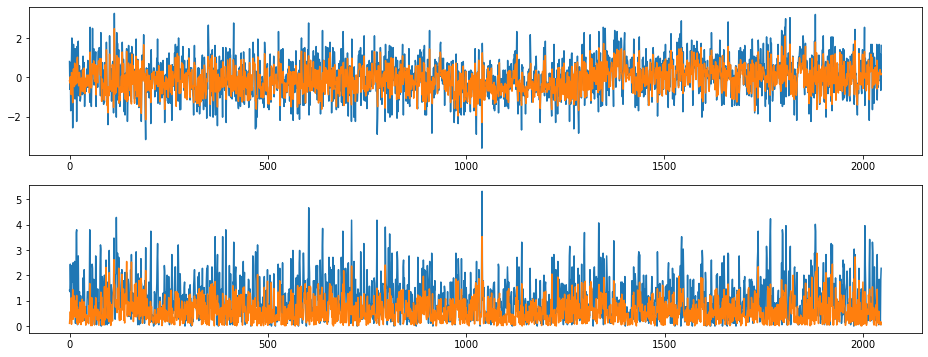

index:  350704
MAE:  0.4423742651450986
n_bunches       173
bunch_index     365
bunch_number    155
Name: 11573582, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6431/instability_data/06431_Inst_B1H_Q7_20171128_16h05m14s.h5


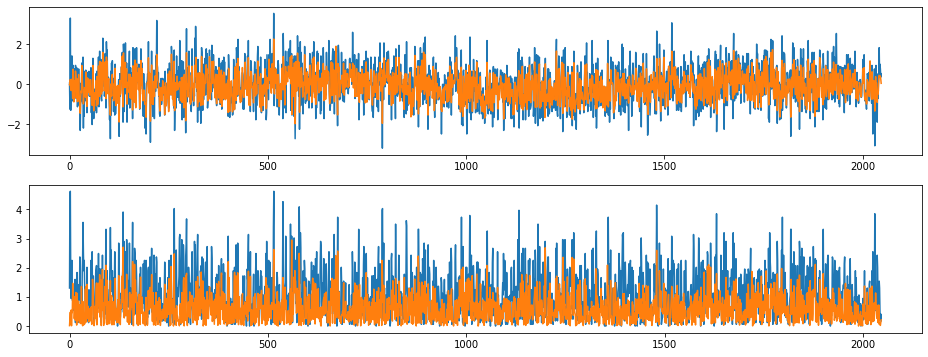

index:  235100
MAE:  0.4423639068669707
n_bunches       1868
bunch_index     2242
bunch_number    1208
Name: 9339083, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6348/instability_data/06348_Inst_B1H_Q7_20171030_21h15m45s.h5


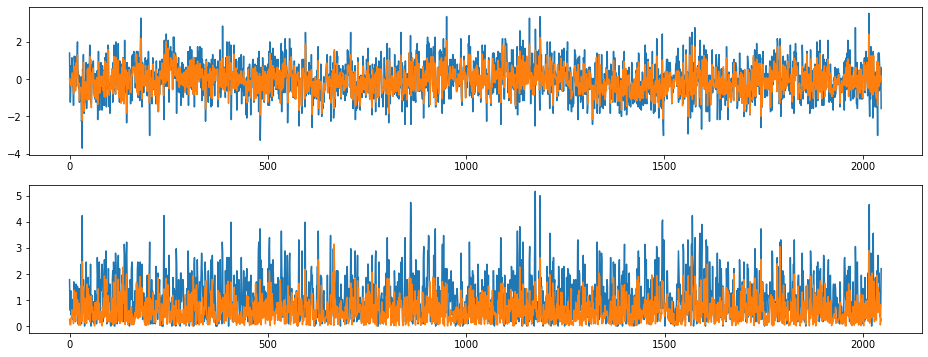

index:  373126
MAE:  0.44235057200678185
n_bunches       444
bunch_index     405
bunch_number    291
Name: 3132283, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6898/instability_data/06898_Inst_B1H_Q7_20180708_00h50m20s.h5


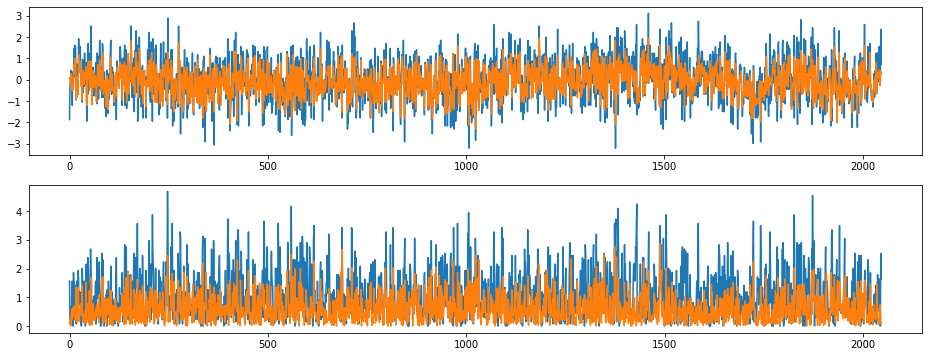

index:  337073
MAE:  0.4423359770197418
n_bunches       924
bunch_index     828
bunch_number    595
Name: 7668624, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6927/instability_data/06927_Inst_B1H_Q7_20180715_23h25m40s.h5


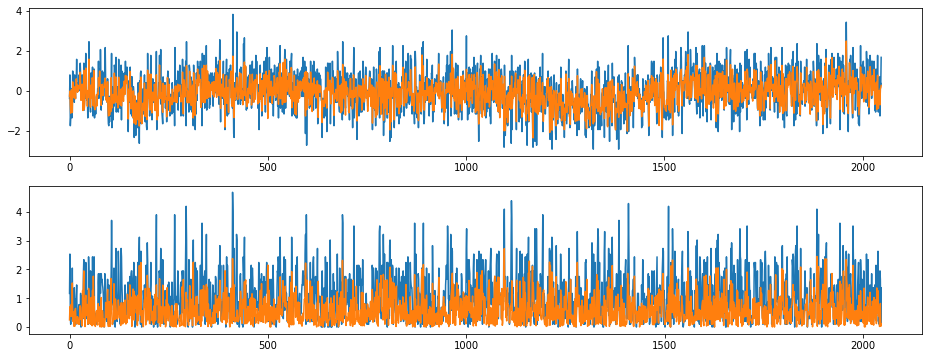

index:  120469
MAE:  0.44233457962132755
n_bunches       1068
bunch_index      316
bunch_number     215
Name: 11570278, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7133/instability_data/07133_Inst_B1H_Q7_20180907_12h10m15s.h5


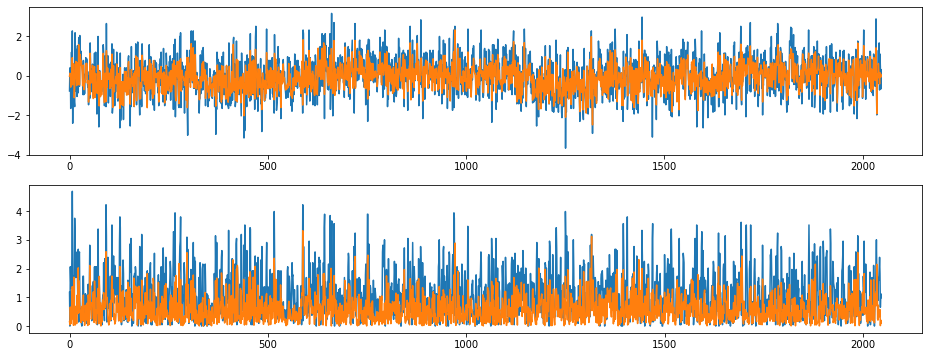

index:  104368
MAE:  0.4423016440731973
n_bunches        408
bunch_index     2205
bunch_number     347
Name: 7989212, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6436/instability_data/06436_Inst_B1H_Q7_20171130_05h55m57s.h5


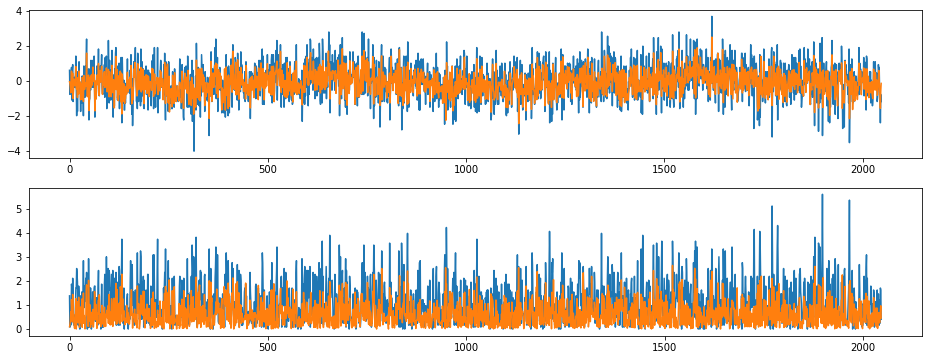

index:  382852
MAE:  0.44227586295254395
n_bunches        987
bunch_index     1977
bunch_number     519
Name: 4205124, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6688/instability_data/06688_Inst_B1H_Q7_20180515_20h10m14s.h5


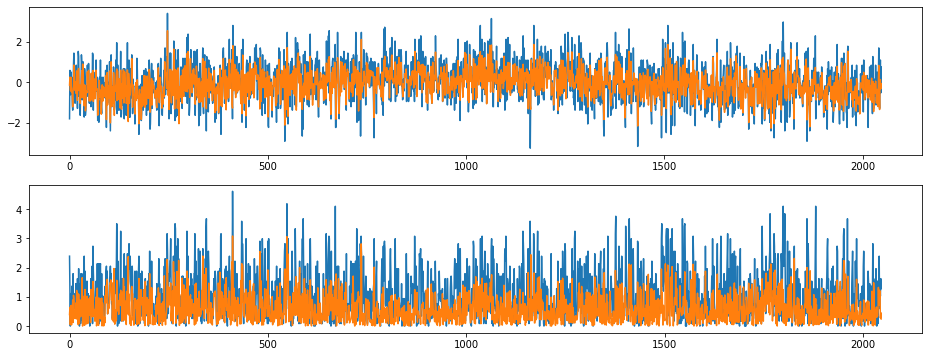

index:  129444
MAE:  0.44227375402867897
n_bunches        603
bunch_index     1327
bunch_number     284
Name: 11244886, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6850/instability_data/06850_Inst_B1H_Q7_20180626_20h20m07s.h5


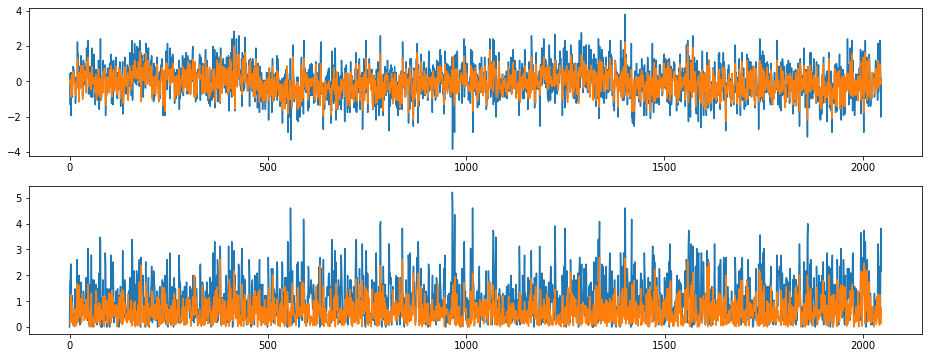

index:  380428
MAE:  0.4422725018103692
n_bunches       2556
bunch_index     2672
bunch_number    1976
Name: 1581652, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6709/instability_data/06709_Inst_B1H_Q7_20180521_01h31m14s.h5


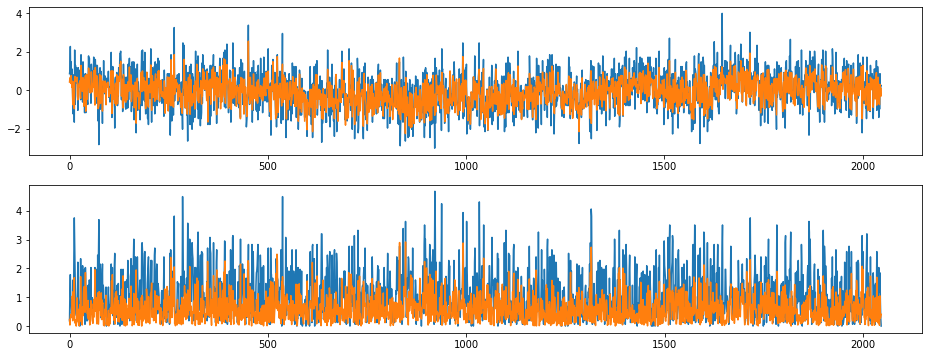

index:  4688
MAE:  0.4422672983878119
n_bunches       157
bunch_index     325
bunch_number    103
Name: 4038875, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6799/instability_data/06799_Inst_B1H_Q7_20180615_09h32m14s.h5


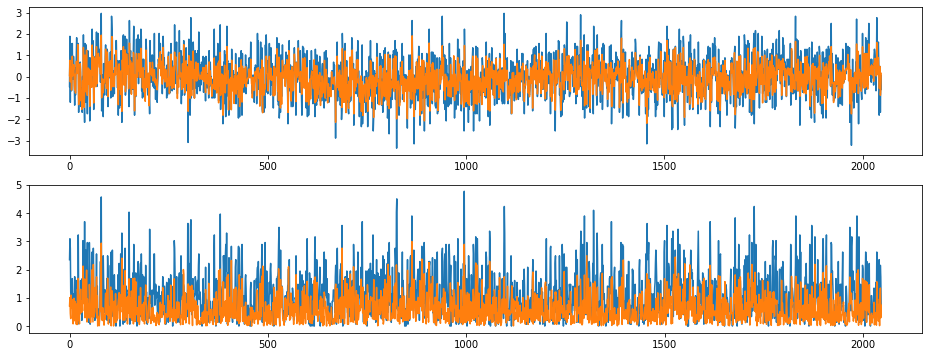

index:  323428
MAE:  0.4422440033038798
n_bunches        460
bunch_index     3292
bunch_number     421
Name: 9172887, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7464/instability_data/07464_Inst_B1H_Q7_20181122_05h08m14s.h5


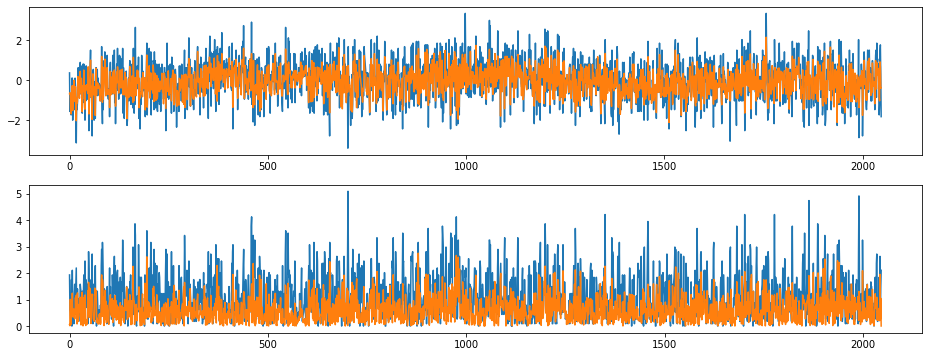

index:  2887
MAE:  0.44218950181898187
n_bunches       1868
bunch_index     2193
bunch_number    1178
Name: 3300645, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6337/instability_data/06337_Inst_B1H_Q7_20171027_12h00m14s.h5


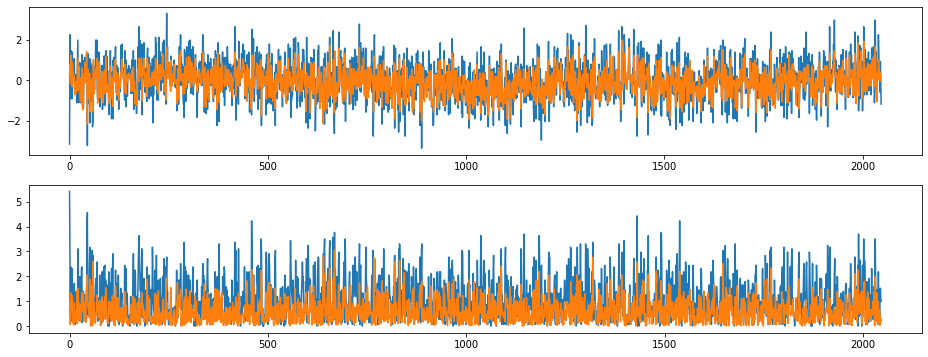

index:  217860
MAE:  0.44216232087963003
n_bunches       2556
bunch_index      635
bunch_number     451
Name: 3187850, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6923/instability_data/06923_Inst_B1H_Q7_20180714_20h48m13s.h5


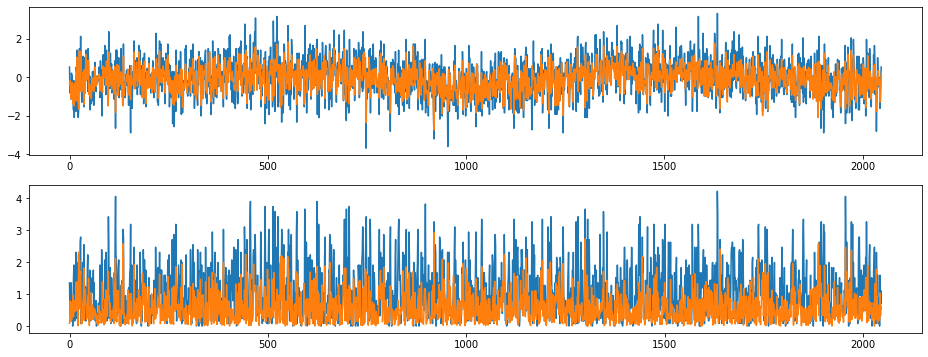

index:  18384
MAE:  0.44215237129128737
n_bunches        924
bunch_index     1116
bunch_number     807
Name: 1341217, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6957/instability_data/06957_Inst_B1H_Q7_20180721_22h31m51s.h5


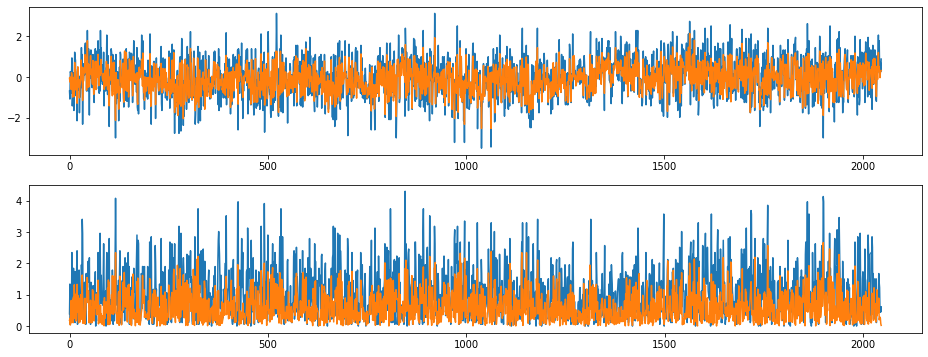

index:  147018
MAE:  0.44213197010186844
n_bunches       1916
bunch_index     2472
bunch_number    1368
Name: 725244, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6255/instability_data/06255_Inst_B1H_Q7_20170929_19h07m15s.h5


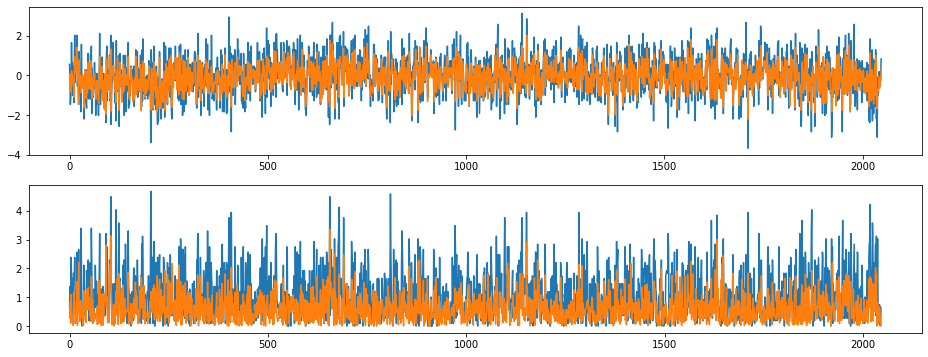

index:  307296
MAE:  0.44212068855552283
n_bunches       516
bunch_index     625
bunch_number    510
Name: 7918031, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6602/instability_data/06602_Inst_B1H_Q7_20180423_17h05m20s.h5


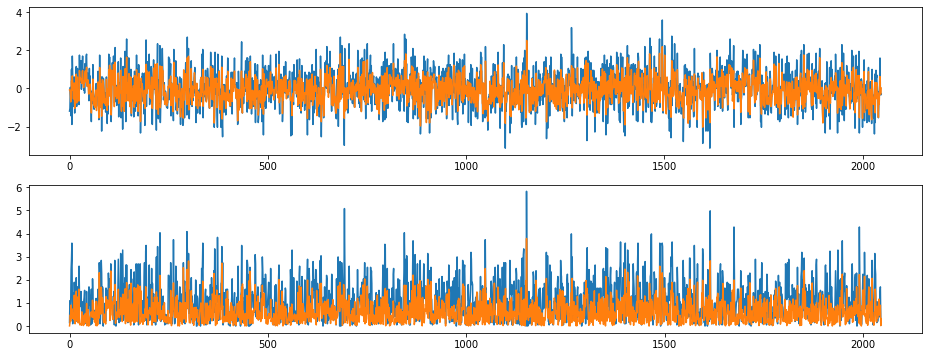

index:  105914
MAE:  0.4421108031638489
n_bunches       2556
bunch_index     3423
bunch_number    2547
Name: 3330203, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6700/instability_data/06700_Inst_B1H_Q7_20180519_11h23m14s.h5


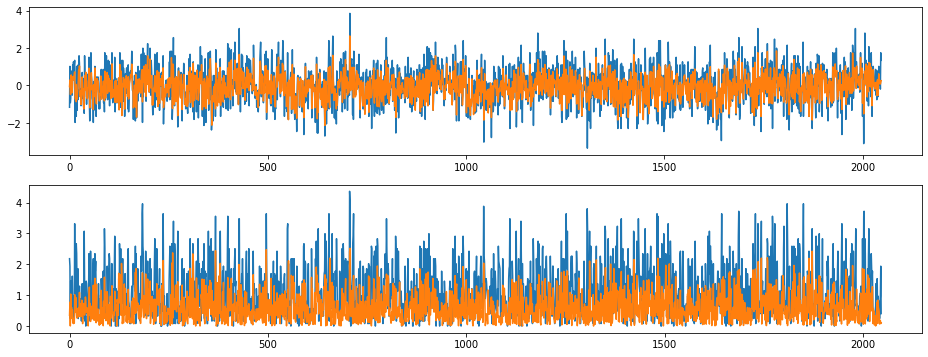

index:  260995
MAE:  0.4420721949674026
n_bunches       540
bunch_index     683
bunch_number    492
Name: 9272039, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7047/instability_data/07047_Inst_B1H_Q7_20180812_15h31m14s.h5


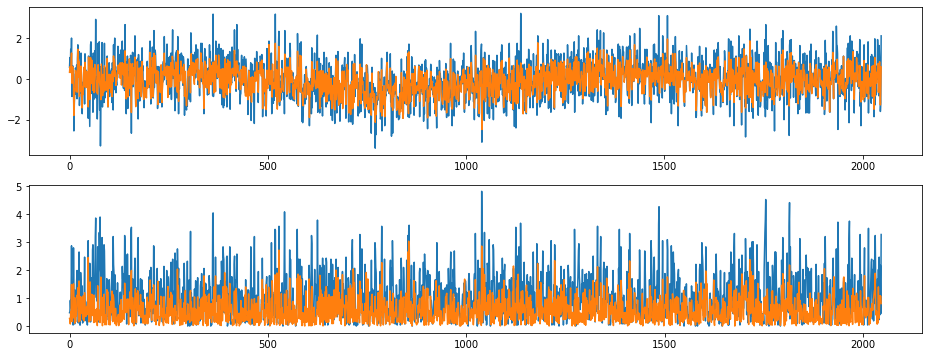

index:  309014
MAE:  0.44206629421288157
n_bunches        372
bunch_index     1412
bunch_number     263
Name: 1860208, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7483/instability_data/07483_Inst_B1H_Q7_20181129_01h25m14s.h5


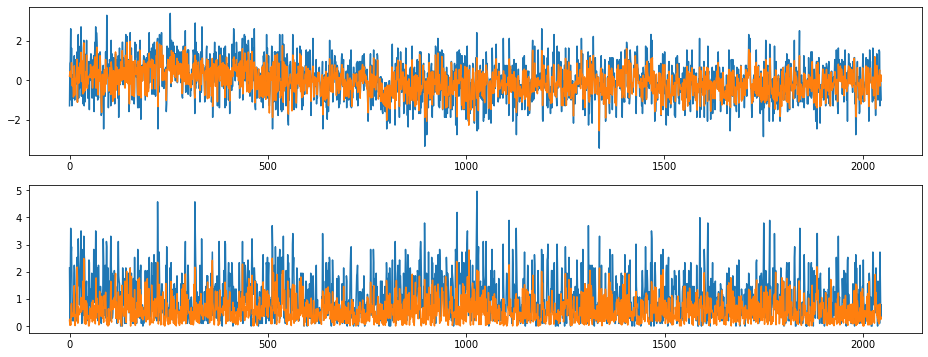

index:  320345
MAE:  0.4420111002864898
n_bunches       1452
bunch_index     2176
bunch_number     915
Name: 3403443, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6892/instability_data/06892_Inst_B1H_Q7_20180707_10h57m15s.h5


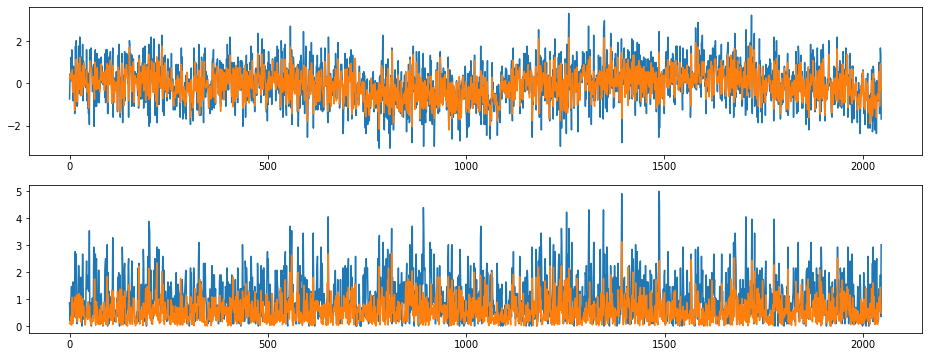

index:  49913
MAE:  0.4420106390828571
n_bunches       396
bunch_index     410
bunch_number    278
Name: 10587704, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7235/instability_data/07235_Inst_B1H_Q7_20180929_17h11m35s.h5


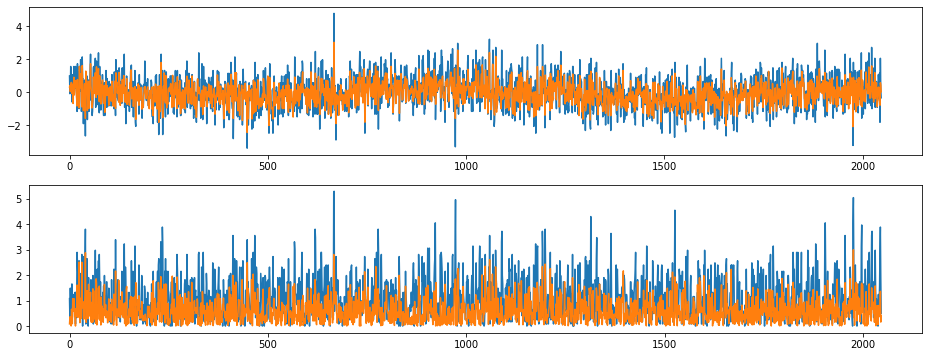

index:  34264
MAE:  0.44199403594434433
n_bunches        987
bunch_index     1464
bunch_number     475
Name: 9696070, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6688/instability_data/06688_Inst_B1H_Q7_20180515_21h30m14s.h5


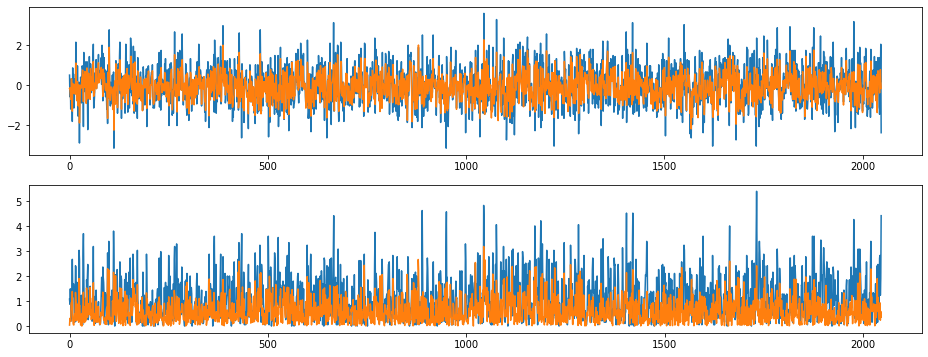

index:  282719
MAE:  0.44199121557147375
n_bunches       158
bunch_index     206
bunch_number     20
Name: 1085303, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7169/instability_data/07169_Inst_B1H_Q7_20180914_09h38m14s.h5


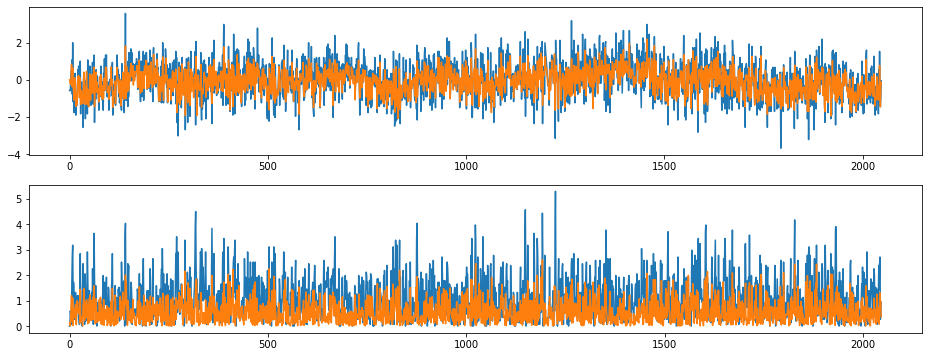

index:  295926
MAE:  0.44197883005616423
n_bunches        607
bunch_index     2624
bunch_number     553
Name: 3998619, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7485/instability_data/07485_Inst_B1H_Q7_20181129_20h38m18s.h5


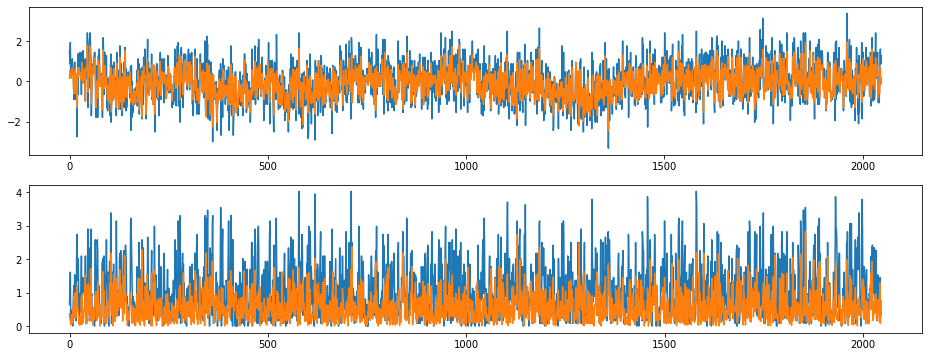

index:  297587
MAE:  0.4419104304008451
n_bunches       1868
bunch_index     1236
bunch_number     658
Name: 11650978, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6347/instability_data/06347_Inst_B1H_Q7_20171030_14h10m15s.h5


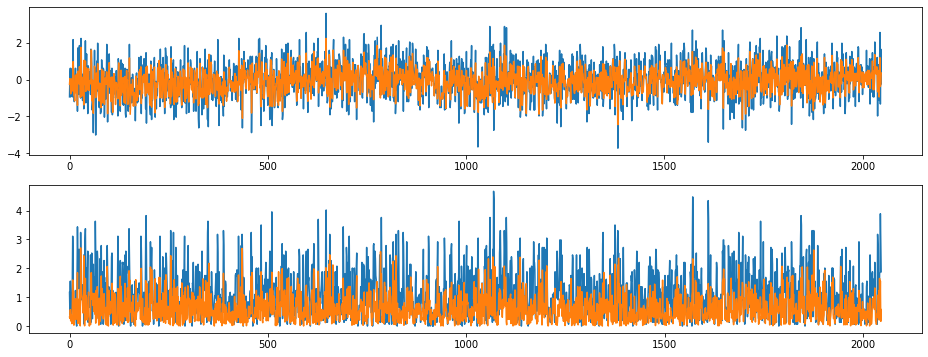

index:  217797
MAE:  0.4418819916639642
n_bunches       1868
bunch_index      375
bunch_number     191
Name: 2485429, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6278/instability_data/06278_Inst_B1H_Q7_20171007_05h32m14s.h5


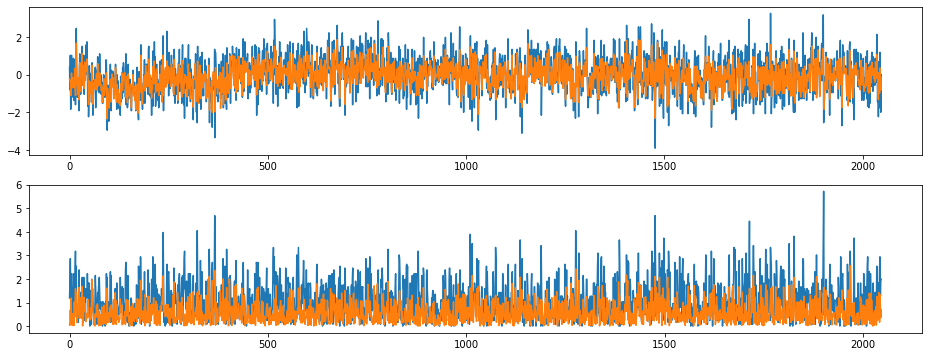

index:  98165
MAE:  0.44187647273096514
n_bunches       292
bunch_index     276
bunch_number    144
Name: 8670136, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6254/instability_data/06254_Inst_B1H_Q7_20170929_05h35m15s.h5


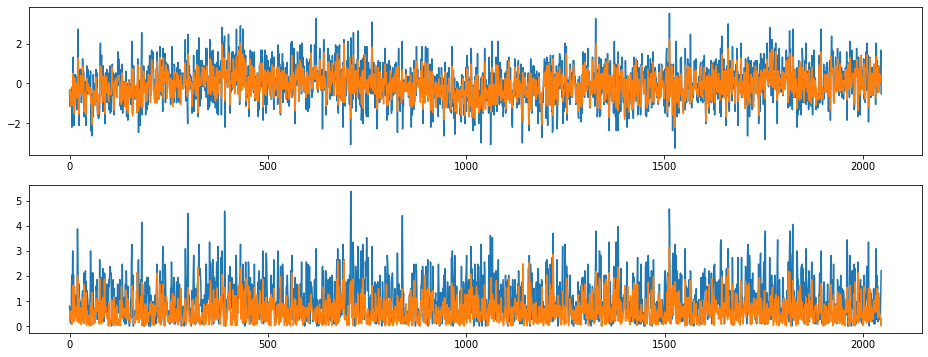

index:  322800
MAE:  0.44179816588268056
n_bunches       2556
bunch_index     2489
bunch_number    1854
Name: 8911011, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6919/instability_data/06919_Inst_B1H_Q7_20180714_02h25m14s.h5


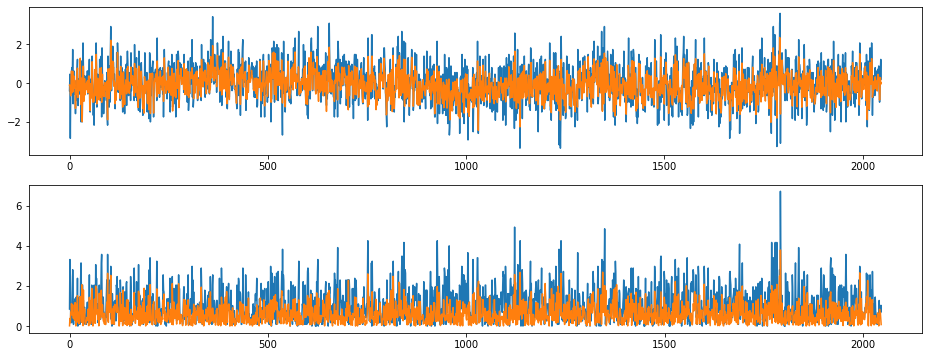

index:  109915
MAE:  0.44179578388003676
n_bunches       1868
bunch_index     2950
bunch_number    1587
Name: 7512903, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6337/instability_data/06337_Inst_B1H_Q7_20171027_11h54m13s.h5


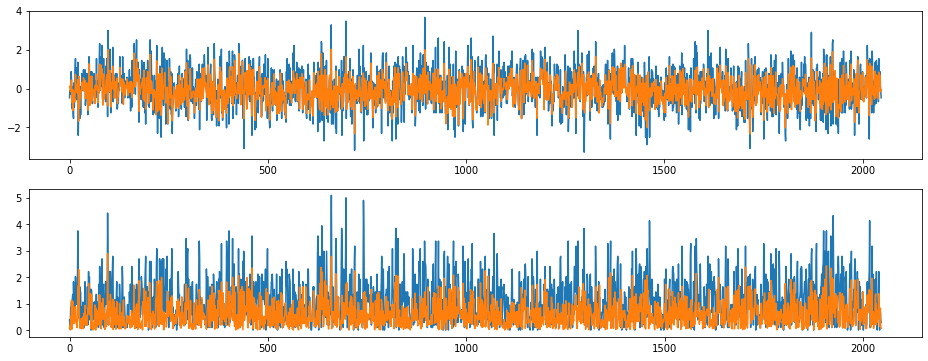

index:  99138
MAE:  0.4416931800264556
n_bunches       1020
bunch_index     1118
bunch_number     811
Name: 1016113, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6457/instability_data/06457_Inst_B1H_Q7_20171203_19h35m13s.h5


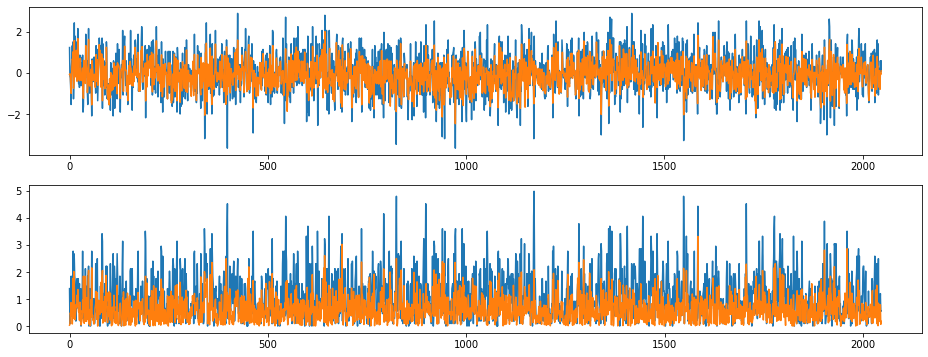

index:  126798
MAE:  0.44168988582795593
n_bunches       1548
bunch_index     3039
bunch_number    1313
Name: 1047204, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6399/instability_data/06399_Inst_B1H_Q7_20171121_02h26m14s.h5


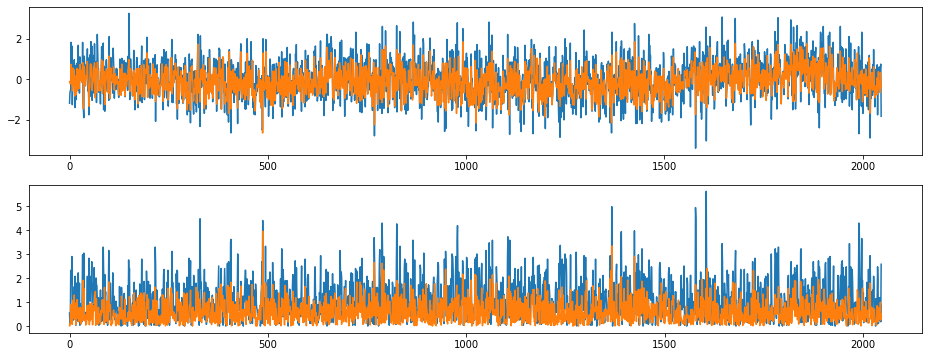

index:  233520
MAE:  0.44165569186348874
n_bunches       2175
bunch_index      783
bunch_number     456
Name: 1319424, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6694/instability_data/06694_Inst_B1H_Q7_20180517_17h01m14s.h5


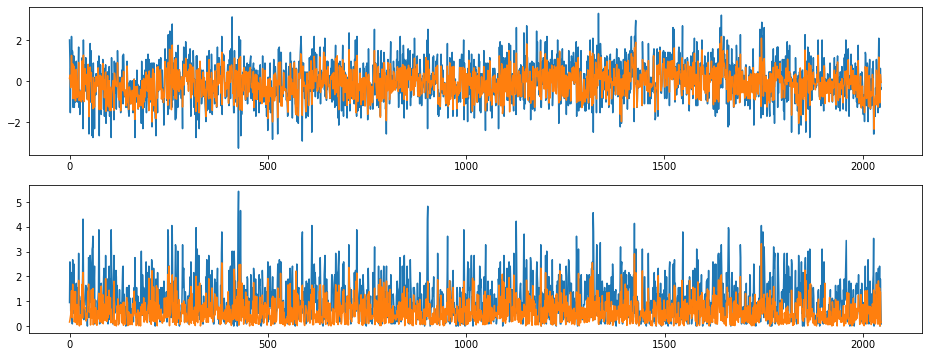

index:  66
MAE:  0.4416403345606955
n_bunches       780
bunch_index     400
bunch_number    268
Name: 11592060, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7264/instability_data/07264_Inst_B1H_Q7_20181007_00h52m21s.h5


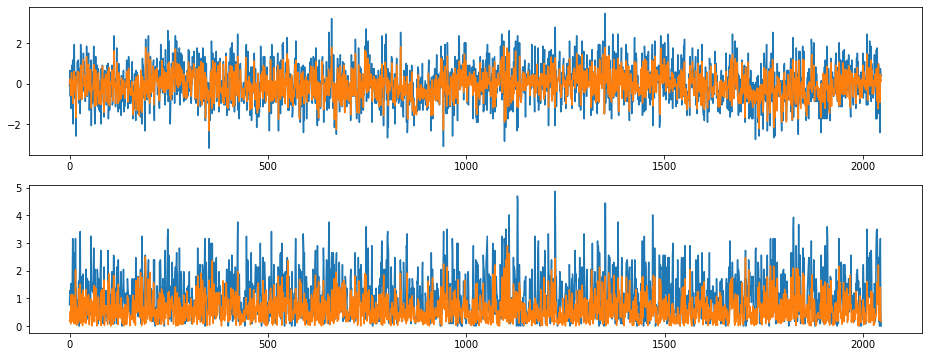

index:  157972
MAE:  0.44163373778238724
n_bunches       733
bunch_index     431
bunch_number     87
Name: 10314174, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7491/instability_data/07491_Inst_B1H_Q7_20181202_12h49m14s.h5


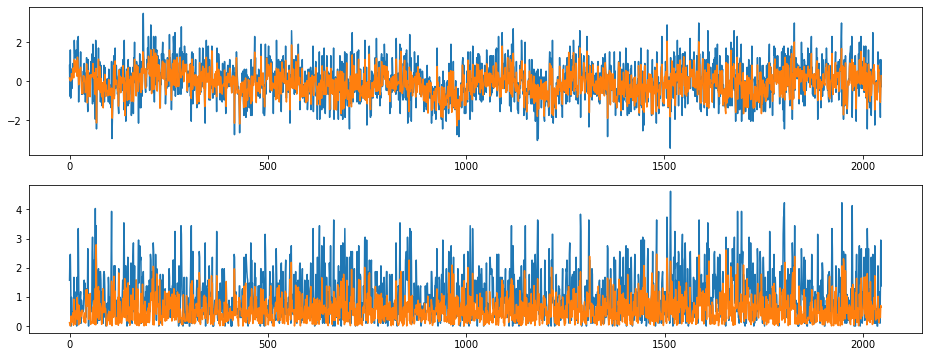

index:  121146
MAE:  0.441622117016897
n_bunches       636
bunch_index     577
bunch_number    400
Name: 7576122, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7271/instability_data/07271_Inst_B1H_Q7_20181009_17h16m29s.h5


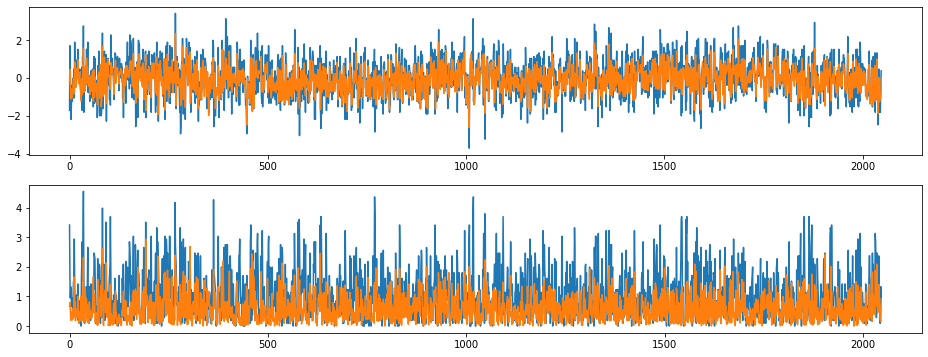

index:  146206
MAE:  0.44162053064991447
n_bunches        360
bunch_index     1362
bunch_number     249
Name: 1946099, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7441/instability_data/07441_Inst_B1H_Q7_20181113_05h47m50s.h5


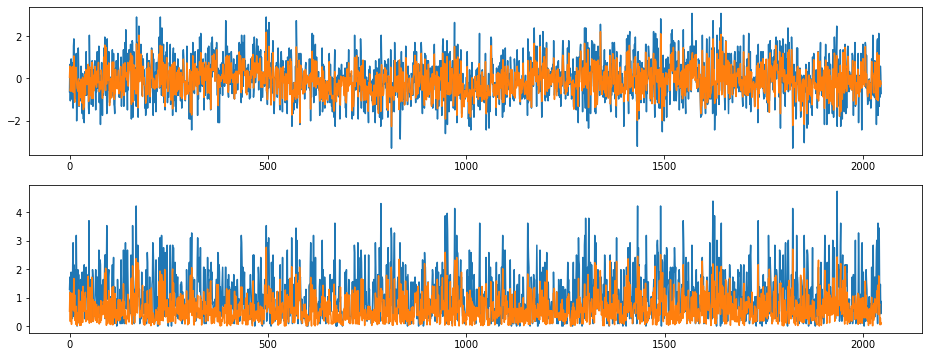

index:  304592
MAE:  0.4415946899244756
n_bunches       1068
bunch_index      517
bunch_number     371
Name: 4249839, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6960/instability_data/06960_Inst_B1H_Q7_20180722_08h07m07s.h5


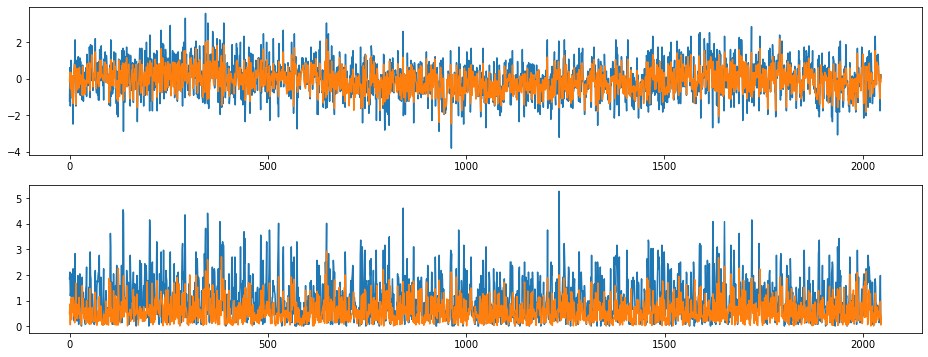

index:  108054
MAE:  0.4415937374804022
n_bunches       524
bunch_index      88
bunch_number     43
Name: 7222868, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6415/instability_data/06415_Inst_B1H_Q7_20171125_04h15m55s.h5


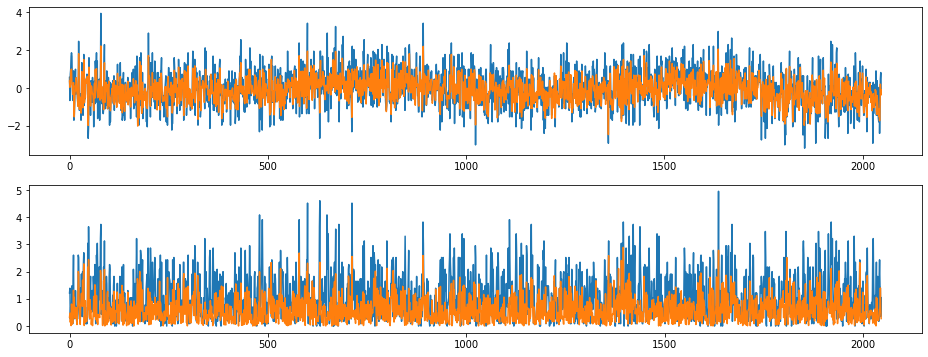

index:  81289
MAE:  0.4415872895100516
n_bunches        603
bunch_index     1187
bunch_number     206
Name: 9830582, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6612/instability_data/06612_Inst_B1H_Q7_20180425_13h59m14s.h5


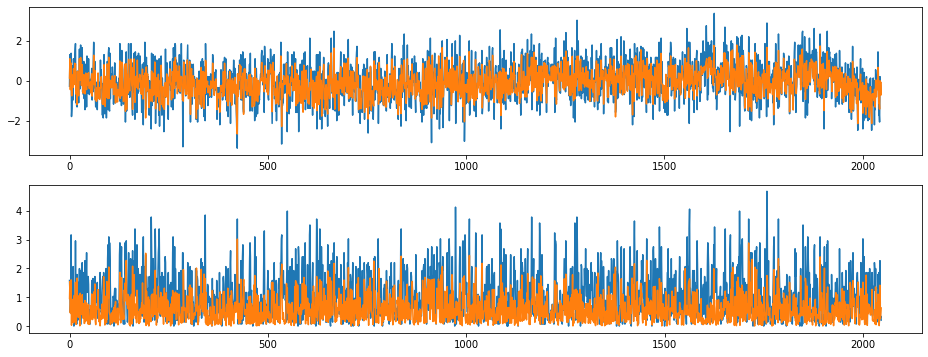

index:  49484
MAE:  0.441570283664655
n_bunches       1452
bunch_index      628
bunch_number     258
Name: 10512004, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6891/instability_data/06891_Inst_B1H_Q7_20180706_16h15m14s.h5


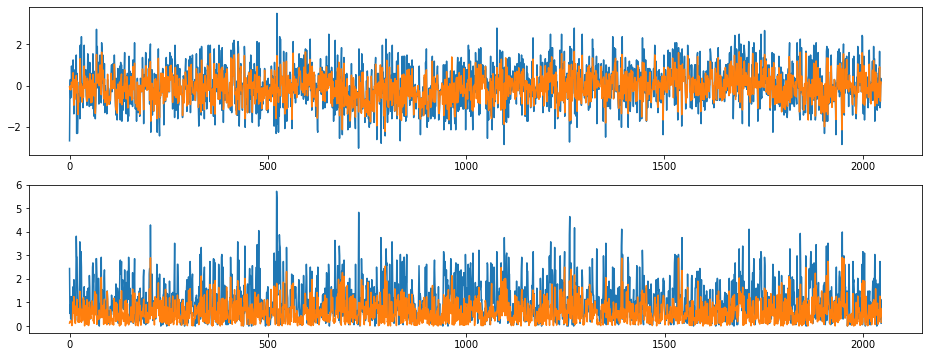

index:  397626
MAE:  0.44151356322221347
n_bunches       588
bunch_index     292
bunch_number    102
Name: 690286, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6809/instability_data/06809_Inst_B1H_Q7_20180616_06h06m03s.h5


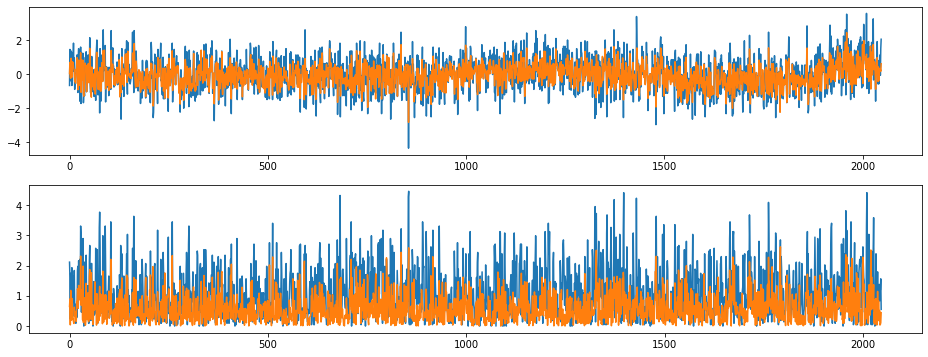

index:  137639
MAE:  0.44148347982292724
n_bunches       733
bunch_index     833
bunch_number    173
Name: 4237225, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7485/instability_data/07485_Inst_B1H_Q7_20181129_21h20m14s.h5


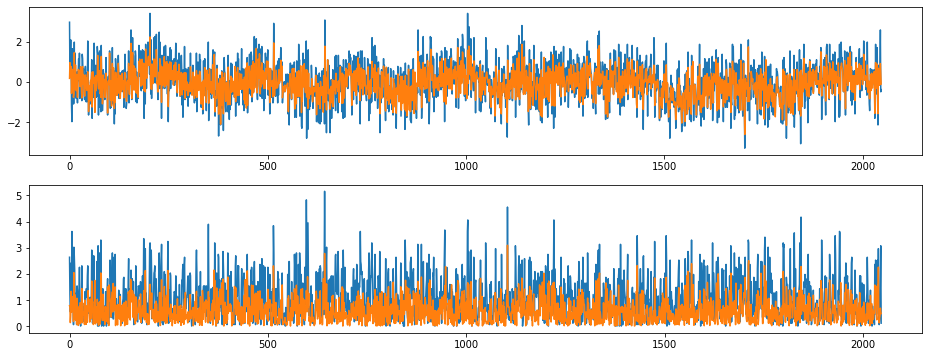

index:  115266
MAE:  0.44147428854211773
n_bunches       1887
bunch_index     2317
bunch_number    1346
Name: 10452030, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6693/instability_data/06693_Inst_B1H_Q7_20180517_06h50m14s.h5


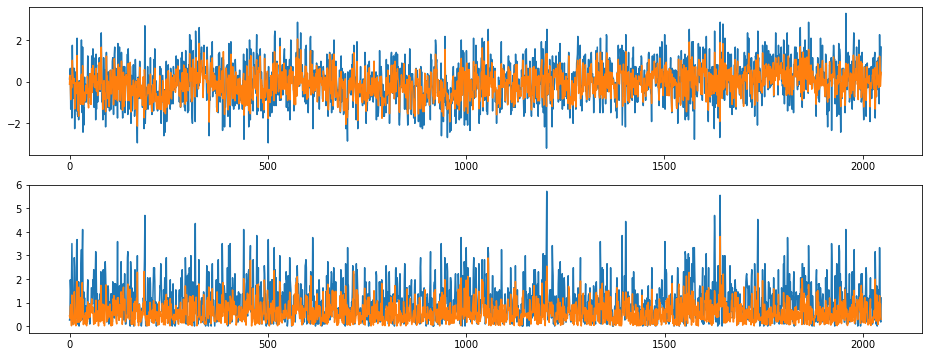

index:  128948
MAE:  0.44141294568109674
n_bunches       1452
bunch_index     2888
bunch_number    1223
Name: 3789985, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6890/instability_data/06890_Inst_B1H_Q7_20180706_10h45m15s.h5


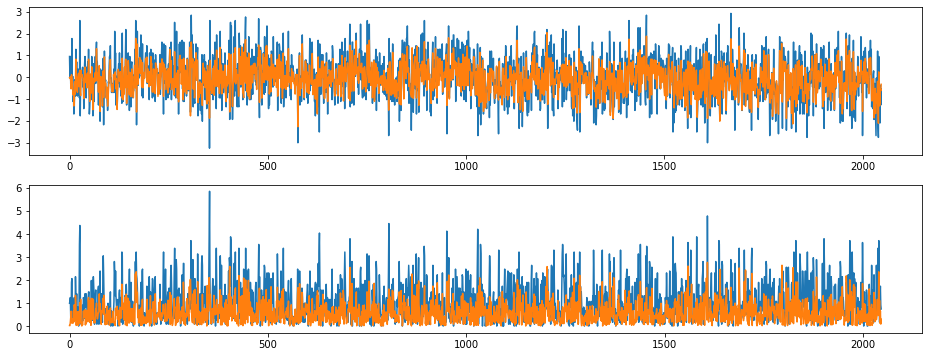

index:  305463
MAE:  0.44137258251769484
n_bunches       1068
bunch_index      503
bunch_number     357
Name: 9540262, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7145/instability_data/07145_Inst_B1H_Q7_20180910_04h29m30s.h5


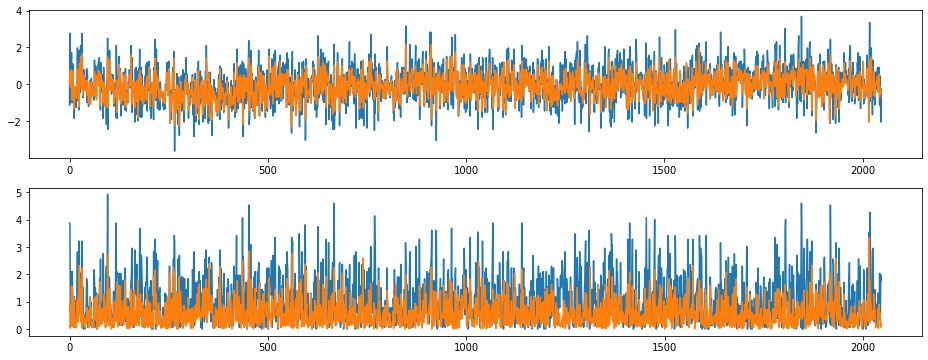

index:  93651
MAE:  0.4413661587199267
n_bunches       1358
bunch_index     1563
bunch_number     652
Name: 2389956, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_05h54m19s.h5


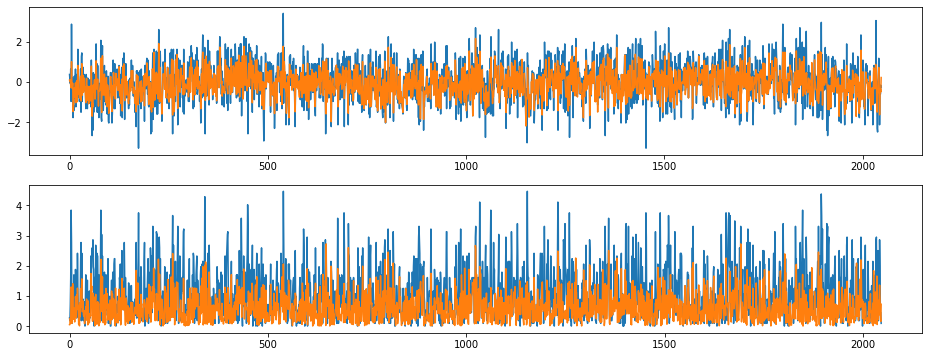

index:  109251
MAE:  0.44135861759123596
n_bunches       804
bunch_index     212
bunch_number    159
Name: 5743247, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6601/instability_data/06601_Inst_B1H_Q7_20180423_14h56m35s.h5


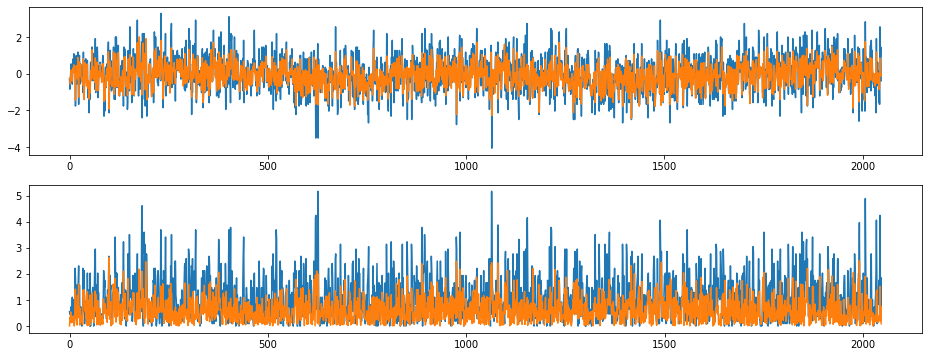

index:  53190
MAE:  0.4413539502266147
n_bunches       2556
bunch_index     2726
bunch_number    1999
Name: 9157721, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6757/instability_data/06757_Inst_B1H_Q7_20180604_18h02m17s.h5


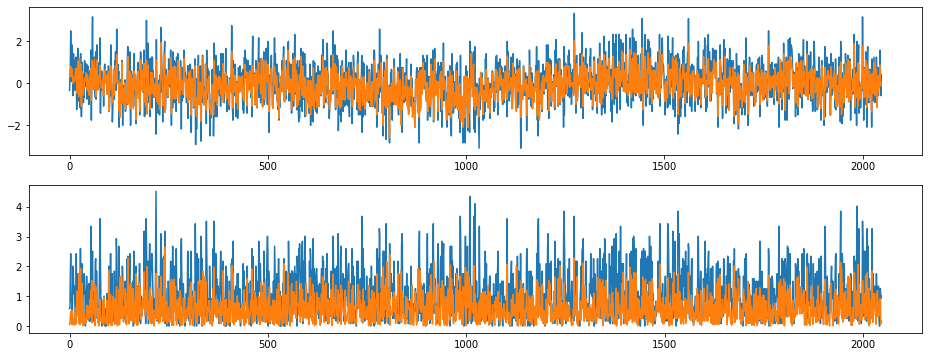

index:  110024
MAE:  0.4413118889042967
n_bunches       108
bunch_index     167
bunch_number     92
Name: 3550814, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6683/instability_data/06683_Inst_B1H_Q7_20180515_01h07m14s.h5


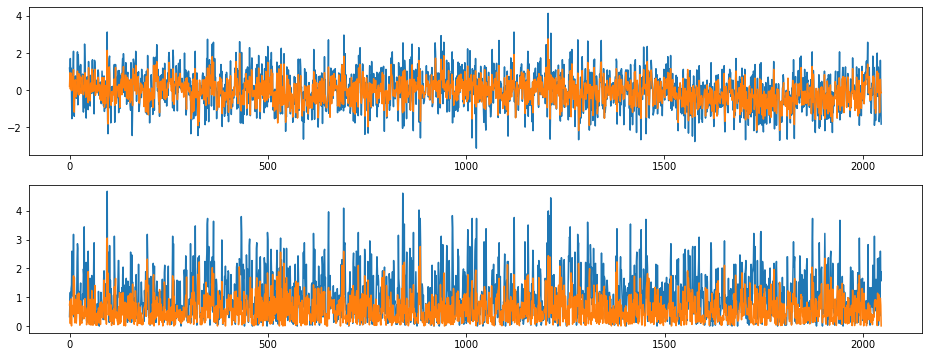

index:  1878
MAE:  0.4412987807580924
n_bunches        444
bunch_index     1514
bunch_number     443
Name: 943402, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7182/instability_data/07182_Inst_B1H_Q7_20180915_17h45m02s.h5


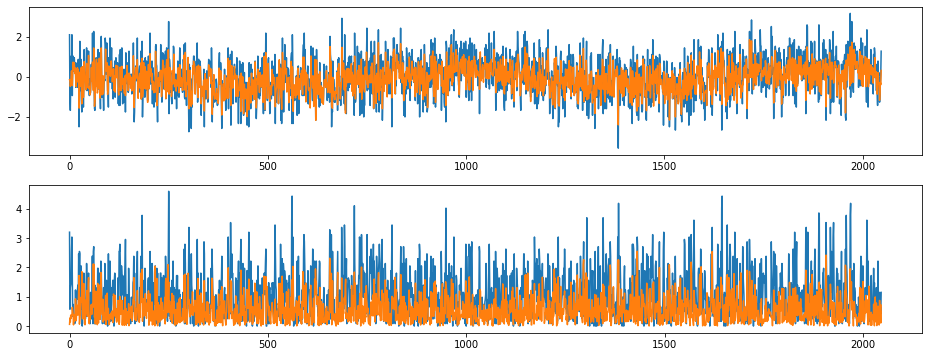

index:  103606
MAE:  0.4412076695177193
n_bunches       396
bunch_index     422
bunch_number    290
Name: 1510414, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6968/instability_data/06968_Inst_B1H_Q7_20180724_07h38m58s.h5


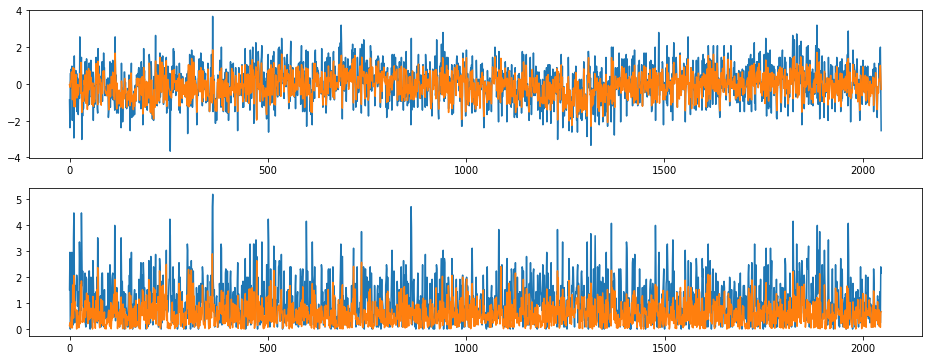

index:  54852
MAE:  0.44118031132642155
n_bunches       1020
bunch_index      876
bunch_number     625
Name: 3251495, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6457/instability_data/06457_Inst_B1H_Q7_20171203_18h40m15s.h5


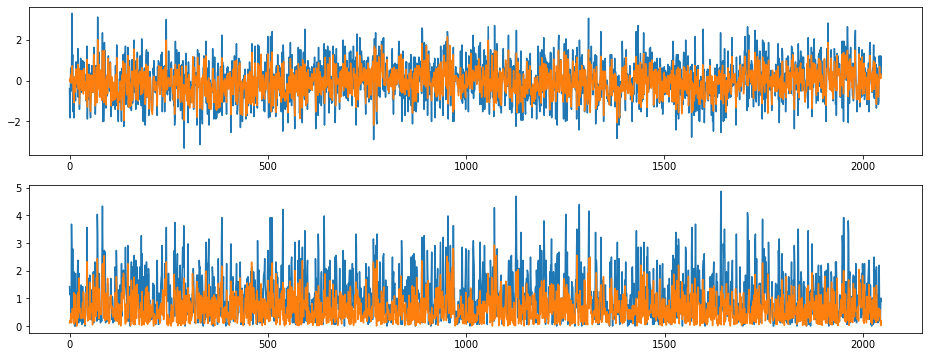

index:  63370
MAE:  0.4411412899604094
n_bunches       1868
bunch_index      418
bunch_number     219
Name: 6684035, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6356/instability_data/06356_Inst_B1H_Q7_20171102_11h45m15s.h5


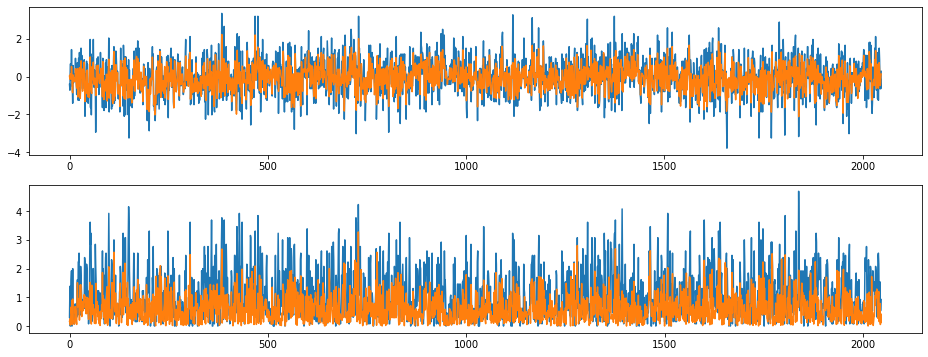

index:  52978
MAE:  0.4410965313788047
n_bunches       362
bunch_index     539
bunch_number    150
Name: 8364665, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6615/instability_data/06615_Inst_B1H_Q7_20180426_18h58m12s.h5


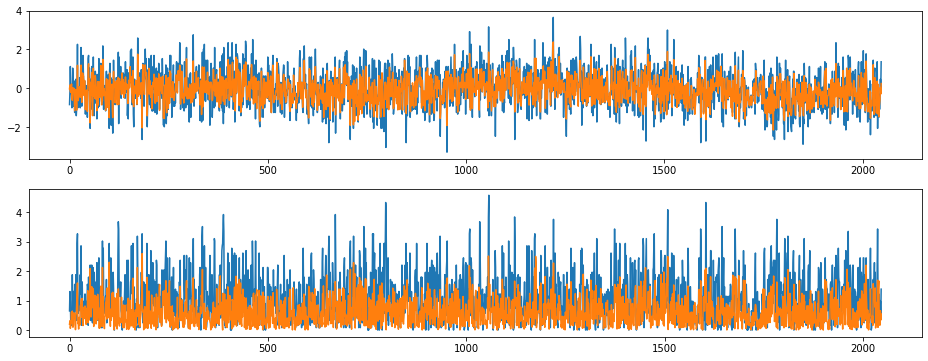

index:  306965
MAE:  0.4410826753772063
n_bunches        987
bunch_index     3179
bunch_number     891
Name: 7453128, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6929/instability_data/06929_Inst_B1H_Q7_20180716_06h59m15s.h5


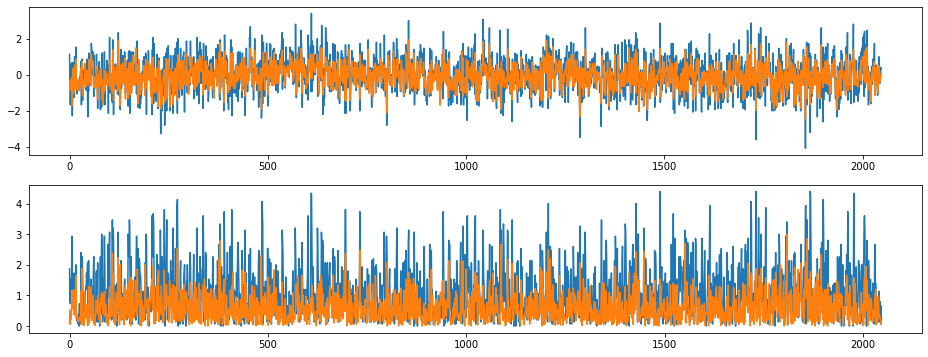

index:  106701
MAE:  0.441059734960412
n_bunches       924
bunch_index     609
bunch_number    432
Name: 6974046, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7320/instability_data/07320_Inst_B1H_Q7_20181019_15h44m08s.h5


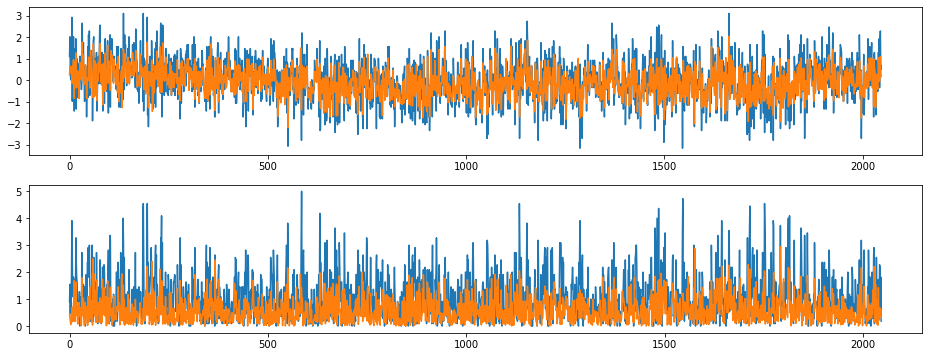

index:  290162
MAE:  0.4410483332418631
n_bunches       2556
bunch_index      447
bunch_number     296
Name: 5245380, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6711/instability_data/06711_Inst_B1H_Q7_20180522_14h12m14s.h5


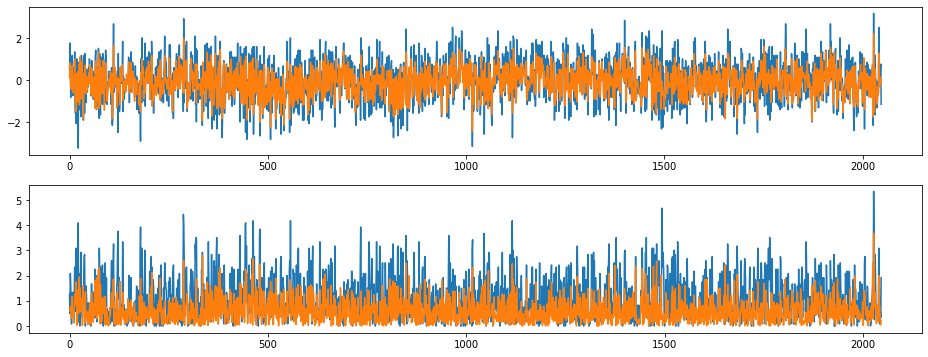

index:  104569
MAE:  0.44103655700474387
n_bunches       649
bunch_index     462
bunch_number    188
Name: 5151028, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_03h03m14s.h5


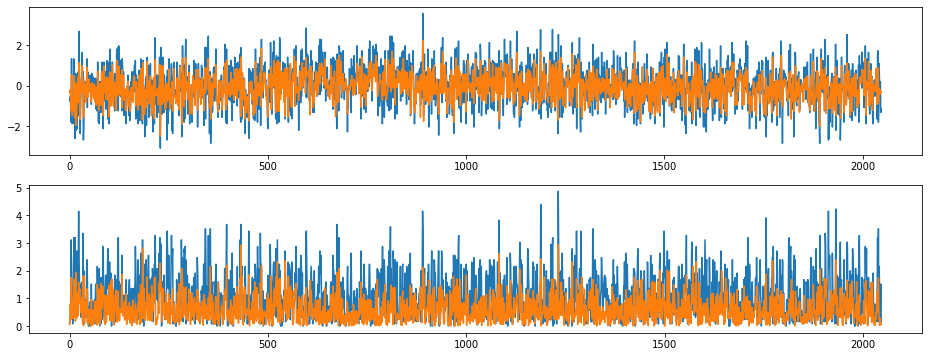

index:  295402
MAE:  0.44102159924196416
n_bunches       2556
bunch_index     1603
bunch_number    1190
Name: 1299025, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6919/instability_data/06919_Inst_B1H_Q7_20180713_19h36m14s.h5


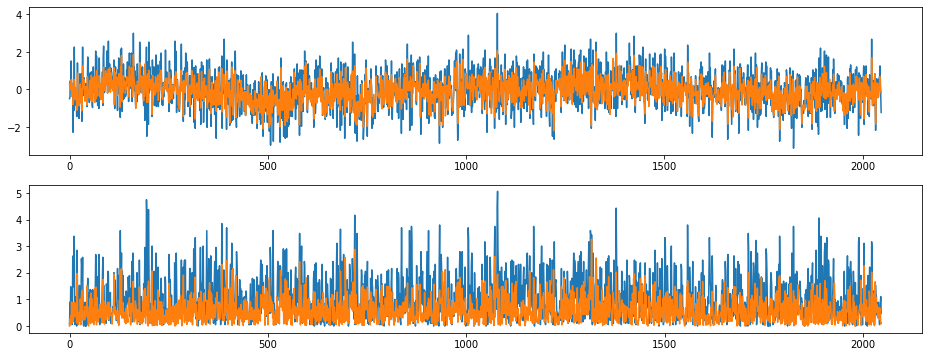

index:  376283
MAE:  0.4410197597001434
n_bunches       2556
bunch_index     2856
bunch_number    2115
Name: 632393, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6711/instability_data/06711_Inst_B1H_Q7_20180522_10h23m14s.h5


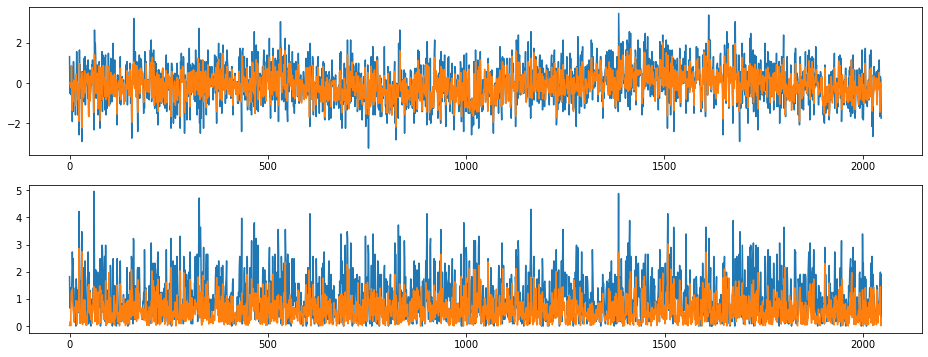

index:  191284
MAE:  0.44100176429092997
n_bunches       780
bunch_index     162
bunch_number    106
Name: 10868369, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7314/instability_data/07314_Inst_B1H_Q7_20181017_23h24m14s.h5


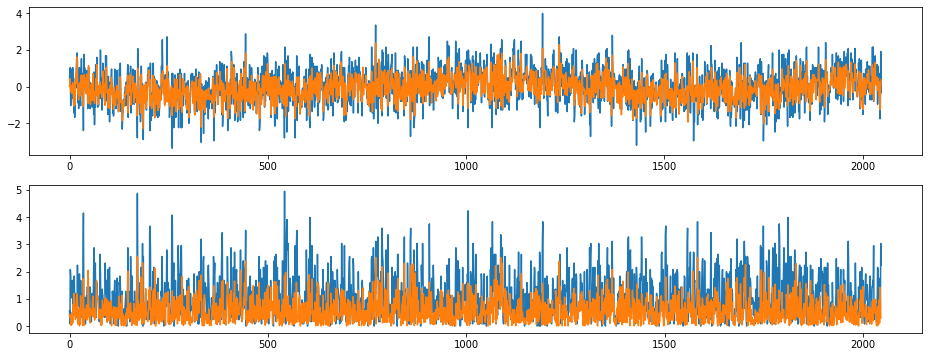

index:  234013
MAE:  0.4409884236366771
n_bunches        612
bunch_index     3172
bunch_number     594
Name: 3194635, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181115_19h19m14s.h5


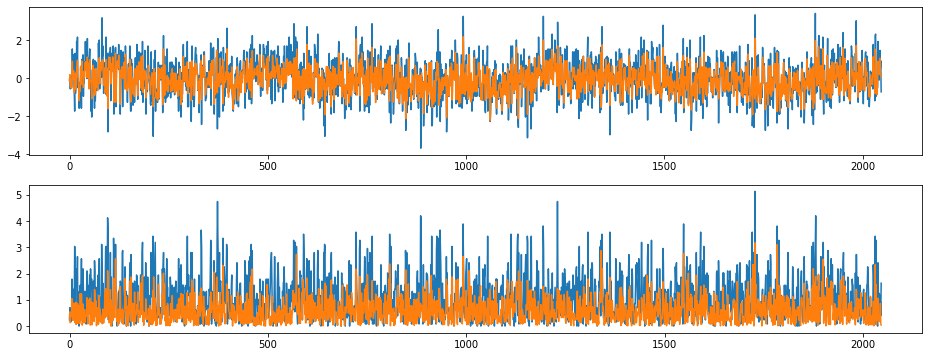

index:  290366
MAE:  0.44095667356256063
n_bunches       2556
bunch_index     3255
bunch_number    2412
Name: 1802143, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7031/instability_data/07031_Inst_B1H_Q7_20180807_00h55m45s.h5


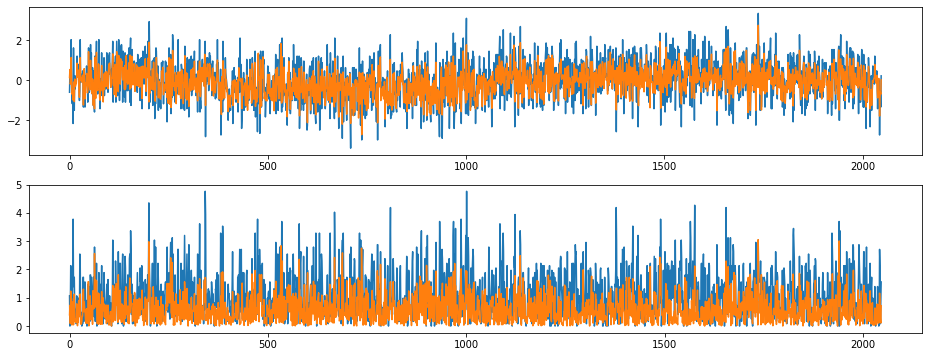

index:  350078
MAE:  0.4408864724363396
n_bunches        190
bunch_index     1323
bunch_number     174
Name: 9714837, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6984/instability_data/06984_Inst_B1H_Q7_20180726_20h29m14s.h5


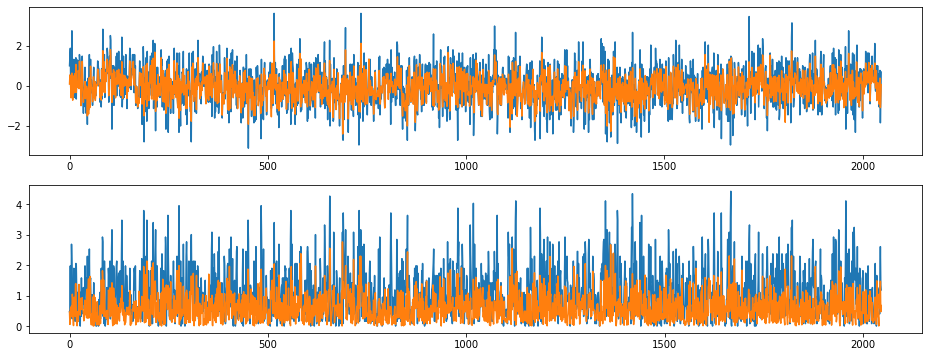

In [25]:
for i in range(200):
    anomalous = i
    anomalous_index = max_MAE_indices[anomalous]

    print('index: ', anomalous_index)
    print("MAE: ", MAE_train[anomalous_index])
    # I'm not sure this row is correct
    metadata_row = train_generator.metadata.iloc[anomalous_index // 32]
    print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
    print(metadata_row['file'])

    true_signal = train_dataset[anomalous_index].squeeze()
    pred_signal = train_pred[anomalous_index].squeeze()

    plot_true_pred(true_signal, pred_signal)
    plt.show()

# Top leftmost signals

index:  237124
MAE:  0.11001883657263534
n_bunches        505
bunch_index     1131
bunch_number     319
Name: 5963941, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6939/instability_data/06939_Inst_B1H_Q7_20180717_23h34m36s.h5


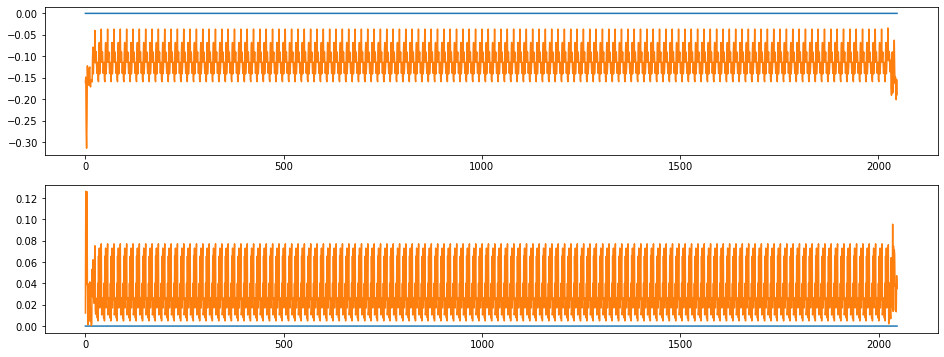

index:  206068
MAE:  0.11001883657263534
n_bunches       1836
bunch_index     1804
bunch_number     961
Name: 6205980, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6266/instability_data/06266_Inst_B1H_Q7_20171002_19h23m50s.h5


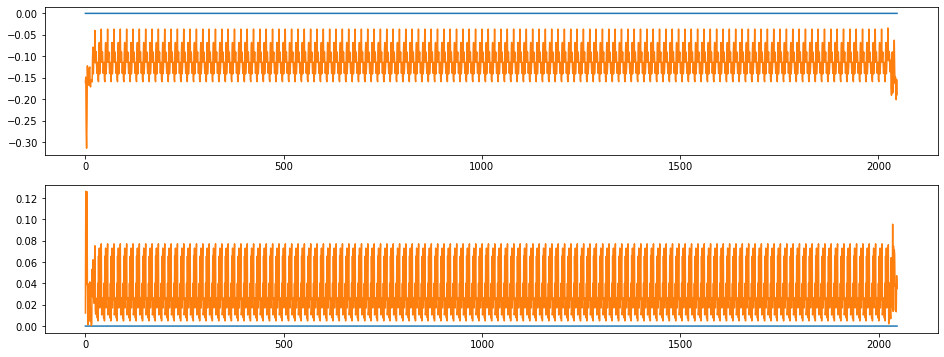

index:  281137
MAE:  0.11001883657263534
n_bunches        670
bunch_index     2279
bunch_number     481
Name: 793447, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7466/instability_data/07466_Inst_B1H_Q7_20181123_00h11m14s.h5


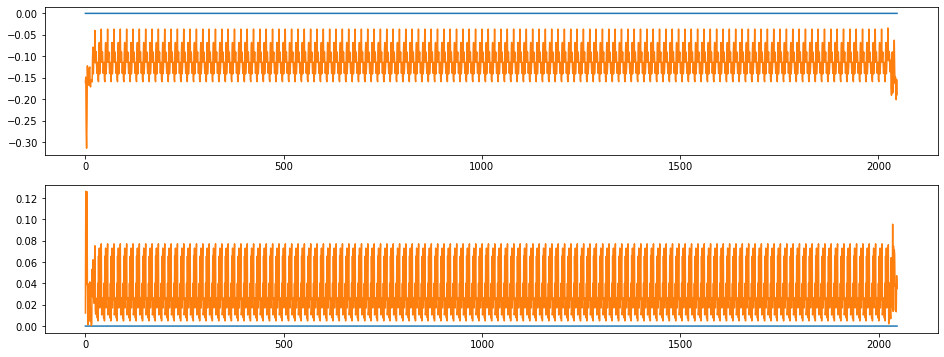

index:  385510
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     1828
bunch_number    1323
Name: 9288494, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6709/instability_data/06709_Inst_B1H_Q7_20180521_03h36m14s.h5


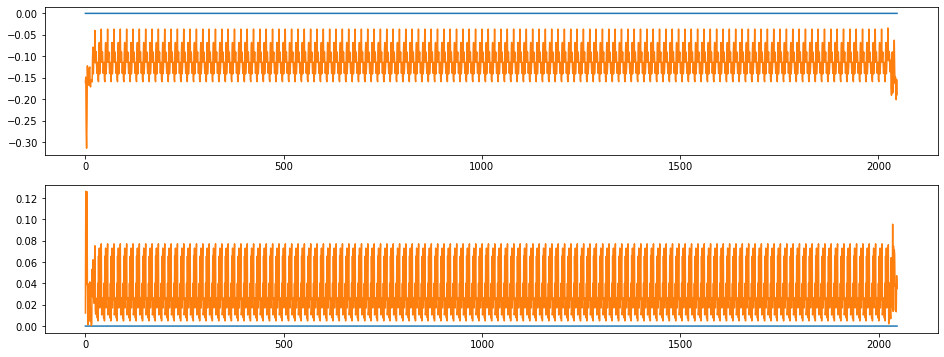

index:  303030
MAE:  0.11001883657263534
n_bunches       924
bunch_index     924
bunch_number    660
Name: 8101955, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7018/instability_data/07018_Inst_B1H_Q7_20180804_00h53m54s.h5


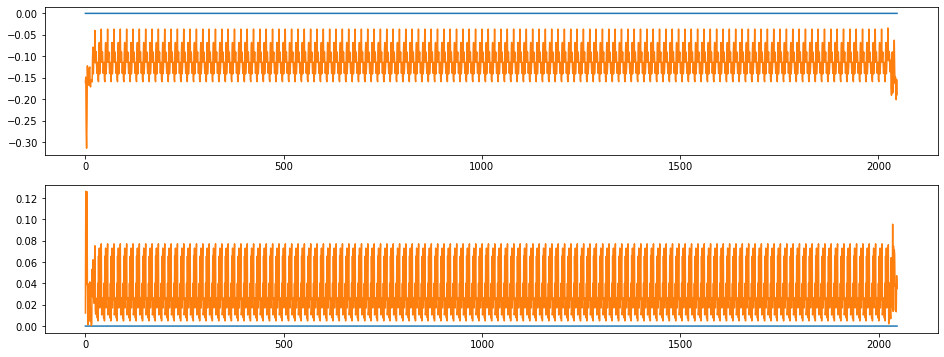

index:  350890
MAE:  0.11001883657263534
n_bunches       339
bunch_index     948
bunch_number    100
Name: 5764677, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6595/instability_data/06595_Inst_B1H_Q7_20180423_03h06m14s.h5


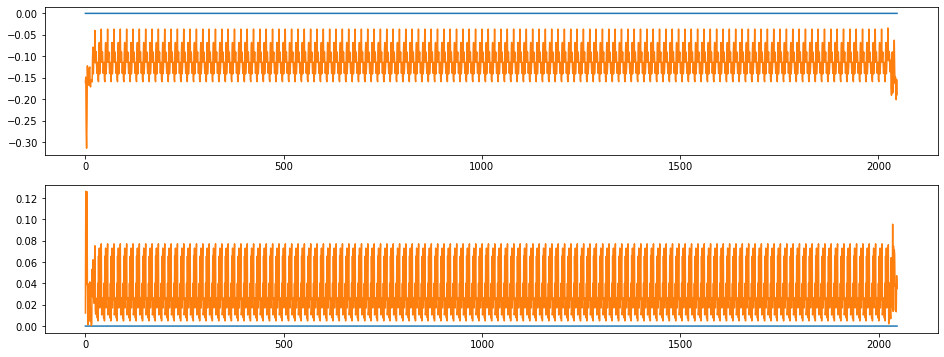

index:  303049
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     3120
bunch_number    2303
Name: 1581979, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6709/instability_data/06709_Inst_B1H_Q7_20180521_01h31m14s.h5


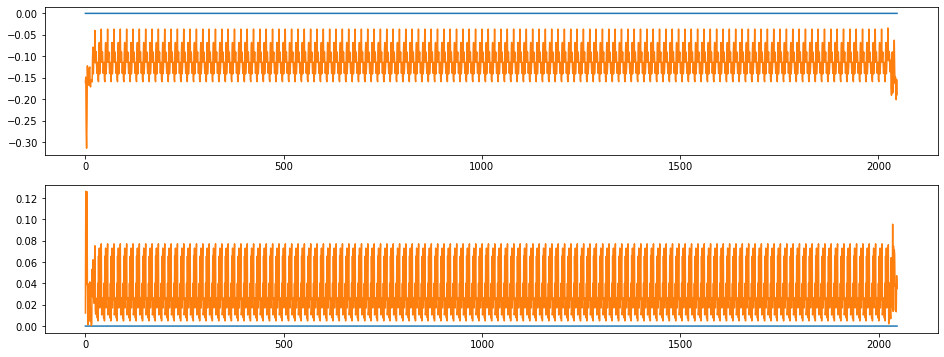

index:  212172
MAE:  0.11001883657263534
n_bunches        152
bunch_index     1904
bunch_number      83
Name: 594717, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7299/instability_data/07299_Inst_B1H_Q7_20181014_07h00m14s.h5


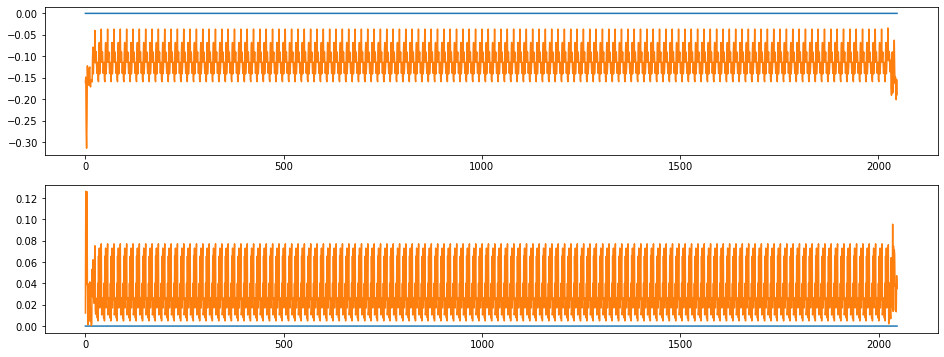

index:  83749
MAE:  0.11001883657263534
n_bunches       1116
bunch_index      886
bunch_number     268
Name: 11235142, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6587/instability_data/06587_Inst_B1H_Q7_20180421_16h10m14s.h5


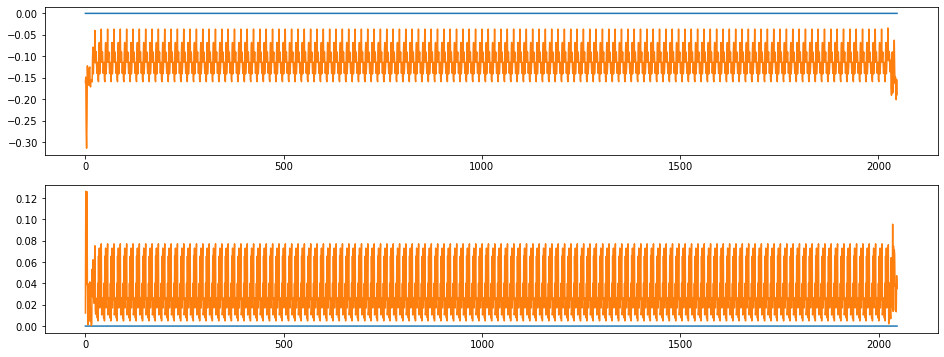

index:  30080
MAE:  0.11001883657263534
n_bunches       652
bunch_index     400
bunch_number    205
Name: 10310437, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6284/instability_data/06284_Inst_B1H_Q7_20171008_16h40m31s.h5


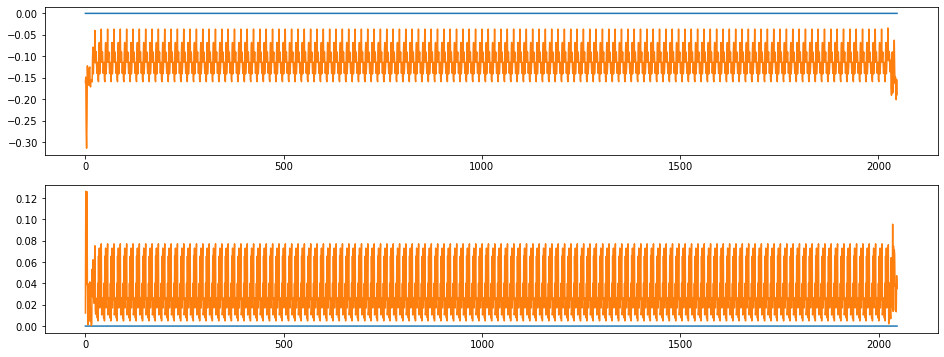

index:  203753
MAE:  0.11001883657263534
n_bunches        72
bunch_index     149
bunch_number     42
Name: 9442750, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6615/instability_data/06615_Inst_B1H_Q7_20180426_18h47m14s.h5


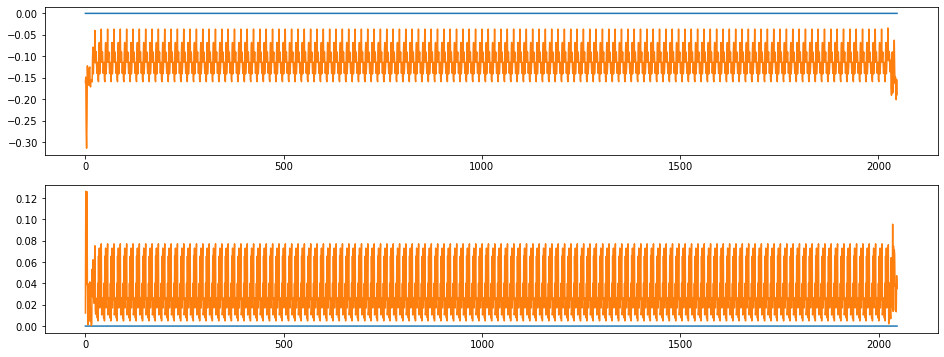

index:  360301
MAE:  0.11001883657263534
n_bunches       157
bunch_index     151
bunch_number     34
Name: 5621307, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7362/instability_data/07362_Inst_B1H_Q7_20181026_16h41m57s.h5


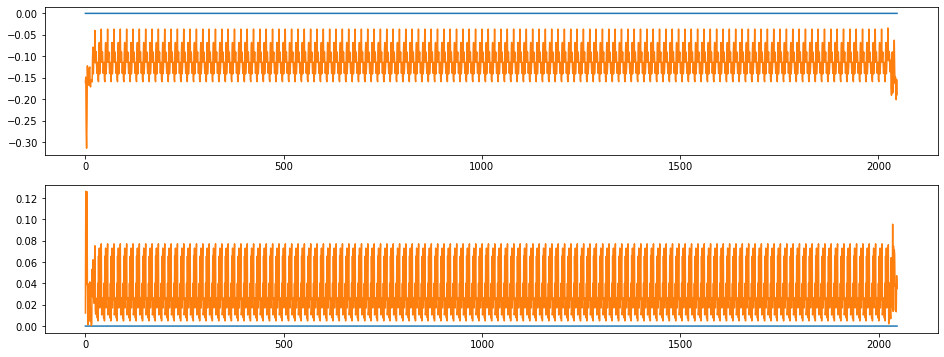

index:  392791
MAE:  0.11001883657263534
n_bunches        444
bunch_index     1923
bunch_number     358
Name: 8005335, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7454/instability_data/07454_Inst_B1H_Q7_20181118_23h31m12s.h5


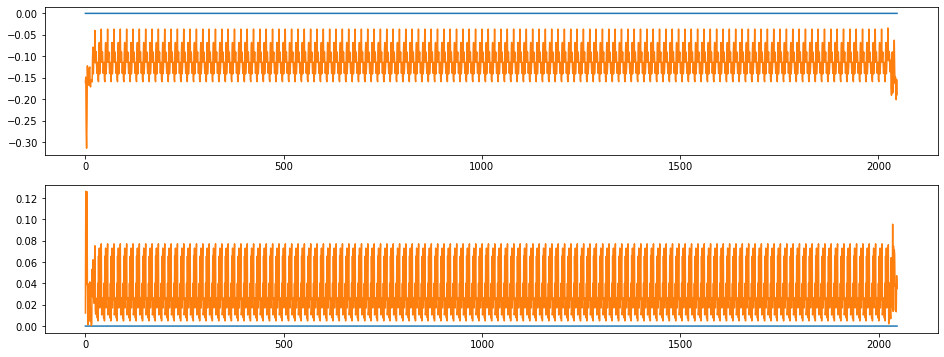

index:  366597
MAE:  0.11001883657263534
n_bunches       1292
bunch_index     1493
bunch_number     567
Name: 10785079, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6384/instability_data/06384_Inst_B1H_Q7_20171112_22h19m14s.h5


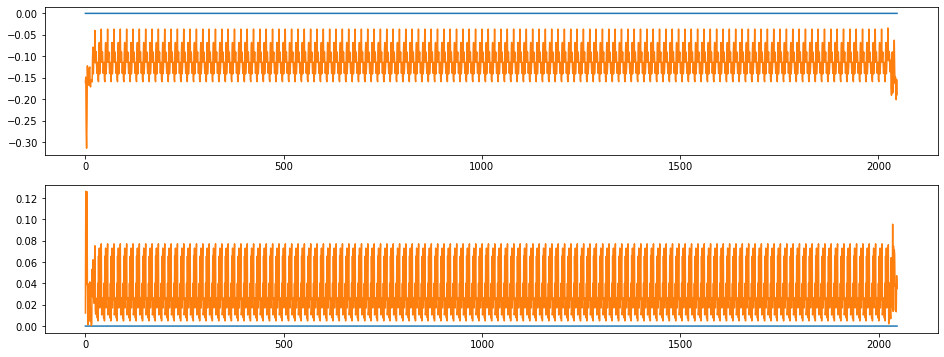

index:  331590
MAE:  0.11001883657263534
n_bunches        843
bunch_index     1469
bunch_number     480
Name: 10261209, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6939/instability_data/06939_Inst_B1H_Q7_20180717_23h40m48s.h5


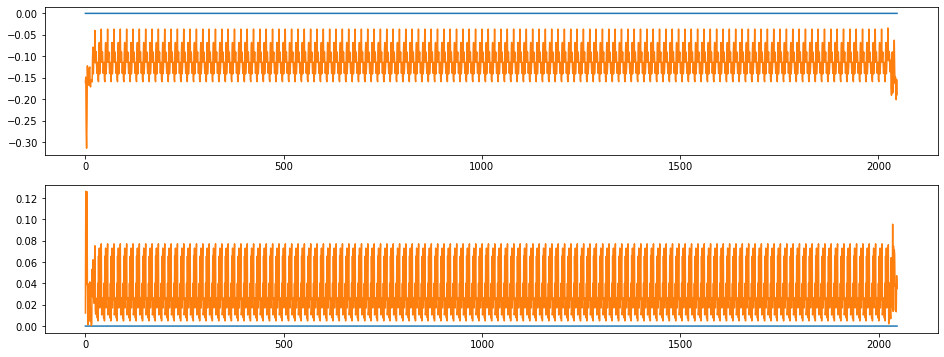

index:  131194
MAE:  0.11001883657263534
n_bunches        315
bunch_index     1362
bunch_number     165
Name: 3781389, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6611/instability_data/06611_Inst_B1H_Q7_20180424_21h31m14s.h5


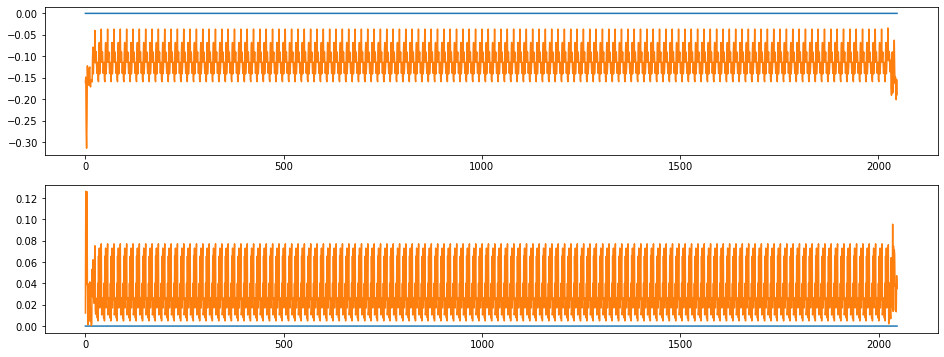

index:  336719
MAE:  0.11001883657263534
n_bunches       746
bunch_index     189
bunch_number     25
Name: 6796622, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6939/instability_data/06939_Inst_B1H_Q7_20180717_23h38m19s.h5


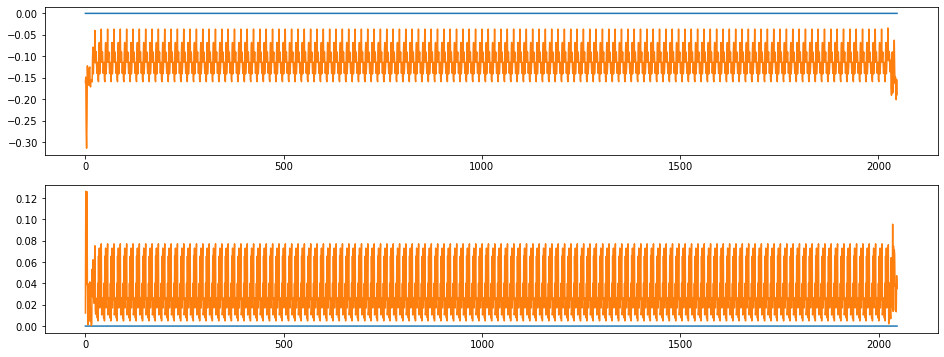

index:  131160
MAE:  0.11001883657263534
n_bunches       924
bunch_index     792
bunch_number    566
Name: 10819432, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6776/instability_data/06776_Inst_B1H_Q7_20180611_16h58m14s.h5


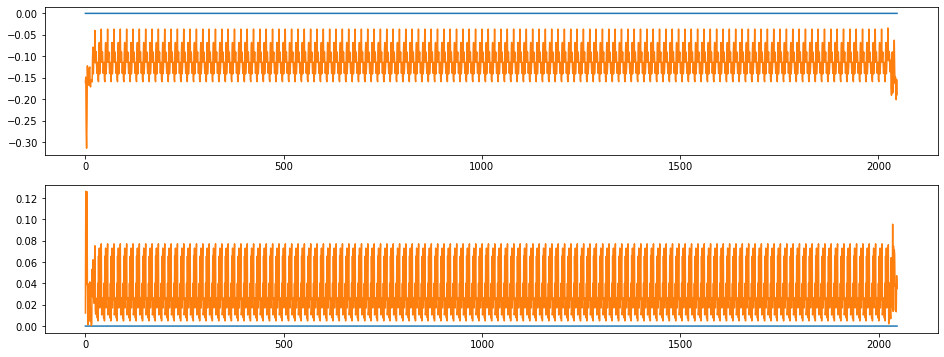

index:  131212
MAE:  0.11001883657263534
n_bunches       987
bunch_index     465
bunch_number    131
Name: 1424788, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6901/instability_data/06901_Inst_B1H_Q7_20180708_03h11m15s.h5


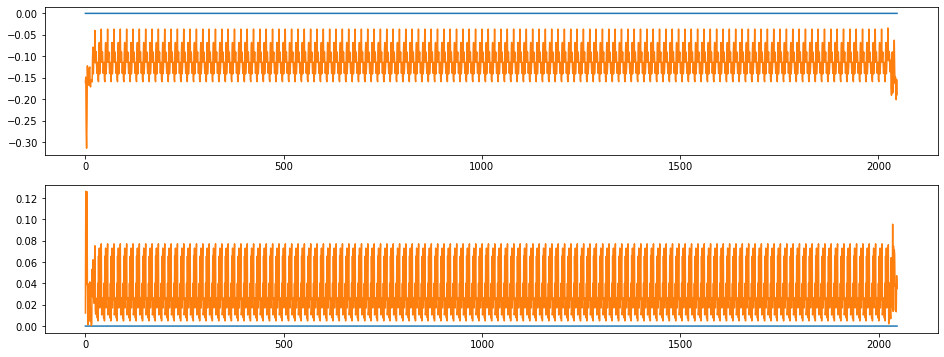

index:  231608
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     1675
bunch_number    1227
Name: 855380, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6919/instability_data/06919_Inst_B1H_Q7_20180713_11h53m15s.h5


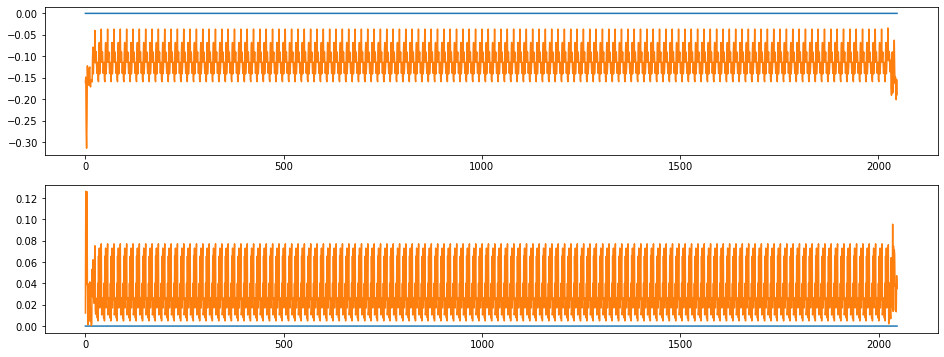

index:  33819
MAE:  0.11001883657263534
n_bunches       2555
bunch_index      923
bunch_number     659
Name: 5627803, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7137/instability_data/07137_Inst_B1H_Q7_20180908_15h13m41s.h5


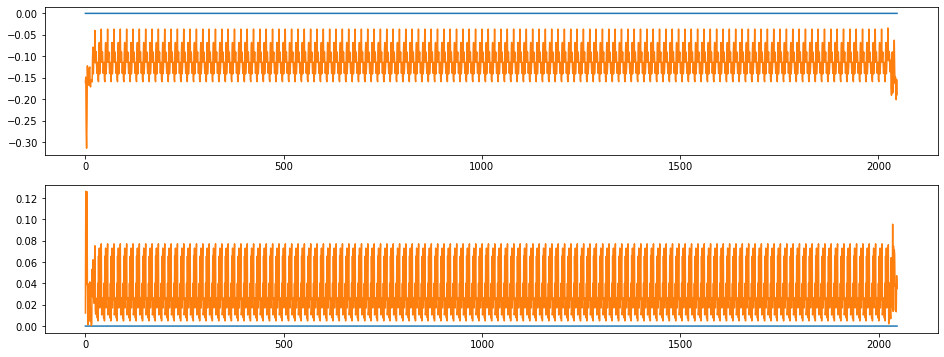

index:  349234
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     2213
bunch_number    1637
Name: 2766587, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7234/instability_data/07234_Inst_B1H_Q7_20180929_13h03m14s.h5


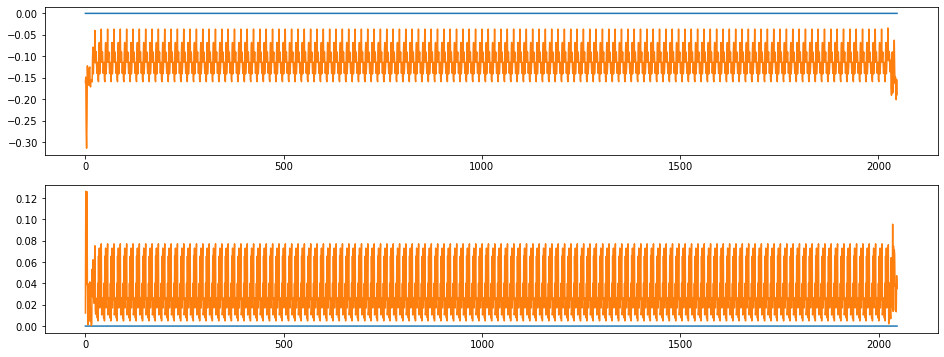

index:  134838
MAE:  0.11001883657263534
n_bunches       396
bunch_index     524
bunch_number    378
Name: 8872946, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7319/instability_data/07319_Inst_B1H_Q7_20181019_13h49m40s.h5


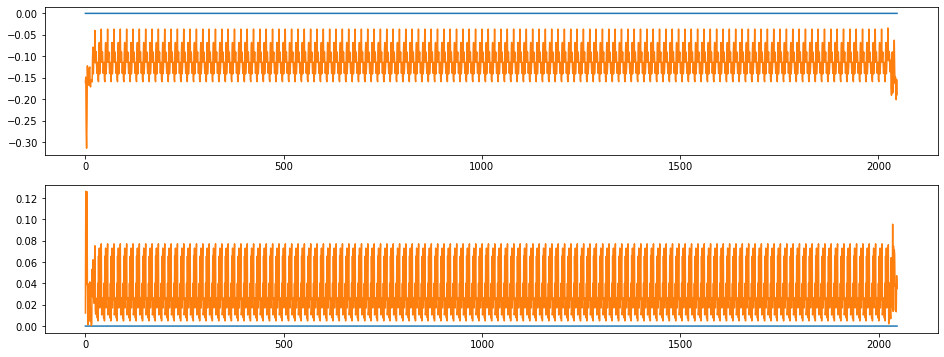

index:  335178
MAE:  0.11001883657263534
n_bunches       1868
bunch_index     3248
bunch_number    1742
Name: 11564424, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6348/instability_data/06348_Inst_B1H_Q7_20171030_23h46m14s.h5


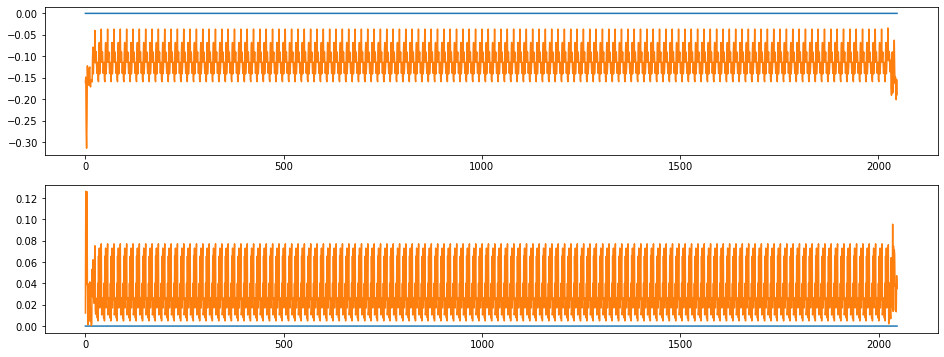

index:  185077
MAE:  0.11001883657263534
n_bunches       540
bunch_index     516
bunch_number    370
Name: 4662197, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7320/instability_data/07320_Inst_B1H_Q7_20181019_15h40m50s.h5


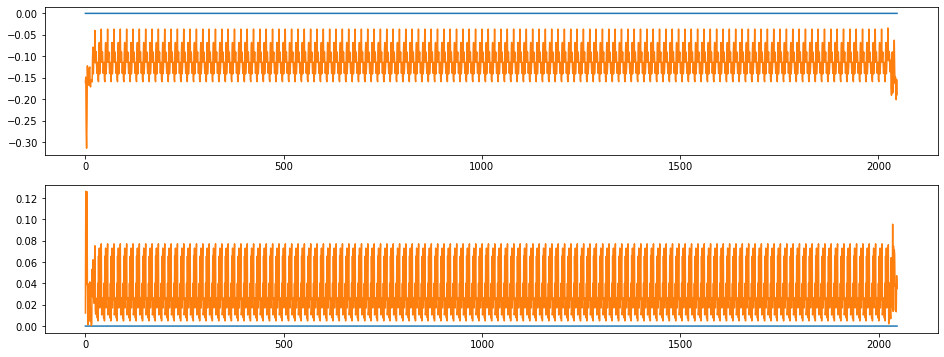

index:  221490
MAE:  0.11001883657263534
n_bunches        339
bunch_index     1039
bunch_number     121
Name: 10203361, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6595/instability_data/06595_Inst_B1H_Q7_20180422_21h53m14s.h5


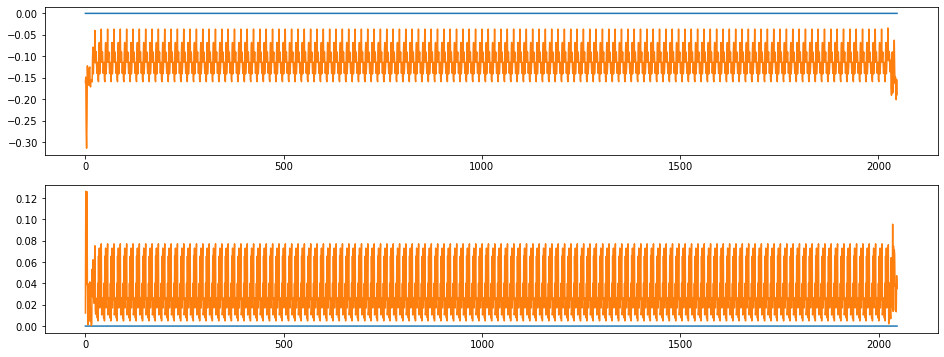

index:  192943
MAE:  0.11001883657263534
n_bunches       1308
bunch_index     1441
bunch_number    1117
Name: 2651648, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6588/instability_data/06588_Inst_B1H_Q7_20180421_17h35m14s.h5


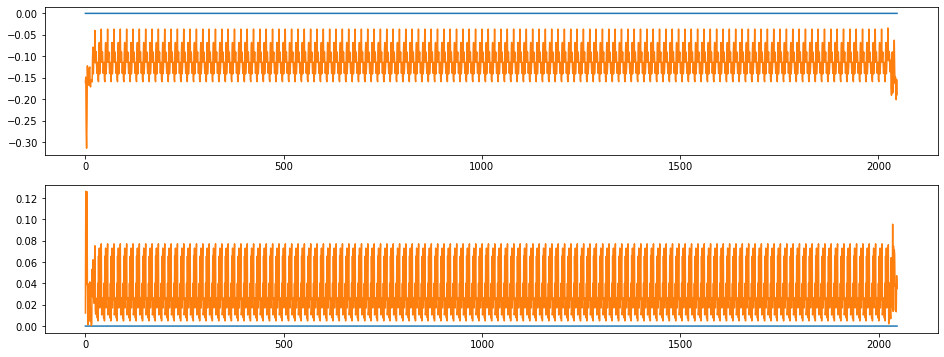

index:  30162
MAE:  0.11001883657263534
n_bunches       780
bunch_index     123
bunch_number     67
Name: 6893941, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7309/instability_data/07309_Inst_B1H_Q7_20181016_13h45m54s.h5


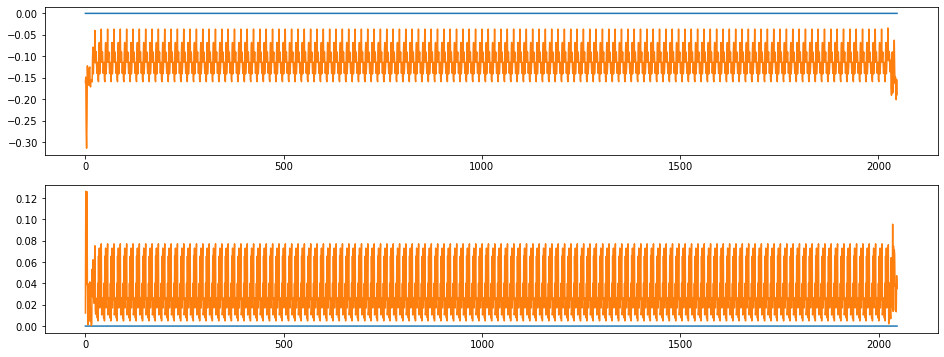

index:  373412
MAE:  0.11001883657263534
n_bunches       444
bunch_index     482
bunch_number    247
Name: 10482111, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6988/instability_data/06988_Inst_B1H_Q7_20180727_05h37m14s.h5


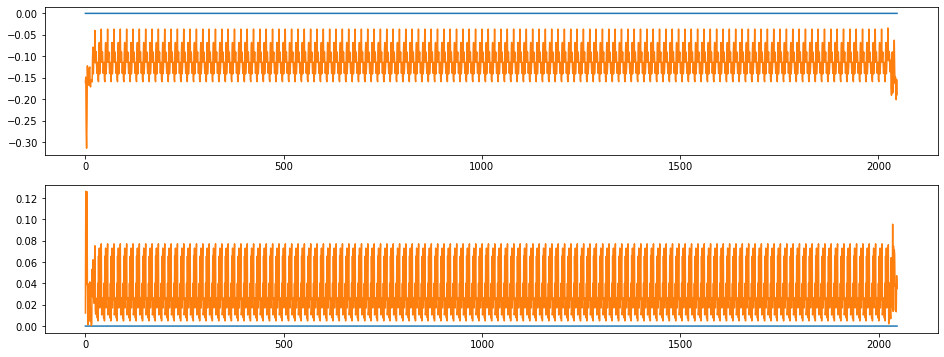

index:  289638
MAE:  0.11001883657263534
n_bunches       656
bunch_index     464
bunch_number     97
Name: 2167579, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6404/instability_data/06404_Inst_B1H_Q7_20171121_19h47m14s.h5


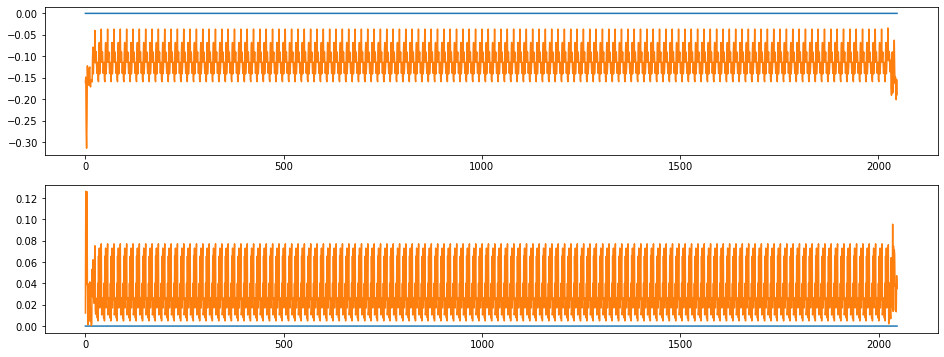

index:  146128
MAE:  0.11001883657263534
n_bunches       1916
bunch_index     1938
bunch_number    1072
Name: 5952224, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6191/instability_data/06191_Inst_B1H_Q7_20170912_13h14m14s.h5


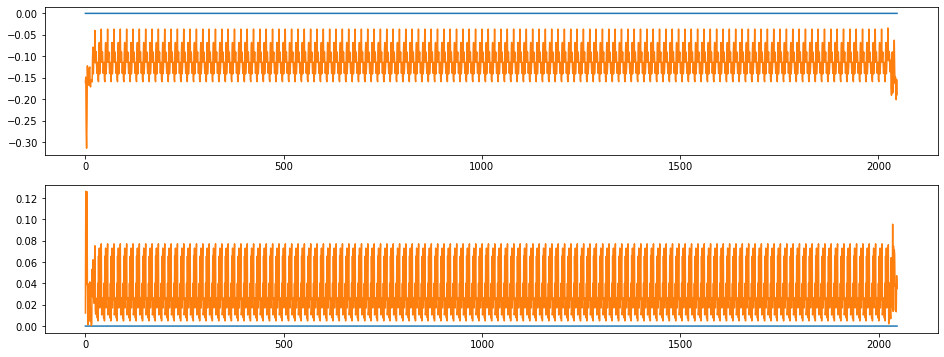

index:  357703
MAE:  0.11001883657263534
n_bunches        300
bunch_index     2202
bunch_number     231
Name: 686648, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7392/instability_data/07392_Inst_B1H_Q7_20181030_20h16m24s.h5


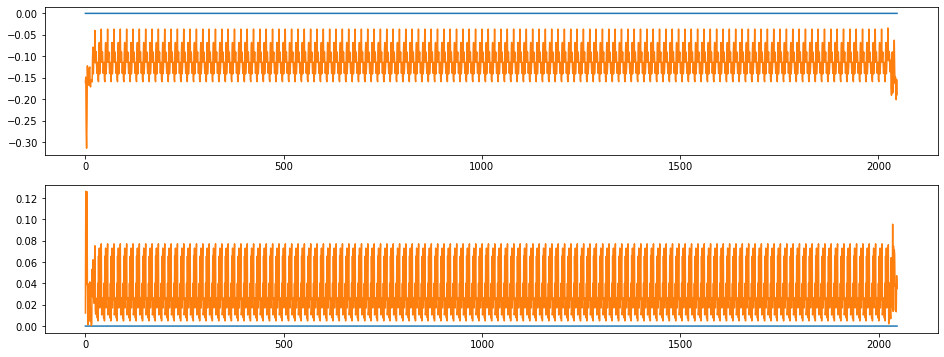

index:  67205
MAE:  0.11001883657263534
n_bunches       670
bunch_index     536
bunch_number    113
Name: 4420324, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7466/instability_data/07466_Inst_B1H_Q7_20181123_01h01m14s.h5


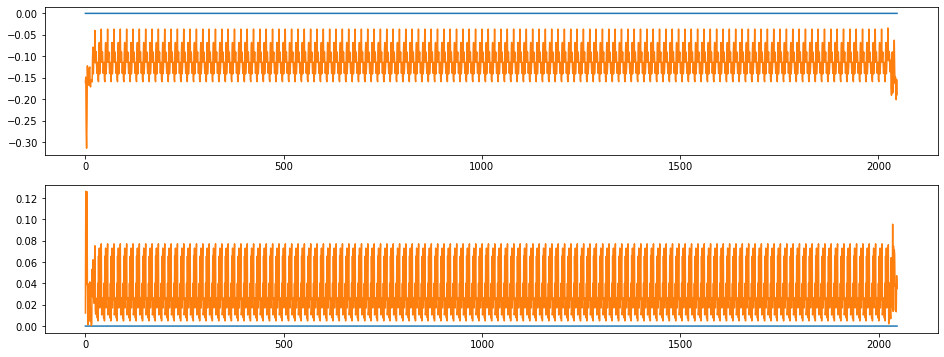

index:  231577
MAE:  0.11001883657263534
n_bunches       1868
bunch_index      391
bunch_number     203
Name: 1265430, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6346/instability_data/06346_Inst_B1H_Q7_20171029_16h19m14s.h5


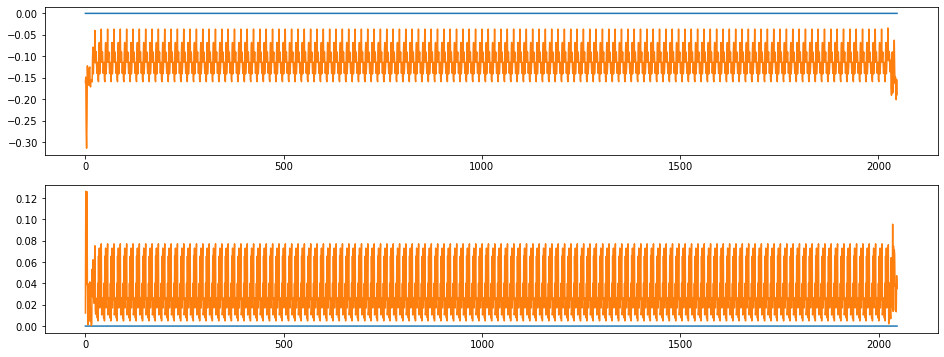

index:  159483
MAE:  0.11001883657263534
n_bunches       1116
bunch_index      698
bunch_number     128
Name: 5758962, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6587/instability_data/06587_Inst_B1H_Q7_20180421_15h00m31s.h5


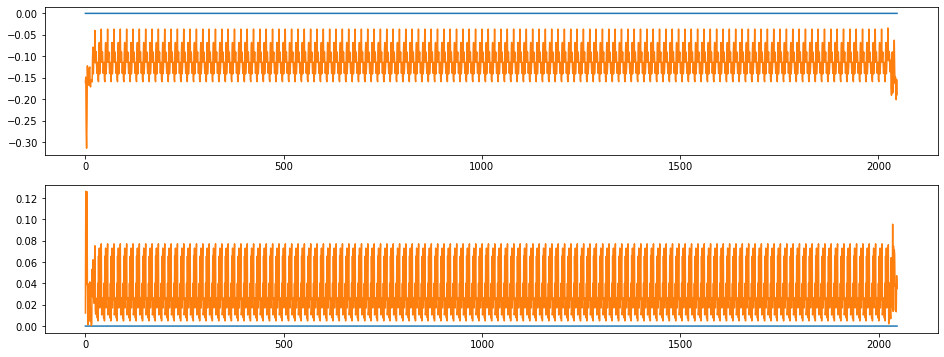

index:  354842
MAE:  0.11001883657263534
n_bunches       524
bunch_index      60
bunch_number     23
Name: 5920070, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6364/instability_data/06364_Inst_B1H_Q7_20171106_02h17m14s.h5


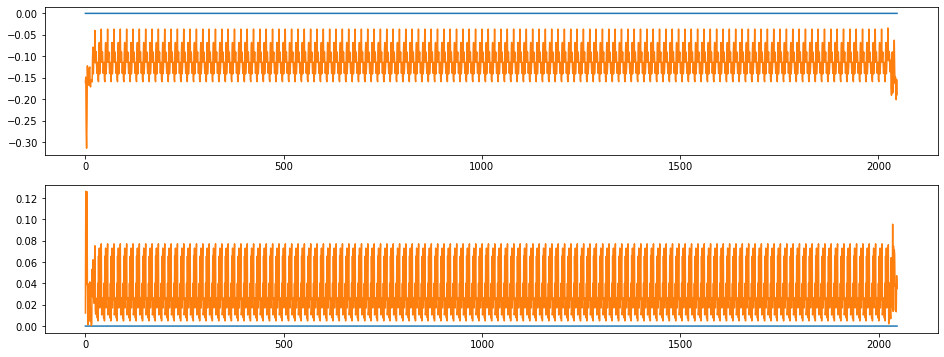

index:  297837
MAE:  0.11001883657263534
n_bunches       1916
bunch_index     1539
bunch_number     848
Name: 1159784, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6243/instability_data/06243_Inst_B1H_Q7_20170926_08h39m14s.h5


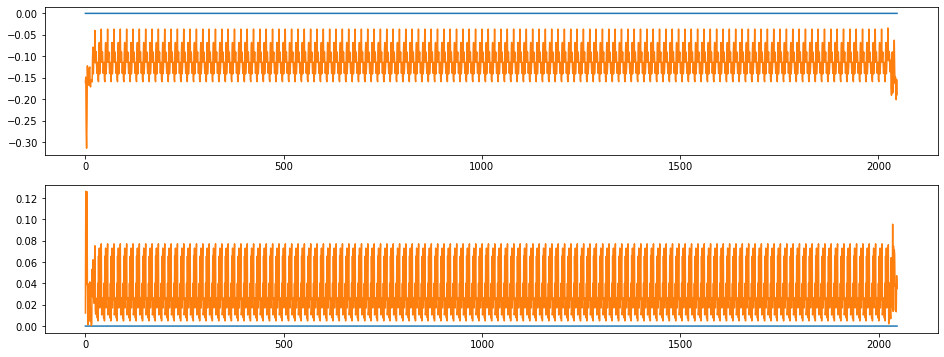

index:  62116
MAE:  0.11001883657263534
n_bunches       924
bunch_index     466
bunch_number    327
Name: 872961, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6931/instability_data/06931_Inst_B1H_Q7_20180716_16h33m06s.h5


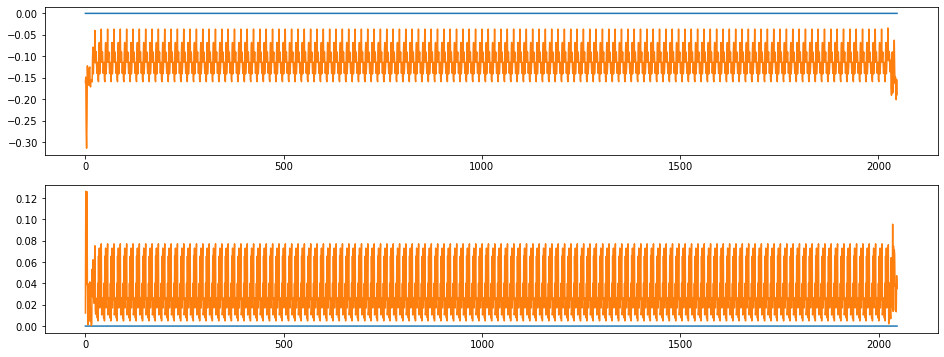

index:  8399
MAE:  0.11001883657263534
n_bunches        602
bunch_index     2051
bunch_number     586
Name: 1476394, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6939/instability_data/06939_Inst_B1H_Q7_20180717_23h37m05s.h5


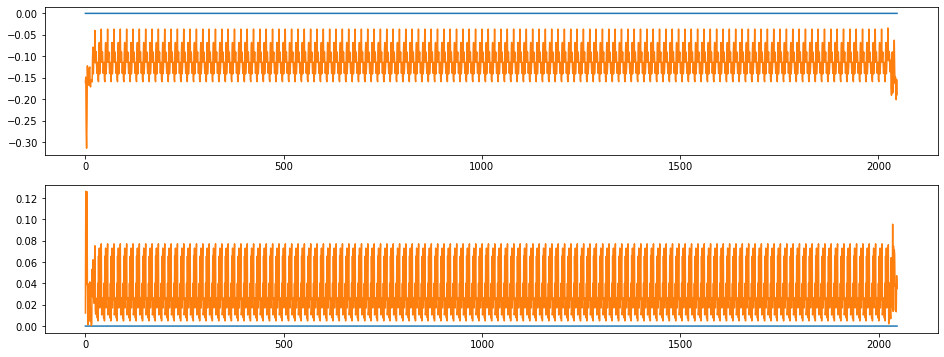

index:  286385
MAE:  0.11001883657263534
n_bunches       1916
bunch_index     1731
bunch_number     955
Name: 3289311, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6255/instability_data/06255_Inst_B1H_Q7_20170929_17h05m15s.h5


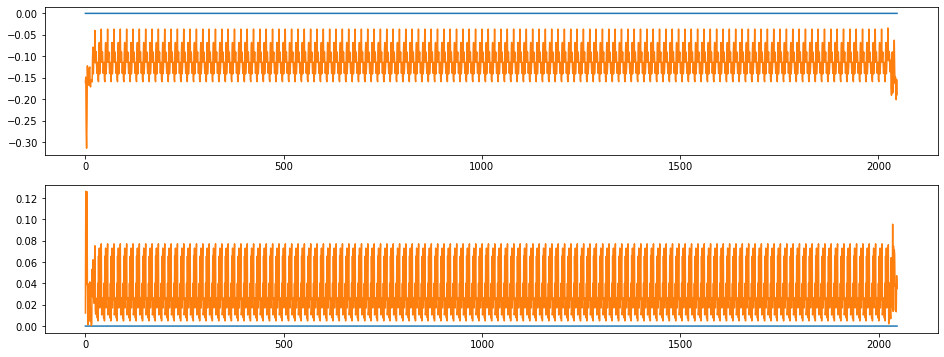

index:  33946
MAE:  0.11001883657263534
n_bunches       652
bunch_index     883
bunch_number    467
Name: 5765383, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6351/instability_data/06351_Inst_B1H_Q7_20171031_15h15m14s.h5


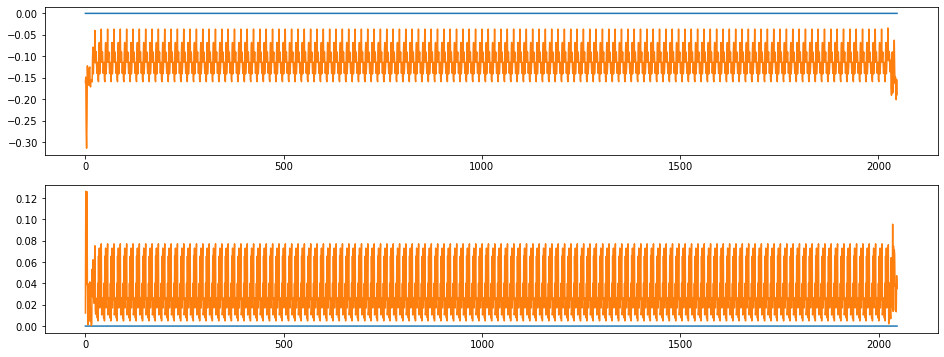

index:  363132
MAE:  0.11001883657263534
n_bunches       652
bunch_index     411
bunch_number    212
Name: 6593356, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6362/instability_data/06362_Inst_B1H_Q7_20171104_17h35m15s.h5


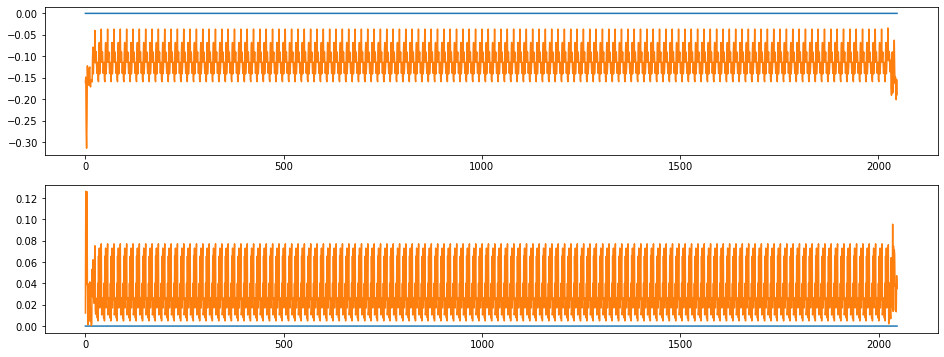

index:  156176
MAE:  0.11001883657263534
n_bunches       2556
bunch_index      633
bunch_number     449
Name: 9518567, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7310/instability_data/07310_Inst_B1H_Q7_20181017_08h06m02s.h5


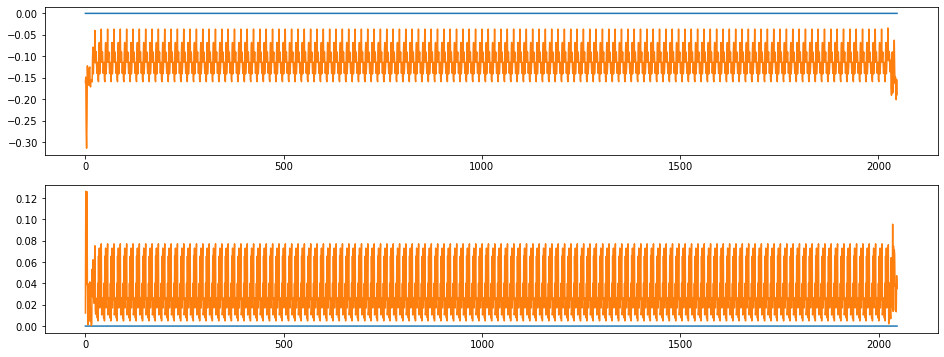

index:  344431
MAE:  0.11001883657263534
n_bunches       684
bunch_index     651
bunch_number    339
Name: 6661566, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h26m42s.h5


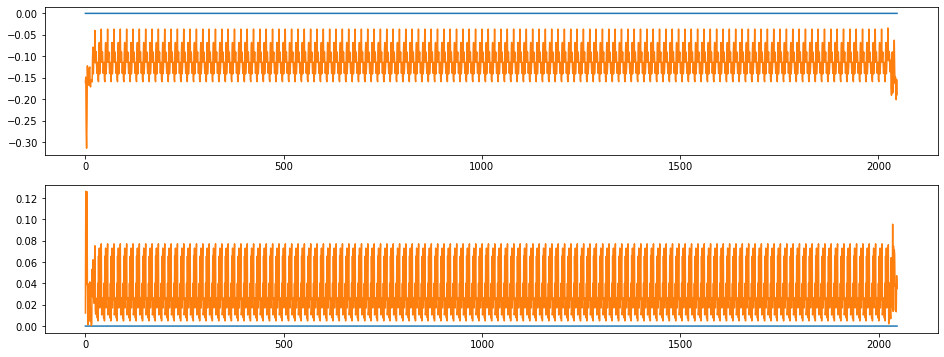

index:  134070
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     1722
bunch_number    1267
Name: 11275348, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6923/instability_data/06923_Inst_B1H_Q7_20180715_01h00m14s.h5


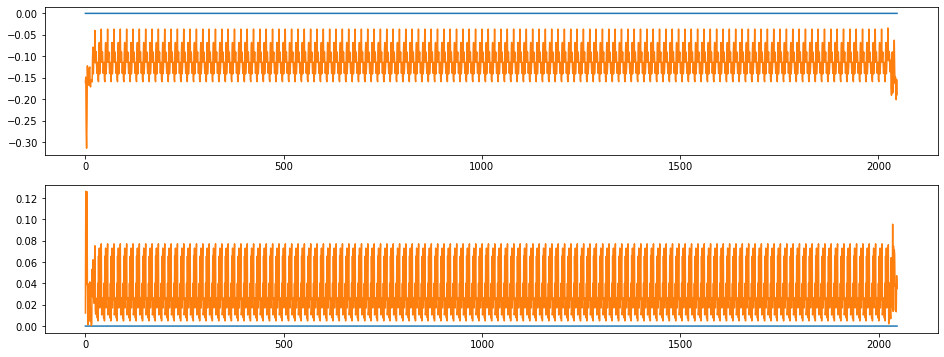

index:  149220
MAE:  0.11001883657263534
n_bunches       142
bunch_index     410
bunch_number     72
Name: 10914942, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6984/instability_data/06984_Inst_B1H_Q7_20180726_20h27m49s.h5


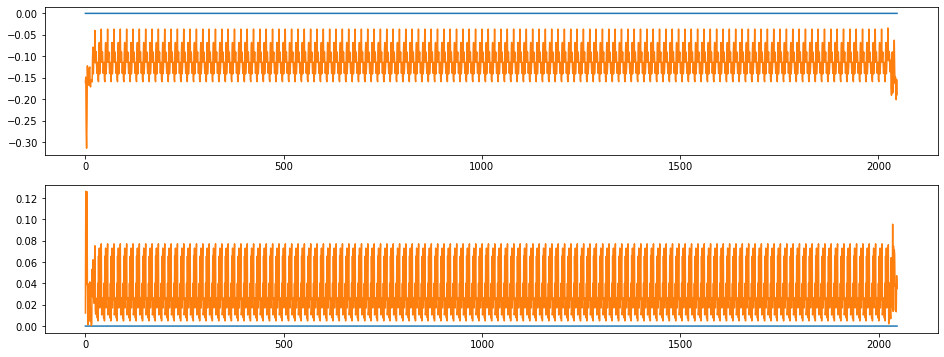

index:  58929
MAE:  0.11001883657263534
n_bunches       1868
bunch_index     2640
bunch_number    1407
Name: 9098537, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6349/instability_data/06349_Inst_B1H_Q7_20171031_05h35m13s.h5


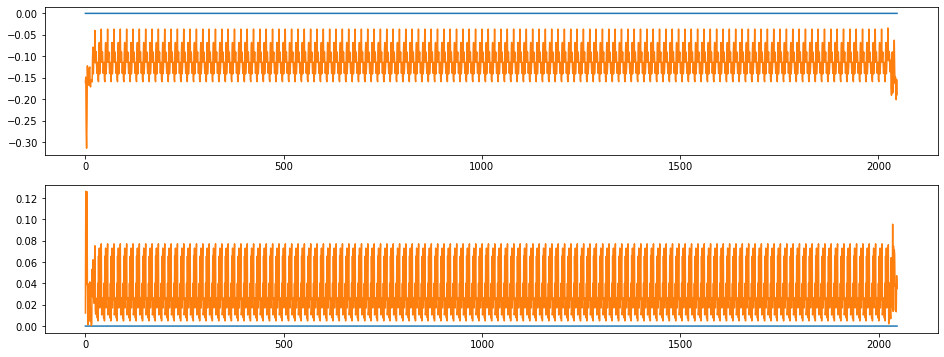

index:  145932
MAE:  0.11001883657263534
n_bunches       396
bunch_index     278
bunch_number    184
Name: 1220340, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6776/instability_data/06776_Inst_B1H_Q7_20180611_16h53m34s.h5


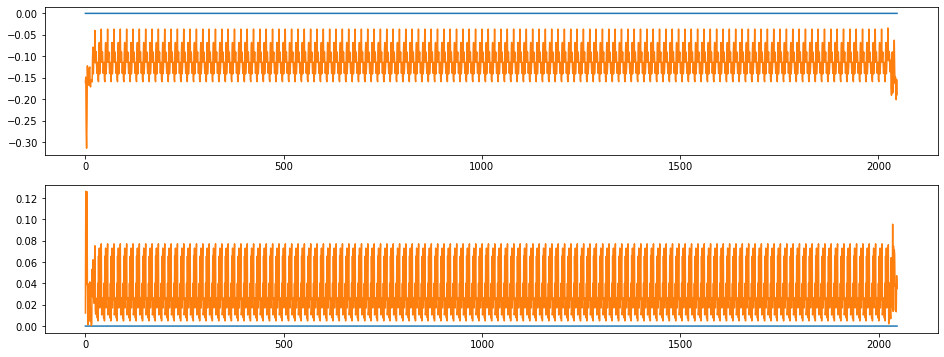

index:  159541
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     1033
bunch_number     736
Name: 7959454, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6709/instability_data/06709_Inst_B1H_Q7_20180521_00h47m14s.h5


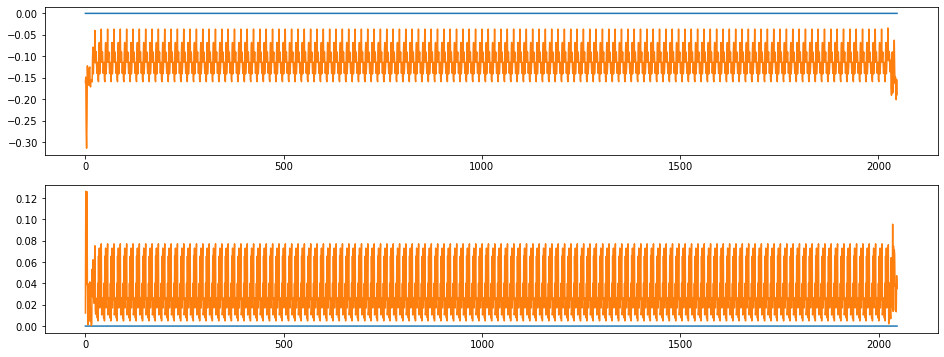

index:  314297
MAE:  0.11001883657263534
n_bunches       1227
bunch_index      480
bunch_number     206
Name: 4458649, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_10h52m14s.h5


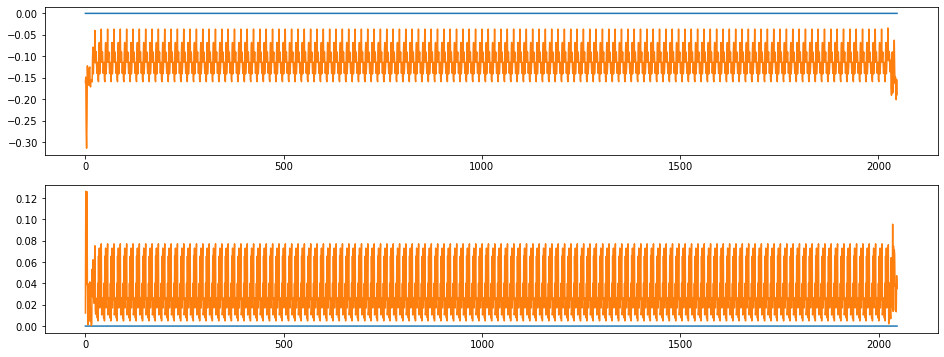

index:  352579
MAE:  0.11001883657263534
n_bunches        733
bunch_index     2306
bunch_number     488
Name: 4709484, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7485/instability_data/07485_Inst_B1H_Q7_20181129_23h40m14s.h5


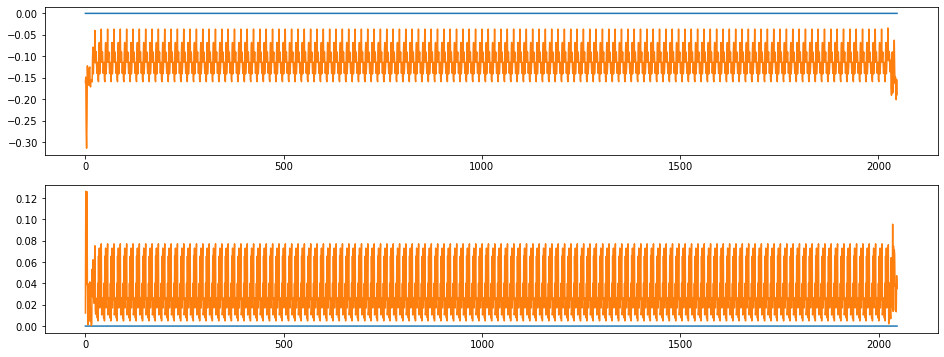

index:  373156
MAE:  0.11001883657263534
n_bunches       336
bunch_index     105
bunch_number     14
Name: 11329937, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7447/instability_data/07447_Inst_B1H_Q7_20181116_04h57m15s.h5


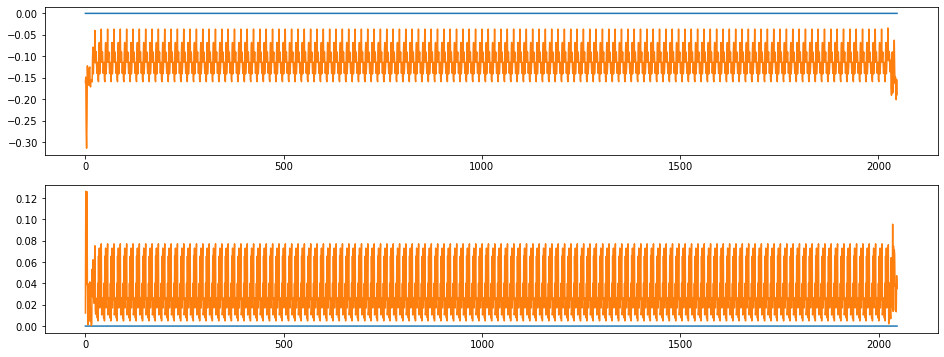

index:  311620
MAE:  0.11001883657263534
n_bunches        987
bunch_index     3145
bunch_number     864
Name: 215905, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6901/instability_data/06901_Inst_B1H_Q7_20180708_04h11m22s.h5


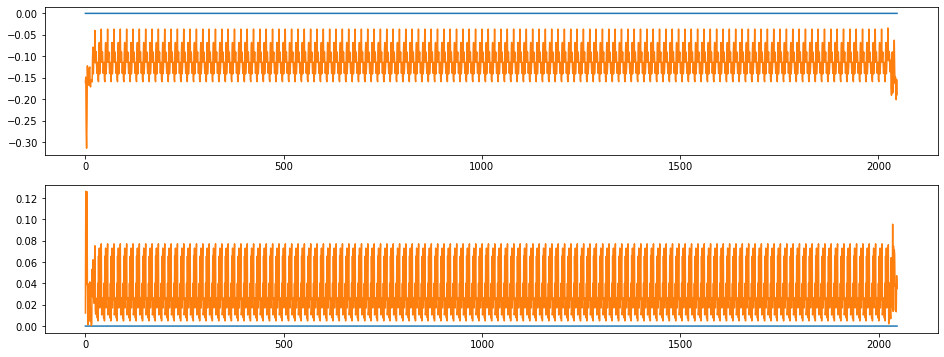

index:  100368
MAE:  0.11001883657263534
n_bunches       313
bunch_index     934
bunch_number    192
Name: 1881521, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7487/instability_data/07487_Inst_B1H_Q7_20181130_18h53m53s.h5


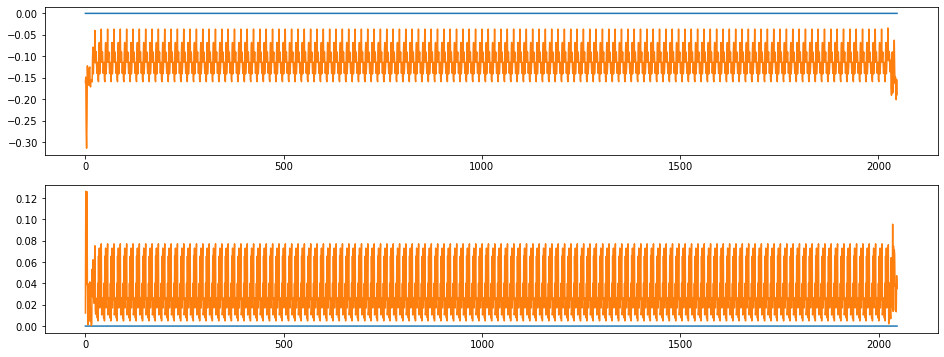

index:  145907
MAE:  0.11001883657263534
n_bunches       1836
bunch_index     1441
bunch_number     769
Name: 2374884, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6271/instability_data/06271_Inst_B1H_Q7_20171004_11h55m07s.h5


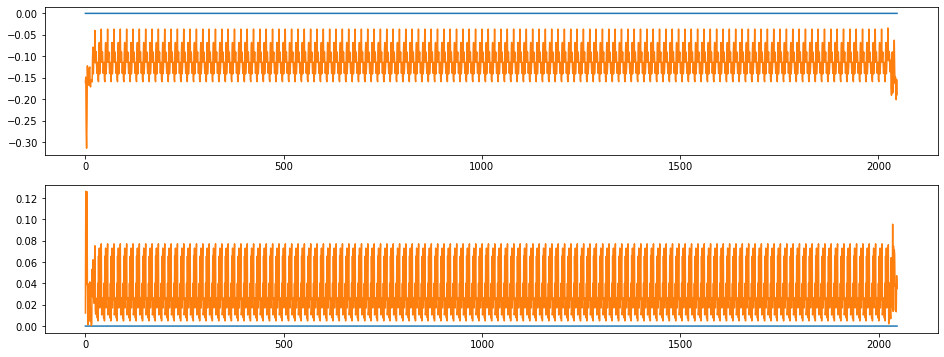

index:  259907
MAE:  0.11001883657263534
n_bunches       780
bunch_index     790
bunch_number    564
Name: 2660315, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7235/instability_data/07235_Inst_B1H_Q7_20180929_17h14m45s.h5


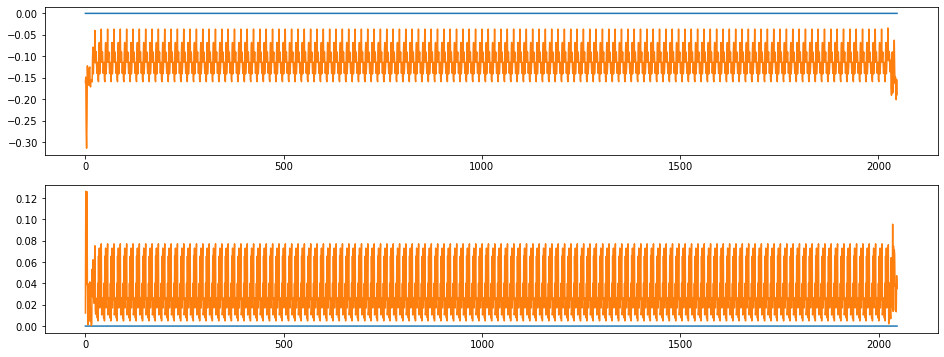

index:  50635
MAE:  0.11001883657263534
n_bunches       1868
bunch_index      252
bunch_number     130
Name: 10619595, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6283/instability_data/06283_Inst_B1H_Q7_20171008_06h08m14s.h5


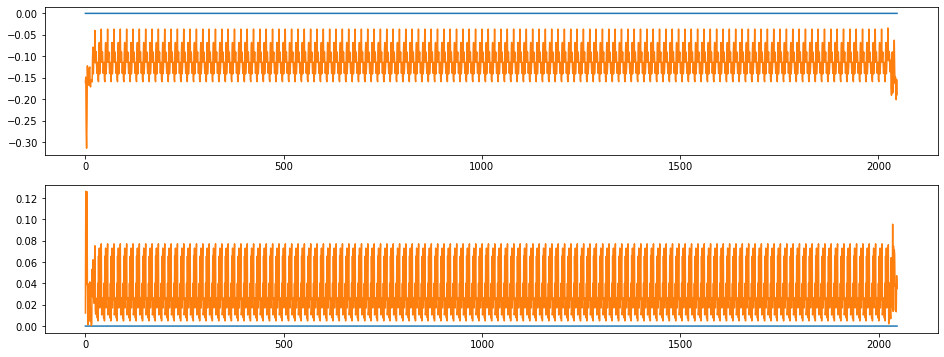

index:  217041
MAE:  0.11001883657263534
n_bunches       1868
bunch_index     2368
bunch_number    1272
Name: 7229687, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6358/instability_data/06358_Inst_B1H_Q7_20171102_19h22m14s.h5


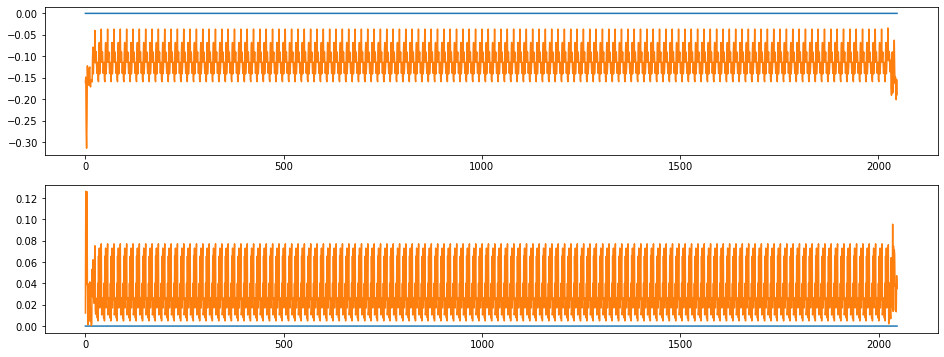

index:  190778
MAE:  0.11001883657263534
n_bunches       1868
bunch_index     2073
bunch_number    1116
Name: 4828488, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6364/instability_data/06364_Inst_B1H_Q7_20171106_11h20m14s.h5


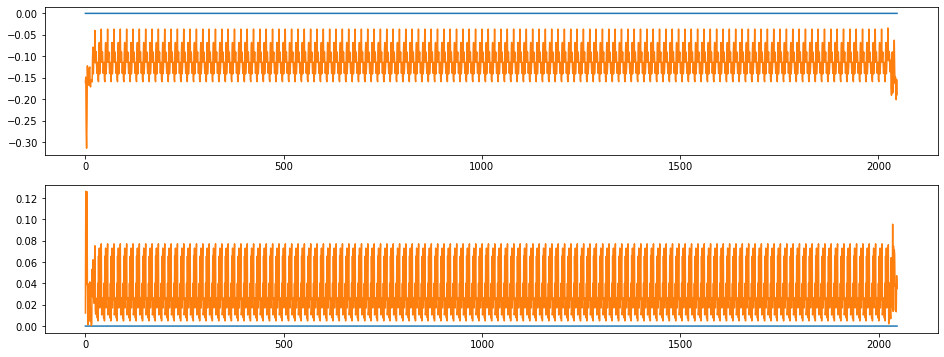

index:  168485
MAE:  0.11001883657263534
n_bunches       157
bunch_index     237
bunch_number     50
Name: 7999493, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6799/instability_data/06799_Inst_B1H_Q7_20180615_09h25m15s.h5


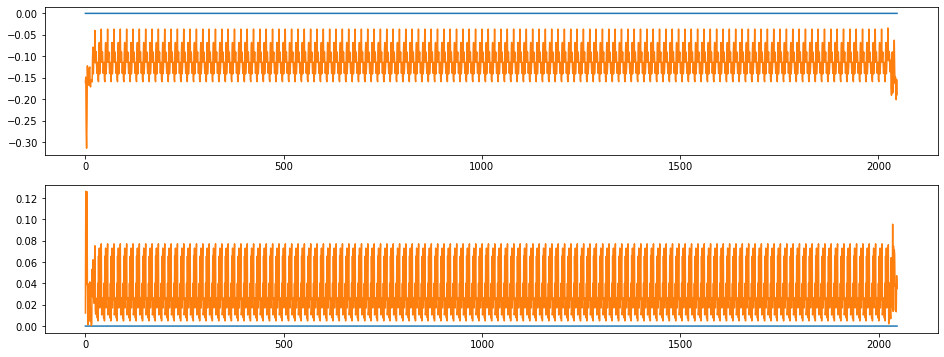

index:  203872
MAE:  0.11001883657263534
n_bunches       908
bunch_index     839
bunch_number    438
Name: 2690789, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6363/instability_data/06363_Inst_B1H_Q7_20171105_20h56m14s.h5


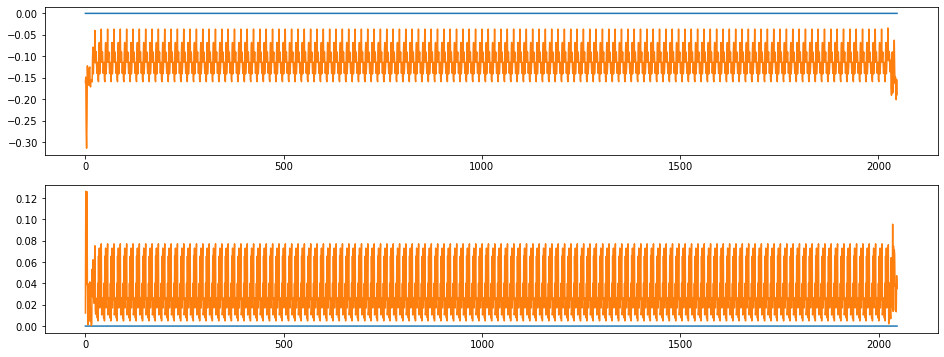

index:  12655
MAE:  0.11001883657263534
n_bunches       652
bunch_index     391
bunch_number    203
Name: 6677489, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6349/instability_data/06349_Inst_B1H_Q7_20171031_04h19m07s.h5


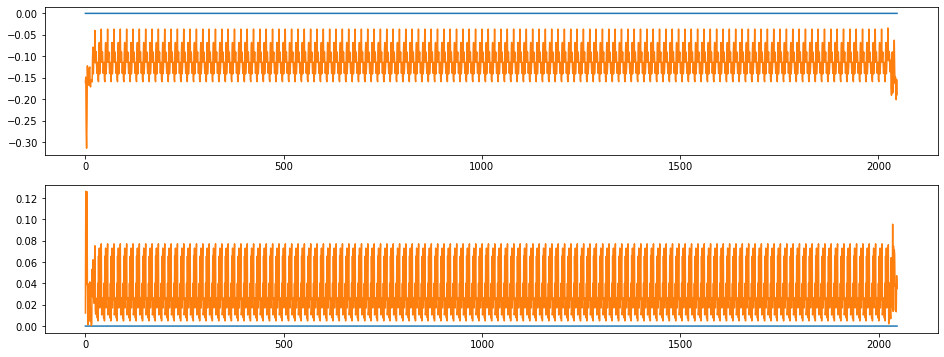

index:  42180
MAE:  0.11001883657263534
n_bunches       670
bunch_index     878
bunch_number    184
Name: 7311021, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7466/instability_data/07466_Inst_B1H_Q7_20181122_20h54m20s.h5


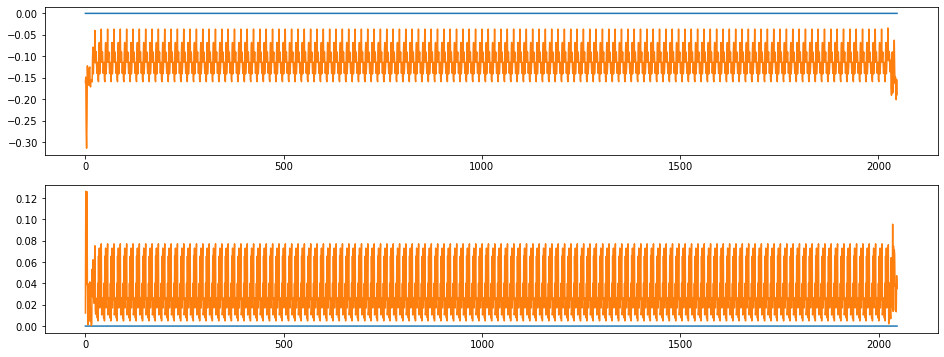

index:  142934
MAE:  0.11001883657263534
n_bunches       1452
bunch_index      858
bunch_number     352
Name: 5857540, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6892/instability_data/06892_Inst_B1H_Q7_20180707_11h23m15s.h5


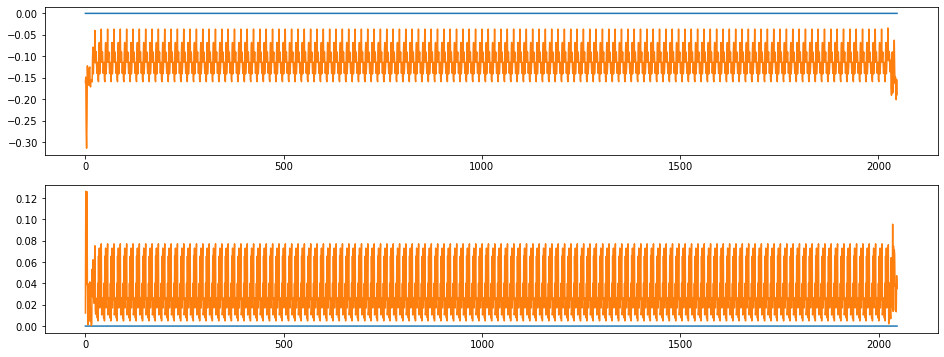

index:  151374
MAE:  0.11001883657263534
n_bunches        733
bunch_index     1200
bunch_number     252
Name: 6441939, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_10h46m13s.h5


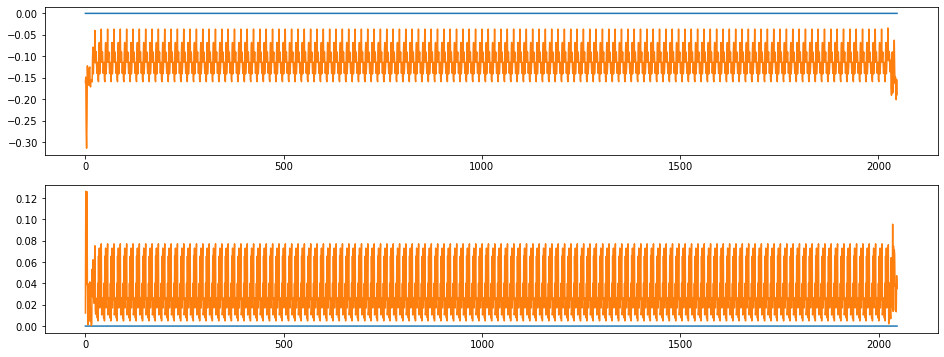

index:  14408
MAE:  0.11001883657263534
n_bunches       2556
bunch_index      592
bunch_number     396
Name: 6394883, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6762/instability_data/06762_Inst_B1H_Q7_20180606_15h34m15s.h5


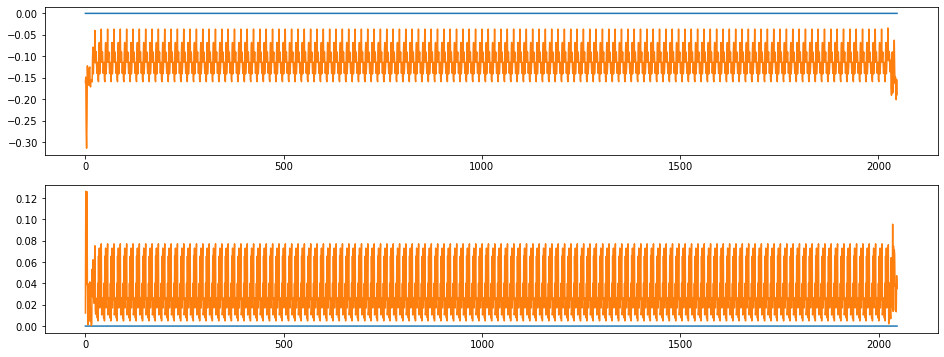

index:  314364
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     1562
bunch_number    1137
Name: 6202918, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6654/instability_data/06654_Inst_B1H_Q7_20180508_02h13m14s.h5


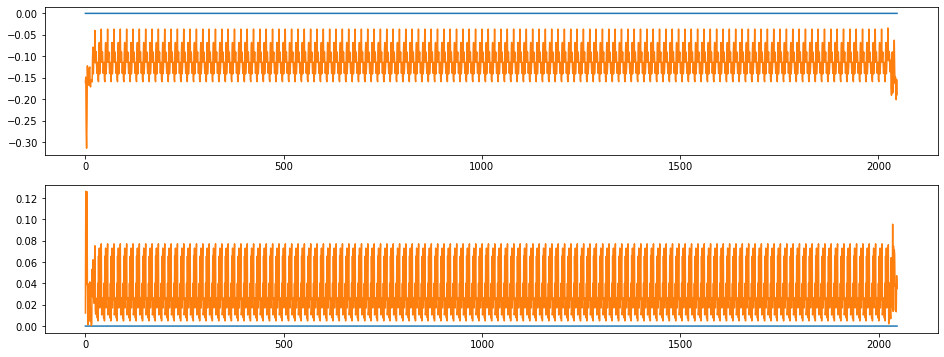

index:  168528
MAE:  0.11001883657263534
n_bunches       1868
bunch_index     1483
bunch_number     797
Name: 10084965, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6343/instability_data/06343_Inst_B1H_Q7_20171028_13h33m14s.h5


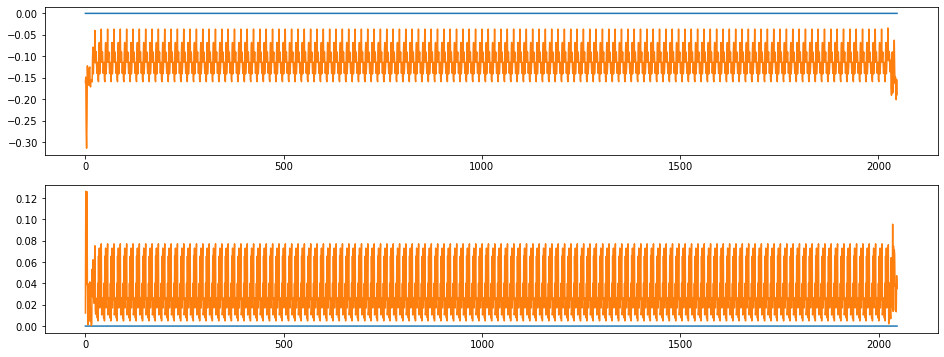

index:  30001
MAE:  0.11001883657263534
n_bunches        648
bunch_index     2832
bunch_number     530
Name: 241968, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_08h16m16s.h5


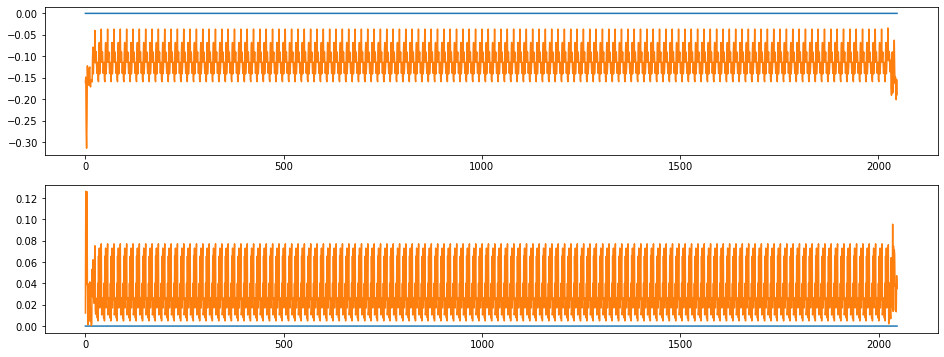

index:  288351
MAE:  0.11001883657263534
n_bunches       1836
bunch_index     1418
bunch_number     754
Name: 3278403, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_14h12m14s.h5


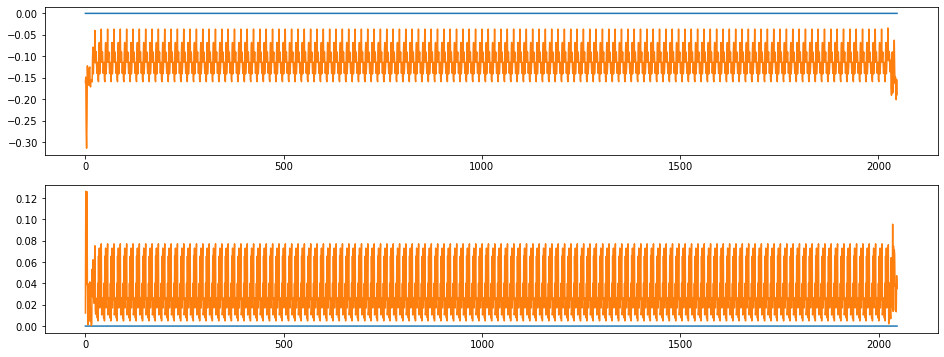

index:  303132
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     3176
bunch_number    2352
Name: 4221947, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6759/instability_data/06759_Inst_B1H_Q7_20180605_00h51m14s.h5


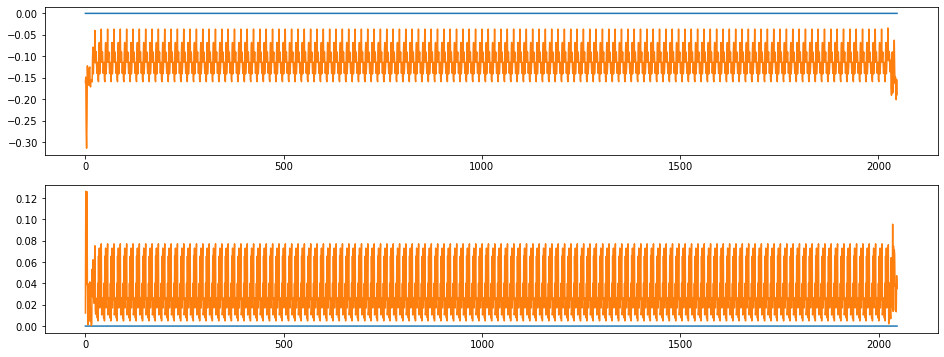

index:  131249
MAE:  0.11001883657263534
n_bunches       1308
bunch_index      643
bunch_number     459
Name: 8461217, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6936/instability_data/06936_Inst_B1H_Q7_20180717_15h14m13s.h5


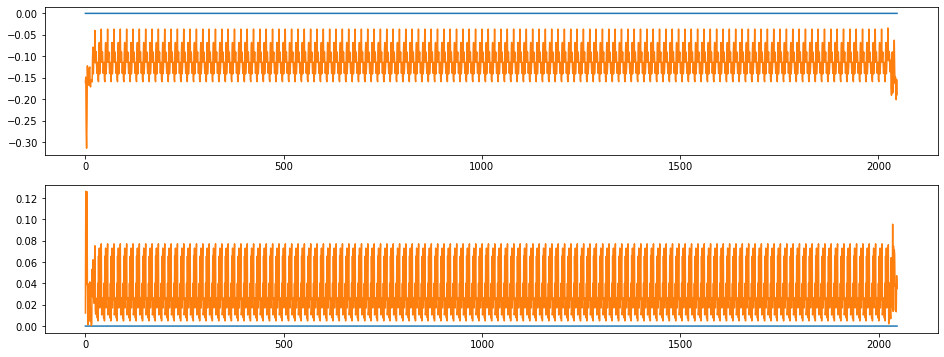

index:  105762
MAE:  0.11001883657263534
n_bunches       588
bunch_index     809
bunch_number    343
Name: 9061975, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6805/instability_data/06805_Inst_B1H_Q7_20180616_02h04m05s.h5


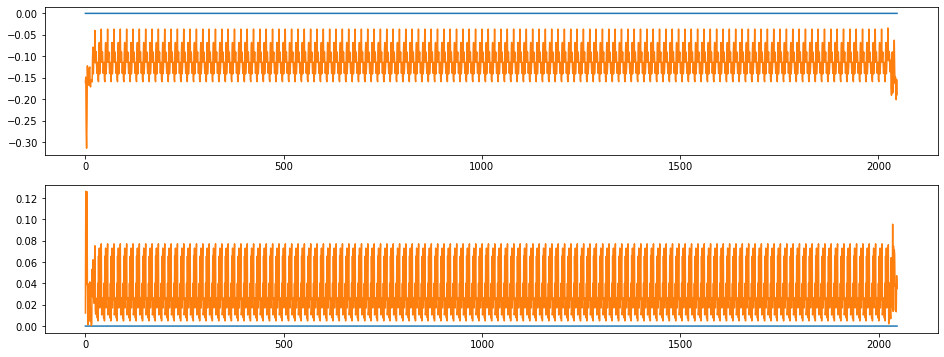

index:  360146
MAE:  0.11001883657263534
n_bunches       1887
bunch_index     1406
bunch_number     848
Name: 9080589, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6693/instability_data/06693_Inst_B1H_Q7_20180516_21h47m13s.h5


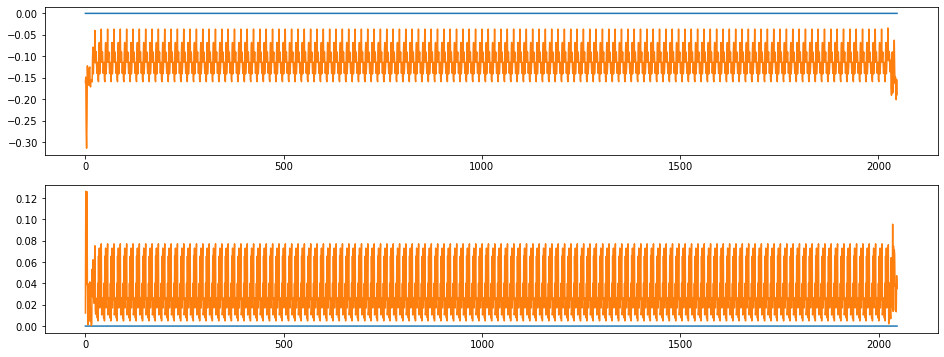

index:  281258
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     2430
bunch_number    1802
Name: 2422924, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6921/instability_data/06921_Inst_B1H_Q7_20180714_16h39m14s.h5


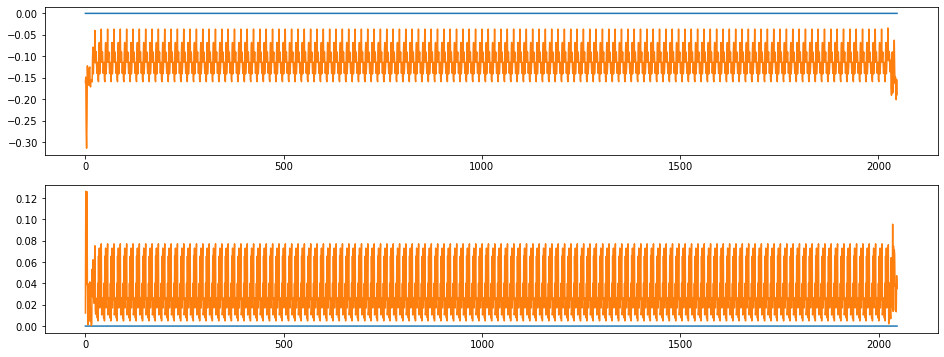

index:  224874
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     1224
bunch_number     882
Name: 3666058, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6761/instability_data/06761_Inst_B1H_Q7_20180606_04h35m14s.h5


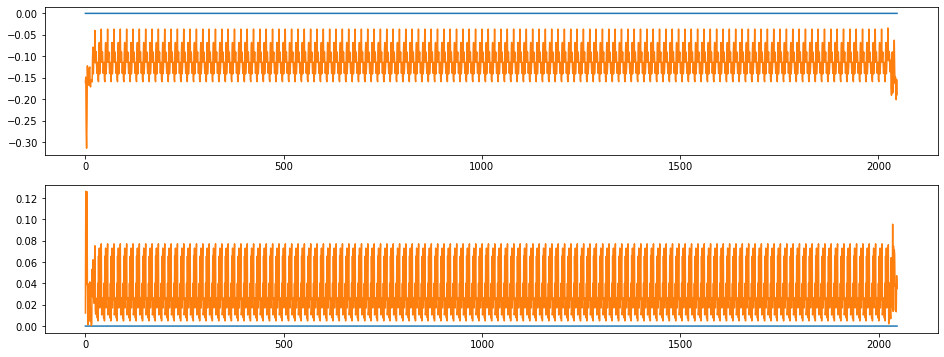

index:  255103
MAE:  0.11001883657263534
n_bunches       2556
bunch_index      939
bunch_number     656
Name: 10288200, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6709/instability_data/06709_Inst_B1H_Q7_20180520_23h50m14s.h5


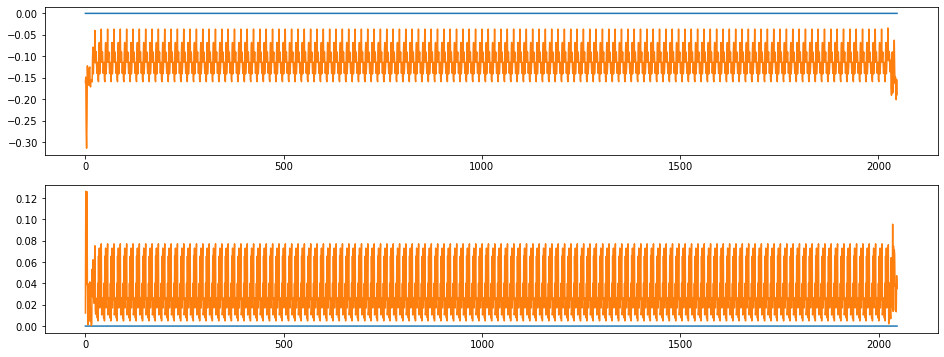

index:  137631
MAE:  0.11001883657263534
n_bunches       300
bunch_index     196
bunch_number     69
Name: 5758283, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6891/instability_data/06891_Inst_B1H_Q7_20180706_14h51m14s.h5


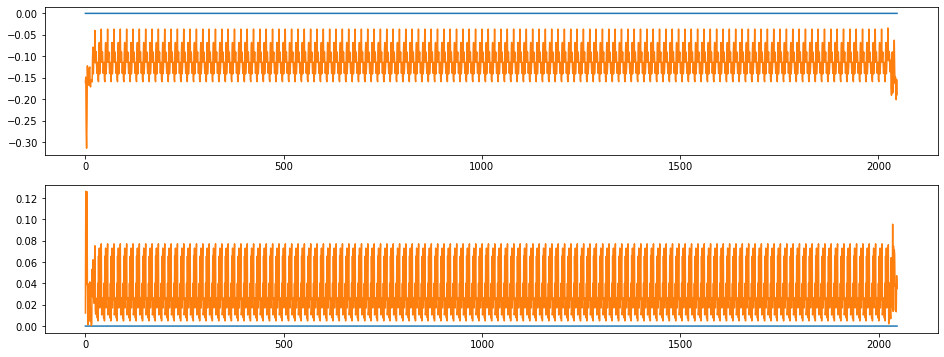

index:  287085
MAE:  0.11001883657263534
n_bunches        632
bunch_index     1041
bunch_number     191
Name: 10407733, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7443/instability_data/07443_Inst_B1H_Q7_20181114_18h02m14s.h5


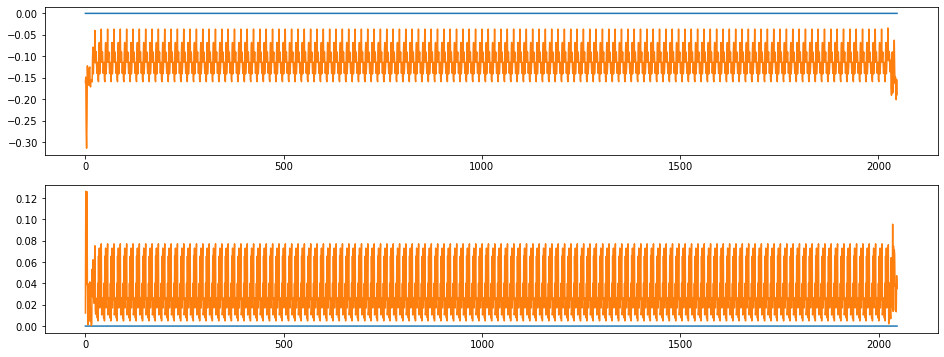

index:  306799
MAE:  0.11001883657263534
n_bunches        576
bunch_index     1024
bunch_number     188
Name: 6400383, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7452/instability_data/07452_Inst_B1H_Q7_20181117_16h31m14s.h5


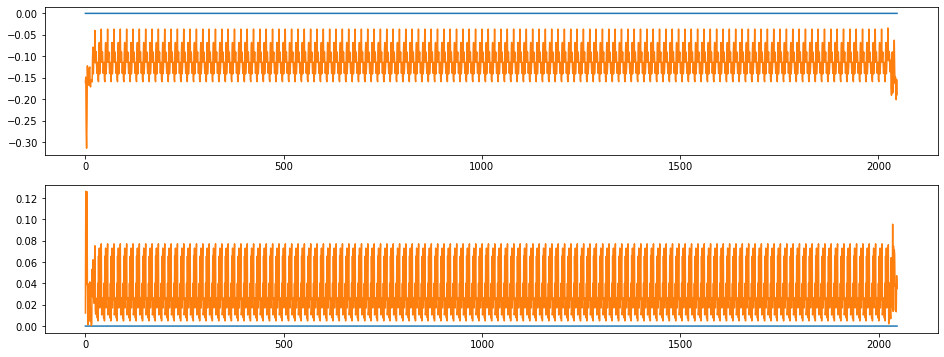

index:  331460
MAE:  0.11001883657263534
n_bunches       376
bunch_index     721
bunch_number    153
Name: 3734659, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7485/instability_data/07485_Inst_B1H_Q7_20181129_20h08m09s.h5


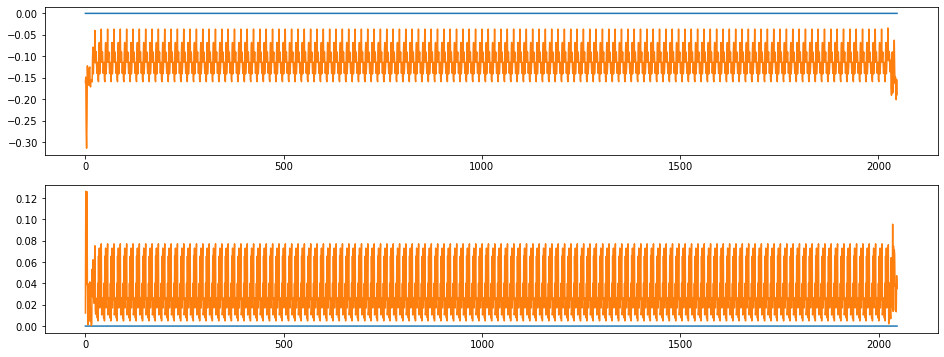

index:  100673
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     1303
bunch_number     949
Name: 3923207, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_03h50m14s.h5


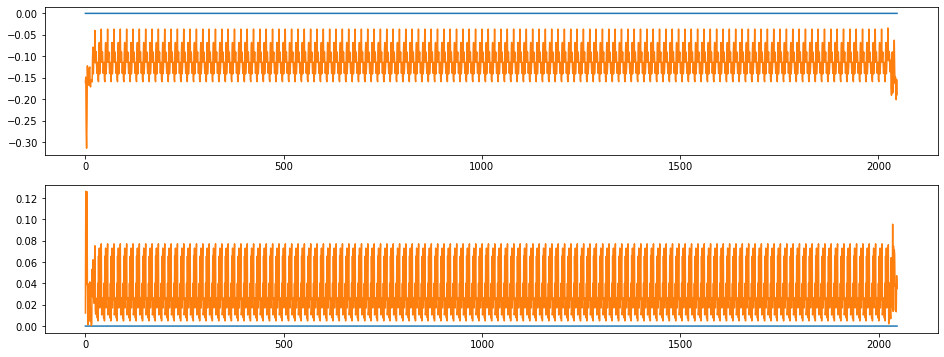

index:  288606
MAE:  0.11001883657263534
n_bunches        780
bunch_index     1029
bunch_number     751
Name: 9076890, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6789/instability_data/06789_Inst_B1H_Q7_20180613_23h49m24s.h5


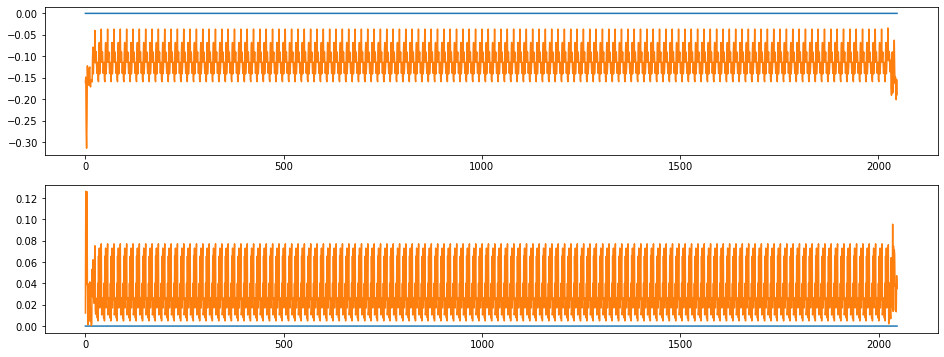

index:  289698
MAE:  0.11001883657263534
n_bunches        408
bunch_index     1006
bunch_number      97
Name: 4605122, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6436/instability_data/06436_Inst_B1H_Q7_20171130_03h20m34s.h5


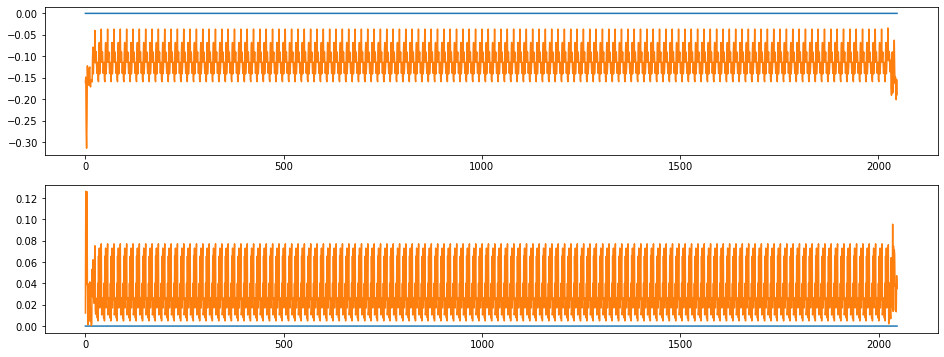

index:  231268
MAE:  0.11001883657263534
n_bunches       780
bunch_index     284
bunch_number    190
Name: 9746179, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7252/instability_data/07252_Inst_B1H_Q7_20181003_02h10m37s.h5


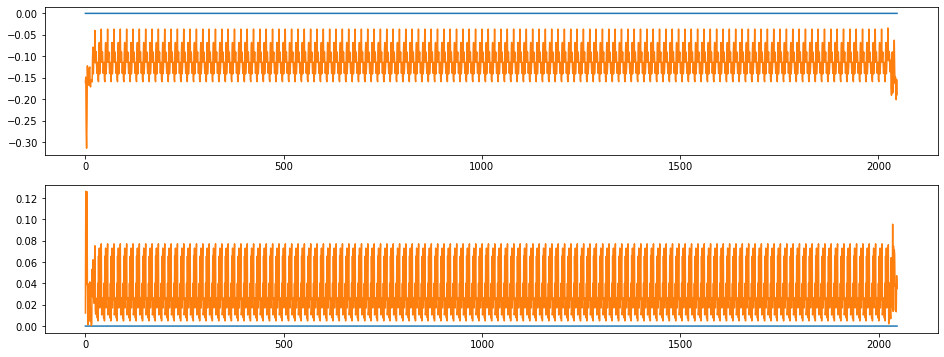

index:  165176
MAE:  0.11001883657263534
n_bunches       229
bunch_index     931
bunch_number    191
Name: 6915492, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7489/instability_data/07489_Inst_B1H_Q7_20181201_17h12m15s.h5


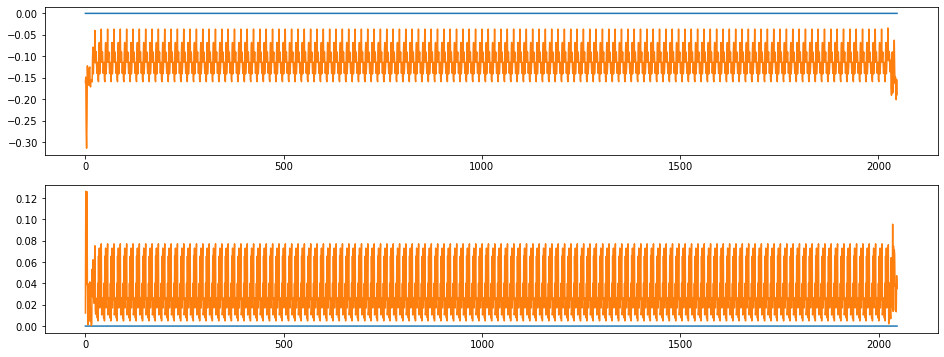

index:  15385
MAE:  0.11001883657263534
n_bunches       1836
bunch_index     2707
bunch_number    1446
Name: 5642018, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6266/instability_data/06266_Inst_B1H_Q7_20171002_19h22m25s.h5


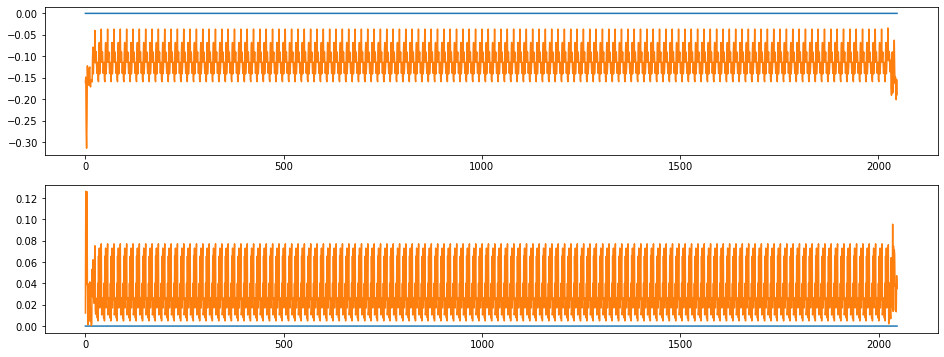

index:  403336
MAE:  0.11001883657263534
n_bunches        460
bunch_index     2437
bunch_number     316
Name: 3359938, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7464/instability_data/07464_Inst_B1H_Q7_20181122_03h28m14s.h5


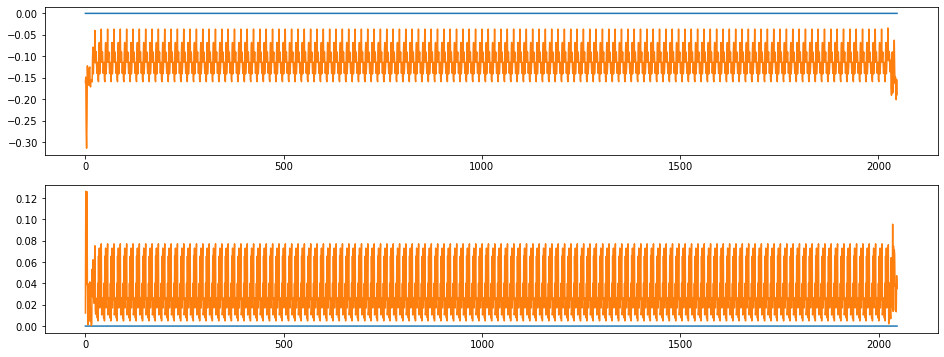

index:  280752
MAE:  0.11001883657263534
n_bunches        228
bunch_index     1678
bunch_number     149
Name: 9493677, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6220/instability_data/06220_Inst_B1H_Q7_20170917_21h28m14s.h5


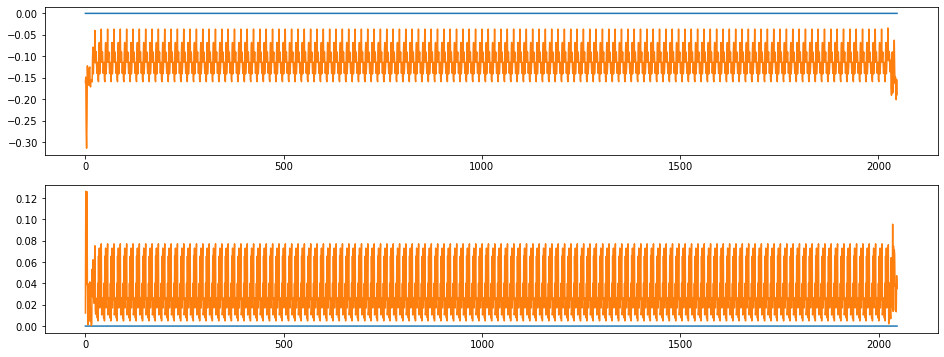

index:  74920
MAE:  0.11001883657263534
n_bunches        502
bunch_index     2213
bunch_number     465
Name: 7156023, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7475/instability_data/07475_Inst_B1H_Q7_20181126_17h07m14s.h5


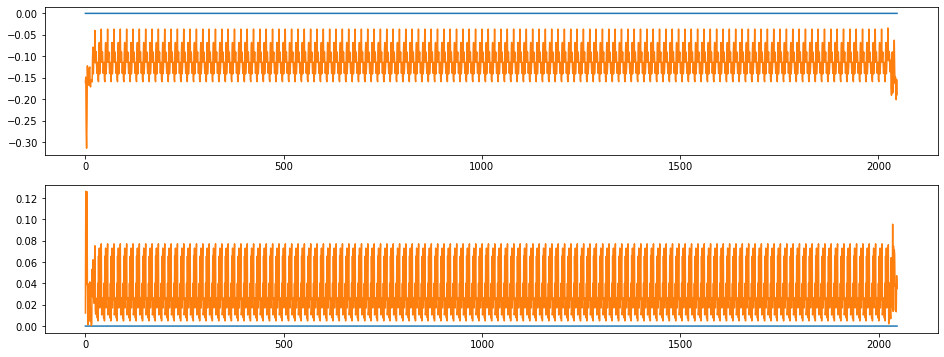

index:  373814
MAE:  0.11001883657263534
n_bunches       1836
bunch_index     3275
bunch_number    1740
Name: 10927416, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_09h52m14s.h5


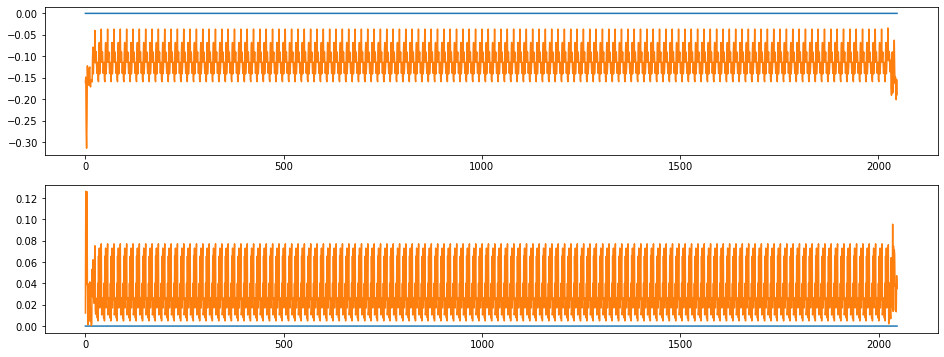

index:  58579
MAE:  0.11001883657263534
n_bunches       2556
bunch_index     1259
bunch_number     917
Name: 11271867, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6654/instability_data/06654_Inst_B1H_Q7_20180508_01h55m19s.h5


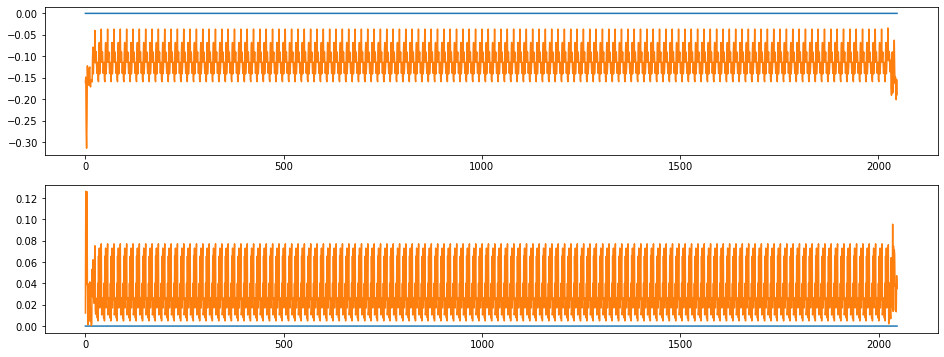

index:  147625
MAE:  0.11001883657263534
n_bunches       108
bunch_index      98
bunch_number     49
Name: 2862906, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7328/instability_data/07328_Inst_B1H_Q7_20181021_21h51m28s.h5


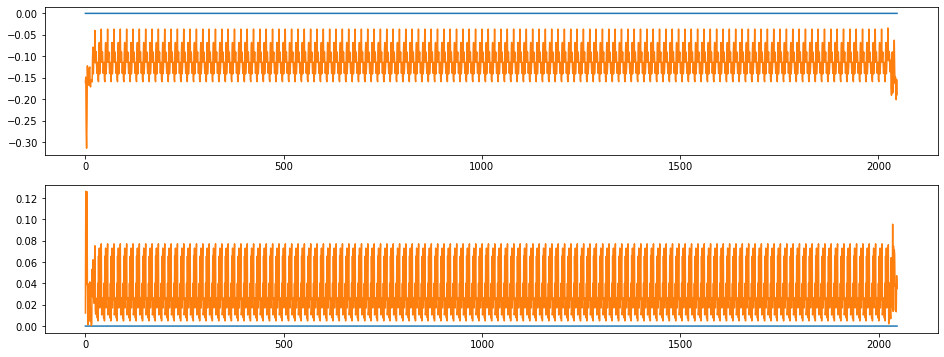

index:  156004
MAE:  0.11001883657263534
n_bunches       2556
bunch_index      698
bunch_number     507
Name: 5385443, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7031/instability_data/07031_Inst_B1H_Q7_20180806_18h16m15s.h5


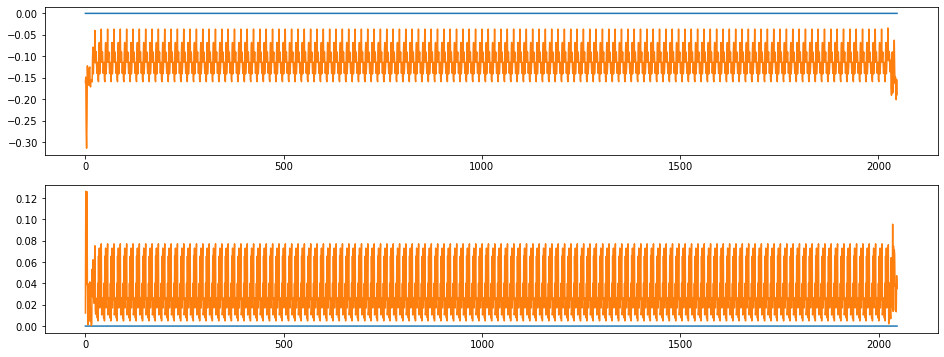

index:  168988
MAE:  0.11001883657263534
n_bunches       1836
bunch_index     3419
bunch_number    1824
Name: 8125601, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6392/instability_data/06392_Inst_B1H_Q7_20171116_08h15m13s.h5


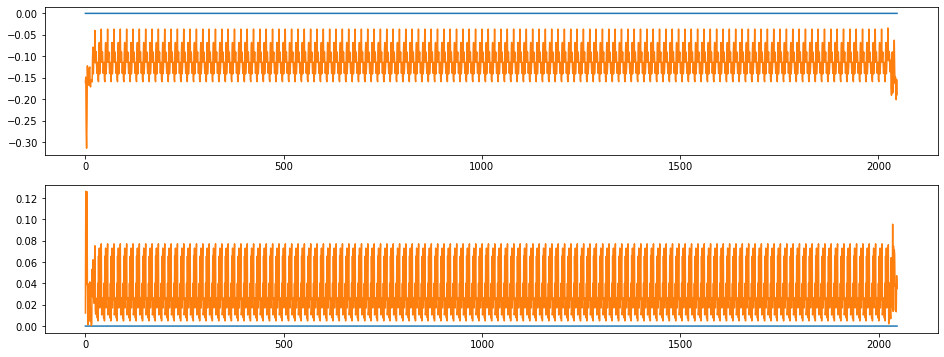

index:  107618
MAE:  0.11001883657263534
n_bunches       1868
bunch_index     2379
bunch_number    1279
Name: 9750507, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6343/instability_data/06343_Inst_B1H_Q7_20171028_18h23m14s.h5


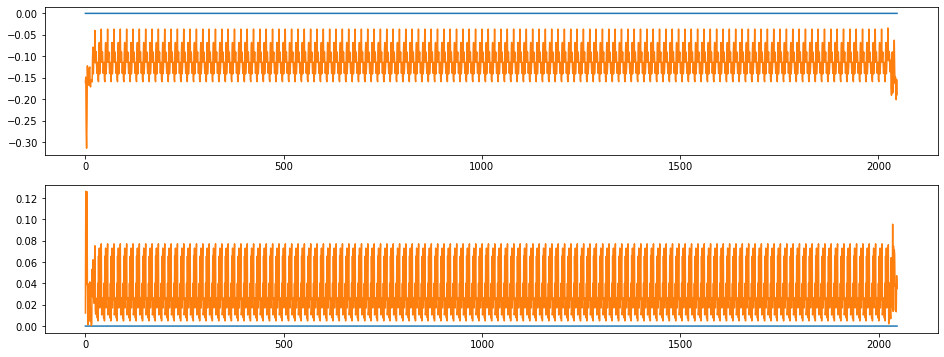

index:  33510
MAE:  0.11001883657263534
n_bunches        603
bunch_index     3110
bunch_number     569
Name: 11638355, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6849/instability_data/06849_Inst_B1H_Q7_20180626_18h39m15s.h5


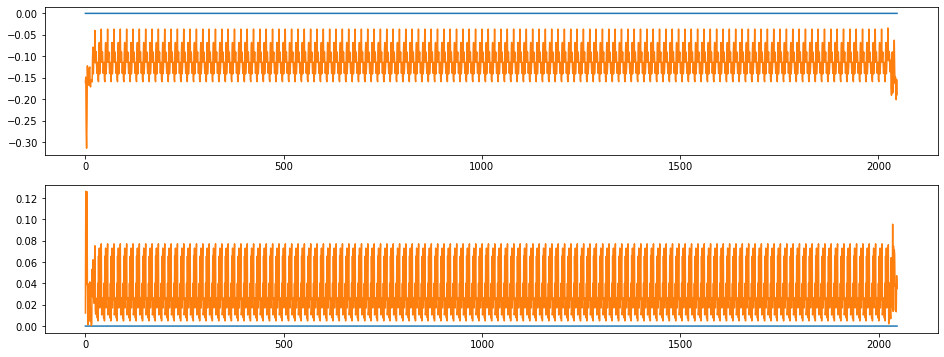

index:  231308
MAE:  0.11001883657263534
n_bunches       2175
bunch_index      513
bunch_number     361
Name: 1392975, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6694/instability_data/06694_Inst_B1H_Q7_20180517_12h50m14s.h5


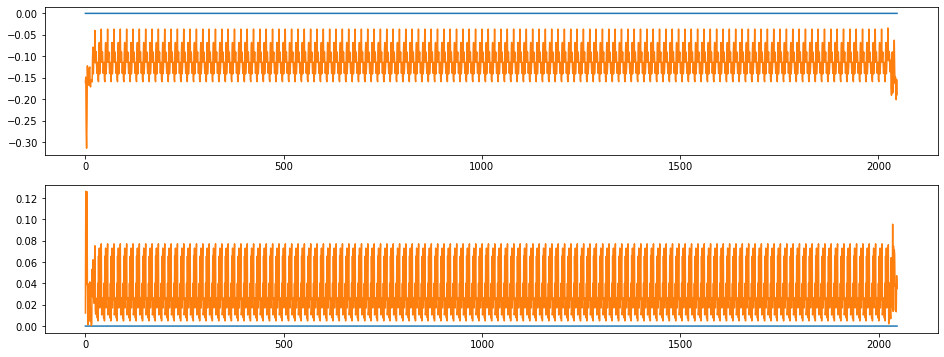

index:  302841
MAE:  0.11001883657263534
n_bunches       1868
bunch_index      653
bunch_number     350
Name: 5144403, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6364/instability_data/06364_Inst_B1H_Q7_20171107_06h38m14s.h5


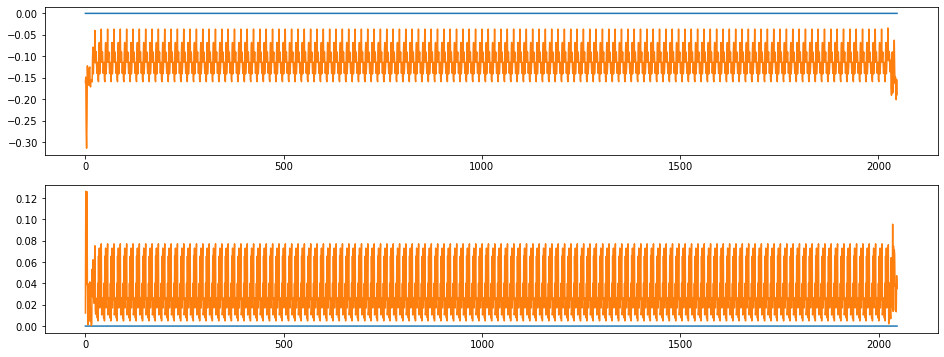

index:  231309
MAE:  0.11001883657263534
n_bunches       2175
bunch_index      513
bunch_number     361
Name: 1392975, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6694/instability_data/06694_Inst_B1H_Q7_20180517_12h50m14s.h5


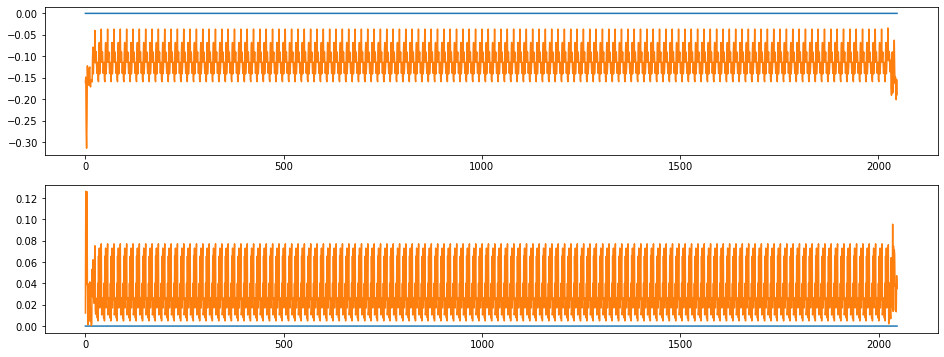

In [26]:
for i in range(1, 101):
    left_most = -i
    left_most_index = max_MAE_indices[left_most]

    print('index: ', left_most_index)
    print("MAE: ", MAE_train[left_most_index])
    # I'm not sure this row is correct
    metadata_row = train_generator.metadata.iloc[left_most_index // 32]
    print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
    print(metadata_row['file'])


    true_signal = train_dataset[left_most_index].squeeze()
    pred_signal = train_pred[left_most_index].squeeze()

    plot_true_pred(true_signal, pred_signal)
    plt.show()

# Signals around the peak

In [27]:
around_peak_indices = np.argsort(np.abs(MAE_train - hist_peak_train))

index:  265084
MAE:  0.2431221706363627
n_bunches        987
bunch_index     1493
bunch_number     504
Name: 888186, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_09h52m14s.h5


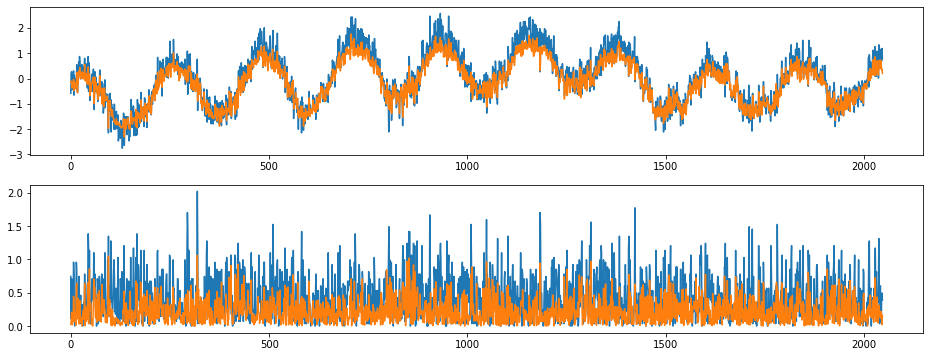

index:  161900
MAE:  0.2431223966478142
n_bunches       1227
bunch_index     2032
bunch_number     739
Name: 1143610, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_12h11m14s.h5


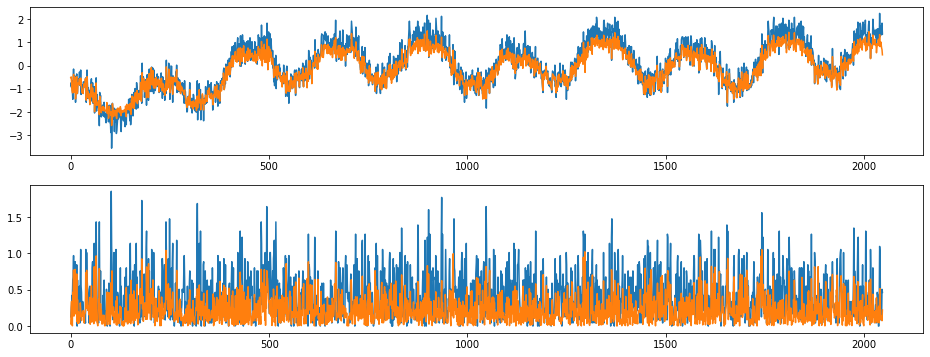

index:  192534
MAE:  0.24312158380887142
n_bunches       540
bunch_index     722
bunch_number    512
Name: 2385558, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6740/instability_data/06740_Inst_B1H_Q7_20180530_07h21m03s.h5


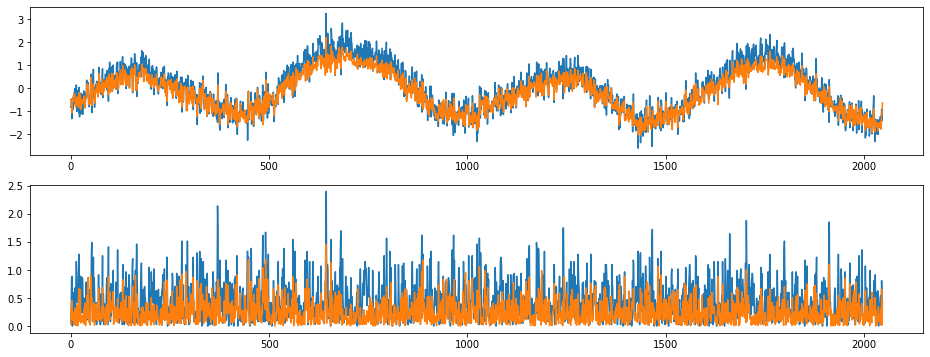

index:  316462
MAE:  0.24312145999380502
n_bunches       540
bunch_index     549
bunch_number    384
Name: 1829809, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6674/instability_data/06674_Inst_B1H_Q7_20180512_03h49m10s.h5


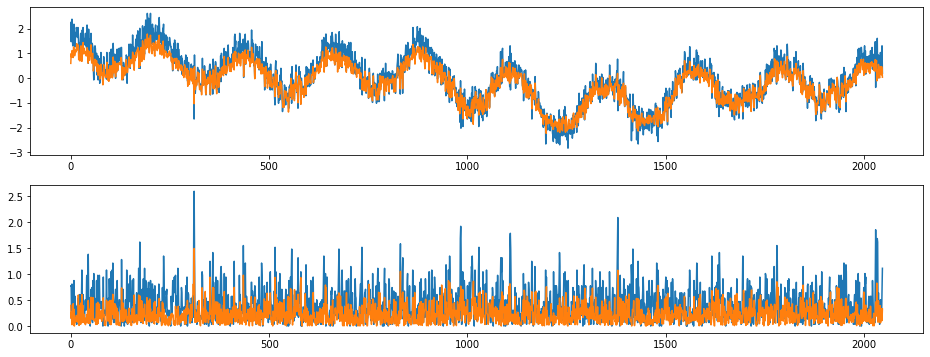

index:  39005
MAE:  0.24312280318073562
n_bunches       1868
bunch_index     1744
bunch_number     925
Name: 11384361, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6279/instability_data/06279_Inst_B1H_Q7_20171007_10h47m14s.h5


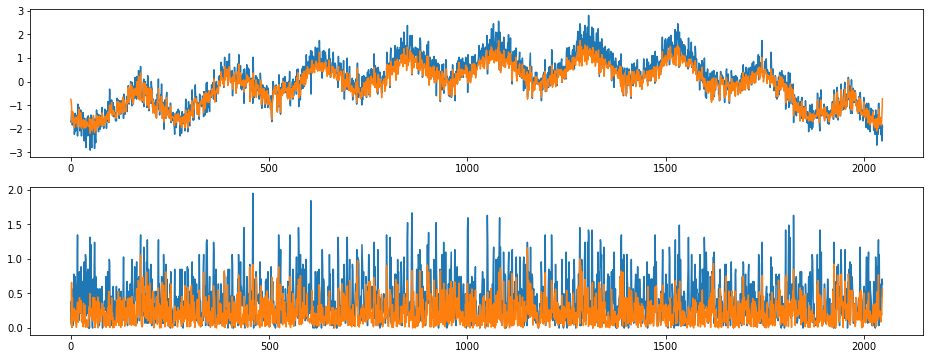

index:  249678
MAE:  0.24312293047521222
n_bunches       1164
bunch_index      514
bunch_number     204
Name: 11354638, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6890/instability_data/06890_Inst_B1H_Q7_20180705_12h47m53s.h5


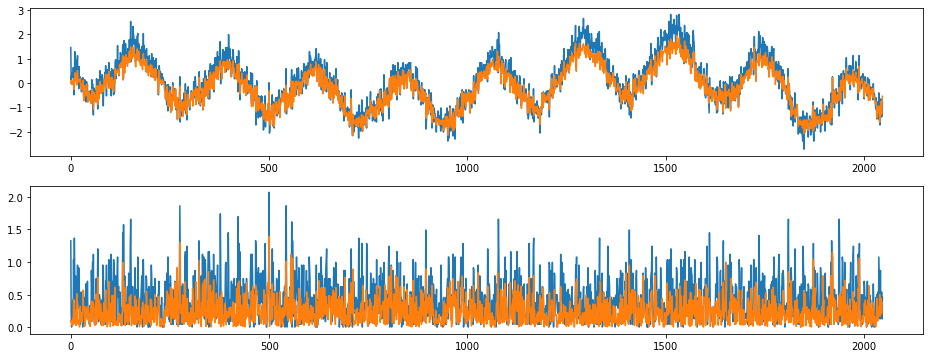

index:  64208
MAE:  0.243123019329891
n_bunches        987
bunch_index     1339
bunch_number     364
Name: 4770563, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6688/instability_data/06688_Inst_B1H_Q7_20180515_19h16m13s.h5


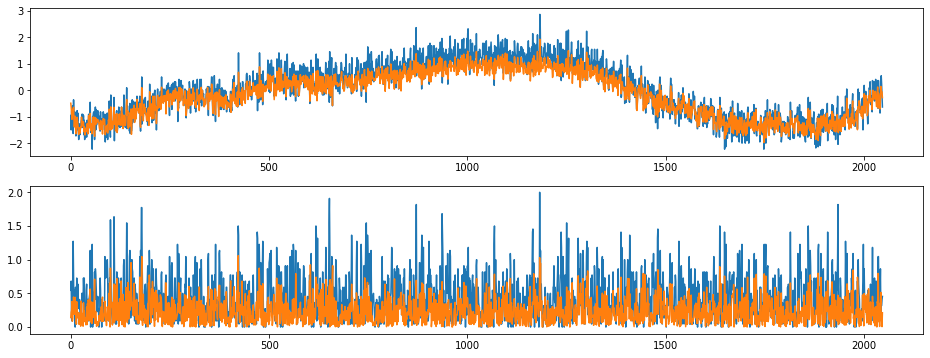

index:  364624
MAE:  0.24312107832076282
n_bunches       172
bunch_index     454
bunch_number     90
Name: 4513400, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6429/instability_data/06429_Inst_B1H_Q7_20171128_02h56m13s.h5


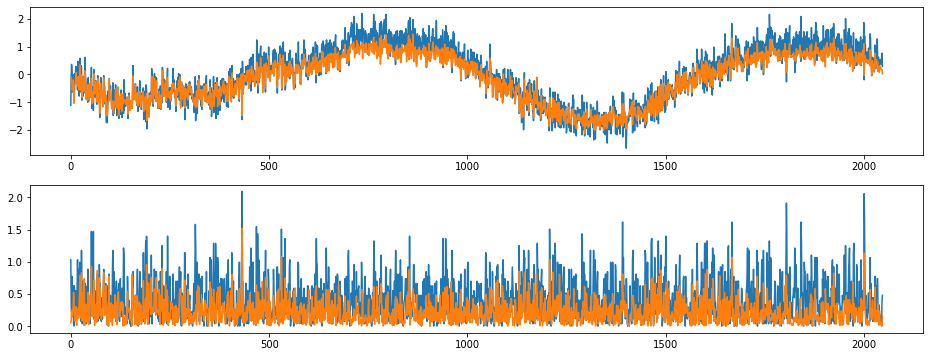

index:  162399
MAE:  0.2431208677893421
n_bunches       540
bunch_index     578
bunch_number    401
Name: 7923714, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7133/instability_data/07133_Inst_B1H_Q7_20180907_12h04m42s.h5


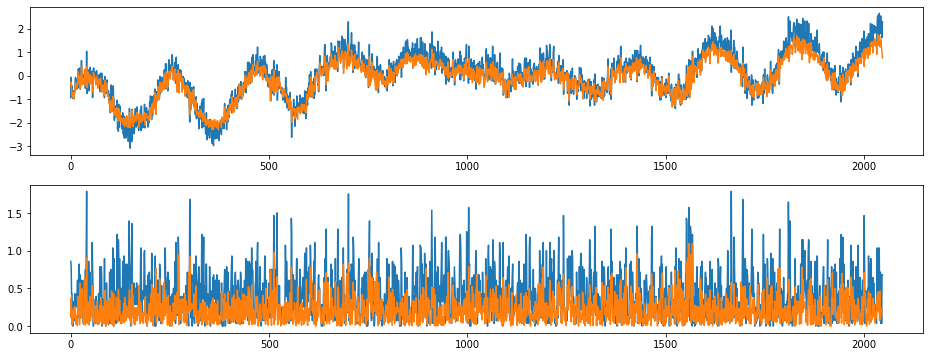

index:  365636
MAE:  0.24312086159007268
n_bunches         20
bunch_index     1797
bunch_number      11
Name: 10060191, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7429/instability_data/07429_Inst_B1H_Q7_20181109_14h40m14s.h5


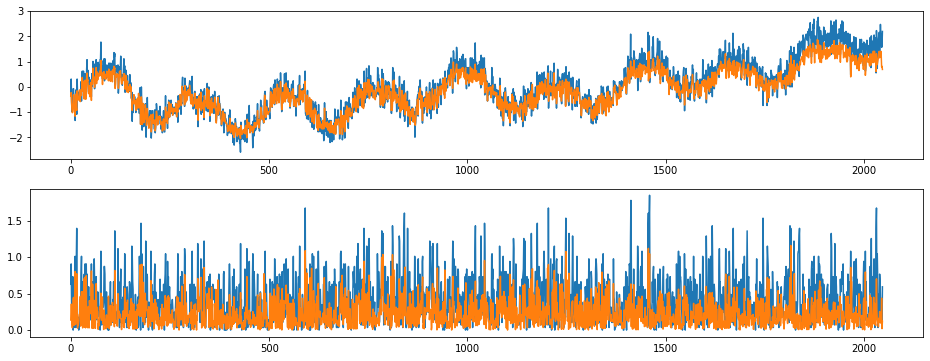

In [28]:
for i in range(10):
    around_peak_index = around_peak_indices[i]

    print('index: ', around_peak_index)
    print("MAE: ", MAE_train[around_peak_index])
    # I'm not sure this row is correct
    metadata_row = train_generator.metadata.iloc[around_peak_index // 32]
    print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
    print(metadata_row['file'])

    true_signal = train_dataset[around_peak_index].squeeze()
    pred_signal = train_pred[around_peak_index].squeeze()

    plot_true_pred(true_signal, pred_signal)
    plt.show()

# around a point

In [29]:
around_point_indices = np.argsort(np.abs(MAE_train - 0.27))

index:  383786
MAE:  0.26999996788123115
n_bunches       1412
bunch_index      562
bunch_number     297
Name: 4147743, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6186/instability_data/06186_Inst_B1H_Q7_20170910_08h18m08s.h5


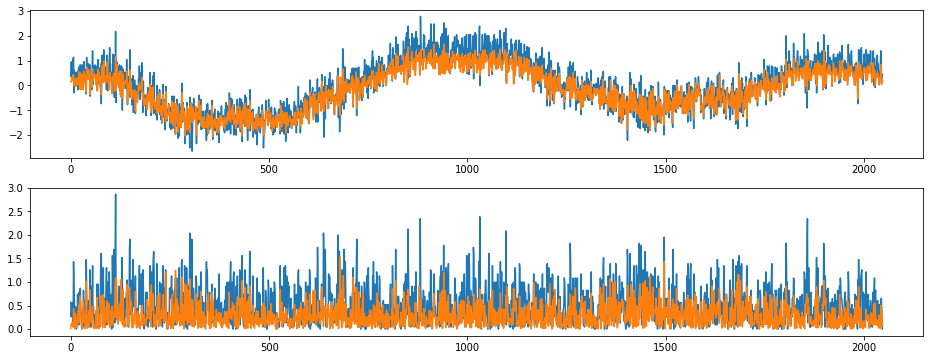

index:  166527
MAE:  0.26999988962657373
n_bunches        339
bunch_index     1893
bunch_number     201
Name: 5764778, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6595/instability_data/06595_Inst_B1H_Q7_20180423_03h06m14s.h5


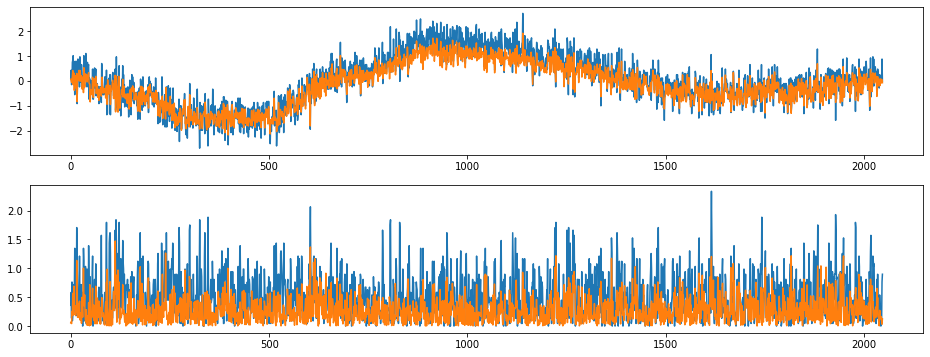

index:  3534
MAE:  0.27000058138296046
n_bunches       636
bunch_index      87
bunch_number     19
Name: 8421844, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6662/instability_data/06662_Inst_B1H_Q7_20180509_21h41m36s.h5


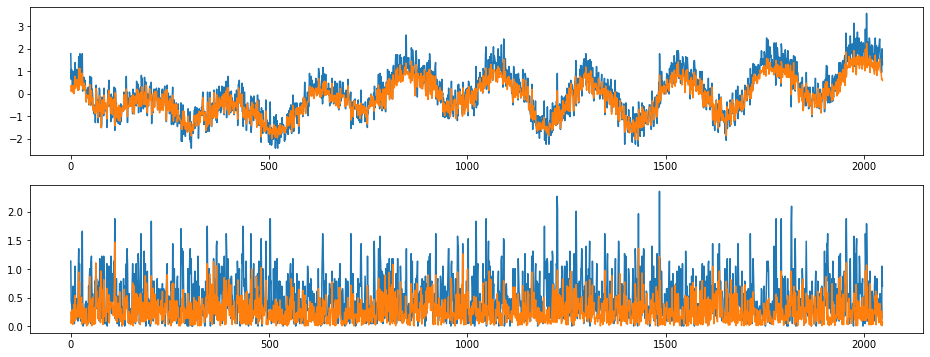

index:  171790
MAE:  0.2699992132546205
n_bunches       2556
bunch_index      612
bunch_number     416
Name: 11373901, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6700/instability_data/06700_Inst_B1H_Q7_20180519_15h11m14s.h5


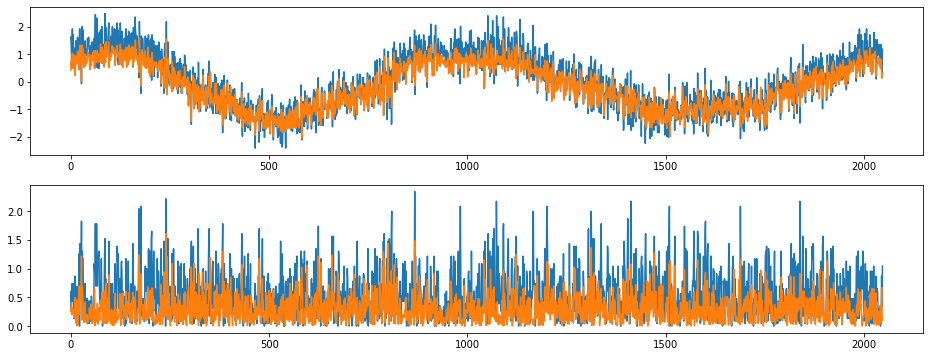

index:  232351
MAE:  0.27000107597224055
n_bunches       312
bunch_index     427
bunch_number     74
Name: 2049169, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7449/instability_data/07449_Inst_B1H_Q7_20181116_17h26m22s.h5


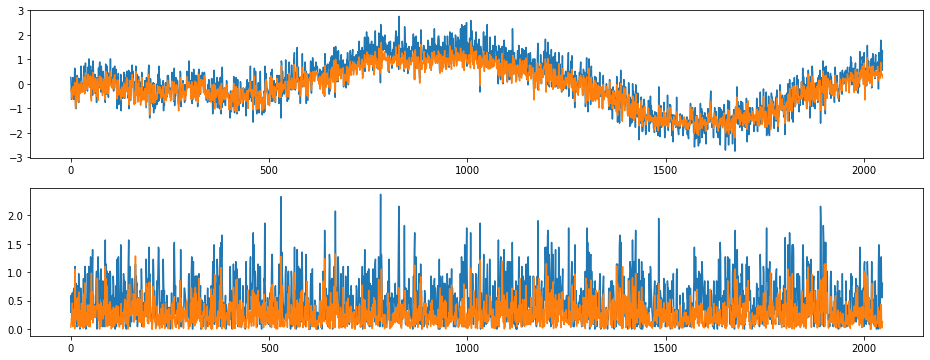

index:  100799
MAE:  0.27000112767840956
n_bunches       2556
bunch_index      435
bunch_number     284
Name: 6530589, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6654/instability_data/06654_Inst_B1H_Q7_20180508_04h34m14s.h5


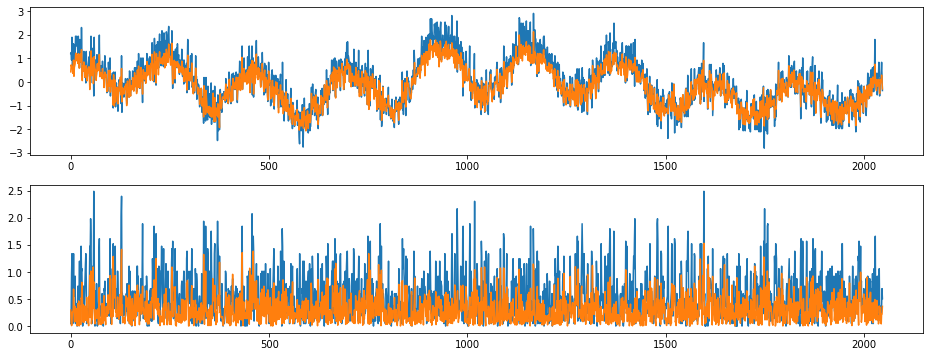

index:  209335
MAE:  0.2700011672393432
n_bunches       2556
bunch_index     1598
bunch_number    1166
Name: 1943197, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6711/instability_data/06711_Inst_B1H_Q7_20180522_15h10m14s.h5


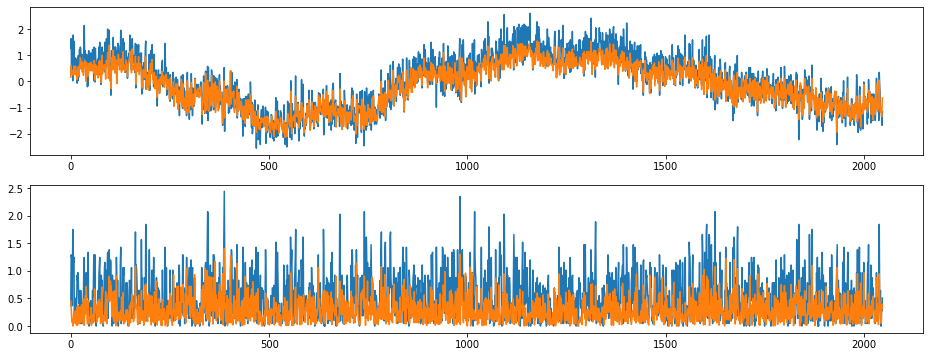

index:  6750
MAE:  0.26999868952509637
n_bunches        670
bunch_index     3173
bunch_number     608
Name: 5734905, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7466/instability_data/07466_Inst_B1H_Q7_20181123_02h36m15s.h5


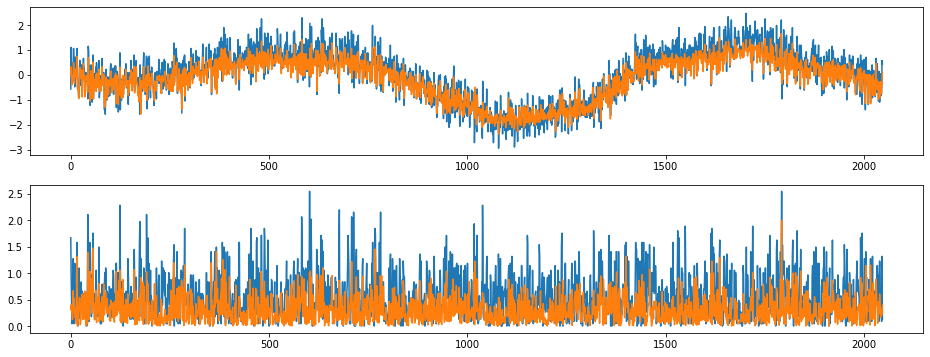

index:  78685
MAE:  0.2699986747284818
n_bunches       1868
bunch_index     2166
bunch_number    1162
Name: 6862072, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6344/instability_data/06344_Inst_B1H_Q7_20171029_01h23m13s.h5


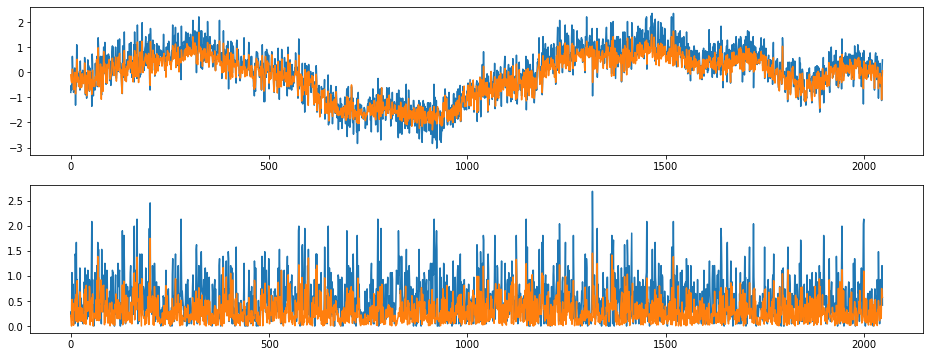

index:  5316
MAE:  0.27000134627610345
n_bunches       1260
bunch_index     2128
bunch_number    1136
Name: 1697557, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6275/instability_data/06275_Inst_B1H_Q7_20171005_19h49m13s.h5


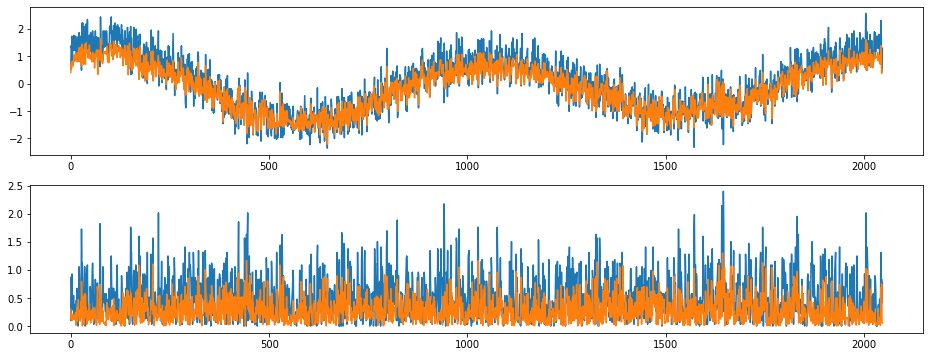

In [30]:
for i in range(10):
    around_point_index = around_point_indices[i]

    print('index: ', around_point_index)
    print("MAE: ", MAE_train[around_point_index])
    # I'm not sure this row is correct
    metadata_row = train_generator.metadata.iloc[around_point_index // 32]
    print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
    print(metadata_row['file'])

    true_signal = train_dataset[around_point_index].squeeze()
    pred_signal = train_pred[around_point_index].squeeze()

    plot_true_pred(true_signal, pred_signal)
    plt.show()